# Face Generation
In this project, you'll use generative adversarial networks to generate new images of faces.
### Get the Data
You'll be using two datasets in this project:
- MNIST
- CelebA

Since the celebA dataset is complex and you're doing GANs in a project for the first time, we want you to test your neural network on MNIST before CelebA.  Running the GANs on MNIST will allow you to see how well your model trains sooner.

If you're using [FloydHub](https://www.floydhub.com/), set `data_dir` to "/input" and use the [FloydHub data ID](http://docs.floydhub.com/home/using_datasets/) "R5KrjnANiKVhLWAkpXhNBe".

In [1]:
data_dir = './data'

# FloydHub - Use with data ID "R5KrjnANiKVhLWAkpXhNBe"
#data_dir = '/input'


"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import helper

helper.download_extract('mnist', data_dir)
helper.download_extract('celeba', data_dir)

Found mnist Data
Found celeba Data


## Explore the Data
### MNIST
As you're aware, the [MNIST](http://yann.lecun.com/exdb/mnist/) dataset contains images of handwritten digits. You can view the first number of examples by changing `show_n_images`. 

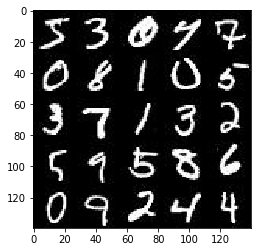

In [2]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
%matplotlib inline
import os
from glob import glob
from matplotlib import pyplot

mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'mnist/*.jpg'))[:show_n_images], 28, 28, 'L')
pyplot.imshow(helper.images_square_grid(mnist_images, 'L'), cmap='gray')

### CelebA
The [CelebFaces Attributes Dataset (CelebA)](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) dataset contains over 200,000 celebrity images with annotations.  Since you're going to be generating faces, you won't need the annotations.  You can view the first number of examples by changing `show_n_images`.

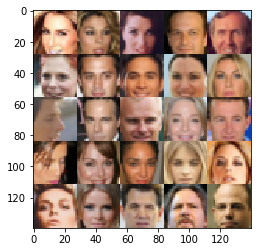

In [3]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'img_align_celeba/*.jpg'))[:show_n_images], 28, 28, 'RGB')
pyplot.imshow(helper.images_square_grid(mnist_images, 'RGB'))

## Preprocess the Data
Since the project's main focus is on building the GANs, we'll preprocess the data for you.  The values of the MNIST and CelebA dataset will be in the range of -0.5 to 0.5 of 28x28 dimensional images.  The CelebA images will be cropped to remove parts of the image that don't include a face, then resized down to 28x28.

The MNIST images are black and white images with a single [color channel](https://en.wikipedia.org/wiki/Channel_(digital_image%29) while the CelebA images have [3 color channels (RGB color channel)](https://en.wikipedia.org/wiki/Channel_(digital_image%29#RGB_Images).
## Build the Neural Network
You'll build the components necessary to build a GANs by implementing the following functions below:
- `model_inputs`
- `discriminator`
- `generator`
- `model_loss`
- `model_opt`
- `train`

### Check the Version of TensorFlow and Access to GPU
This will check to make sure you have the correct version of TensorFlow and access to a GPU

In [4]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
from distutils.version import LooseVersion
import warnings
import tensorflow as tf

# Check TensorFlow Version
assert LooseVersion(tf.__version__) >= LooseVersion('1.0'), 'Please use TensorFlow version 1.0 or newer.  You are using {}'.format(tf.__version__)
print('TensorFlow Version: {}'.format(tf.__version__))

# Check for a GPU
if not tf.test.gpu_device_name():
    warnings.warn('No GPU found. Please use a GPU to train your neural network.')
else:
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))

TensorFlow Version: 1.0.0


C:\Anaconda3\envs\ai\lib\site-packages\ipykernel_launcher.py:14: UserWarning: No GPU found. Please use a GPU to train your neural network.
  


### Input
Implement the `model_inputs` function to create TF Placeholders for the Neural Network. It should create the following placeholders:
- Real input images placeholder with rank 4 using `image_width`, `image_height`, and `image_channels`.
- Z input placeholder with rank 2 using `z_dim`.
- Learning rate placeholder with rank 0.

Return the placeholders in the following the tuple (tensor of real input images, tensor of z data)

In [5]:
import problem_unittests as tests

def model_inputs(image_width, image_height, image_channels, z_dim):
    """
    Create the model inputs
    :param image_width: The input image width
    :param image_height: The input image height
    :param image_channels: The number of image channels
    :param z_dim: The dimension of Z
    :return: Tuple of (tensor of real input images, tensor of z data, learning rate)
    """
    # TODO: Implement Function
    input_real = tf.placeholder(tf.float32, shape=[None, image_width, image_height, image_channels], name='input_real')
    input_z = tf.placeholder(tf.float32, shape=[None, z_dim], name='input_z')
    lr = tf.placeholder(tf.float32, name='learning_rate')
    return input_real, input_z, lr


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_inputs(model_inputs)

Tests Passed


### Discriminator
Implement `discriminator` to create a discriminator neural network that discriminates on `images`.  This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "discriminator" to allow the variables to be reused.  The function should return a tuple of (tensor output of the discriminator, tensor logits of the discriminator).

In [6]:
def leaky_relu(input):
    return tf.maximum(0.1 * input, input)

def discriminator(images, reuse=False):
    """
    Create the discriminator network
    :param images: Tensor of input image(s)
    :param reuse: Boolean if the weights should be reused
    :return: Tuple of (tensor output of the discriminator, tensor logits of the discriminator)
    """
    # TODO: Implement Function
    with tf.variable_scope('discriminator', reuse=reuse):        
        conv1 = tf.layers.conv2d(images, 56, 5, 2, 'same')
        conv1 = leaky_relu(conv1)
        
        conv2 = tf.layers.conv2d(conv1, 112, 5, 2, 'same')
        conv2 = tf.layers.batch_normalization(conv2, training=True)
        conv2 = leaky_relu(conv2)
        
        conv3 = tf.layers.conv2d(conv2, 224, 5, 2, 'same')
        conv3 = tf.layers.batch_normalization(conv3, training=True)
        conv3 = leaky_relu(conv3)
        
        flat = tf.reshape(conv3, (-1, 4*4*224))
        logits = tf.layers.dense(flat, 1)

        return tf.sigmoid(logits), logits


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_discriminator(discriminator, tf)

Tests Passed


### Generator
Implement `generator` to generate an image using `z`. This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "generator" to allow the variables to be reused. The function should return the generated 28 x 28 x `out_channel_dim` images.

In [7]:
def generator(z, out_channel_dim, is_train=True):
    """
    Create the generator network
    :param z: Input z
    :param out_channel_dim: The number of channels in the output image
    :param is_train: Boolean if generator is being used for training
    :return: The tensor output of the generator
    """
    # TODO: Implement Function
    with tf.variable_scope('generator', reuse=(not is_train)):        
        fc = tf.layers.dense(z, 7*7*112)
        fc = tf.reshape(fc, (-1, 7, 7, 112))
        fc = tf.layers.batch_normalization(fc, training=is_train)
        fc = leaky_relu(fc)
        
        conv1 = tf.layers.conv2d_transpose(fc, 56, 5, 2, 'same')
        conv1 = tf.layers.batch_normalization(conv1, training=is_train)
        conv1 = leaky_relu(conv1)
        
        conv2 = tf.layers.conv2d_transpose(conv1, out_channel_dim, 5, 2, 'same')
        
        return tf.tanh(conv2)

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_generator(generator, tf)

Tests Passed


### Loss
Implement `model_loss` to build the GANs for training and calculate the loss.  The function should return a tuple of (discriminator loss, generator loss).  Use the following functions you implemented:
- `discriminator(images, reuse=False)`
- `generator(z, out_channel_dim, is_train=True)`

In [8]:
def model_loss(input_real, input_z, out_channel_dim):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    # TODO: Implement Function
    
    g_model = generator(input_z, out_channel_dim)
    d_model_real, d_logits_real = discriminator(input_real)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_loss(model_loss)

Tests Passed


### Optimization
Implement `model_opt` to create the optimization operations for the GANs. Use [`tf.trainable_variables`](https://www.tensorflow.org/api_docs/python/tf/trainable_variables) to get all the trainable variables.  Filter the variables with names that are in the discriminator and generator scope names.  The function should return a tuple of (discriminator training operation, generator training operation).

In [9]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # TODO: Implement Function
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_opt(model_opt, tf)

Tests Passed


## Neural Network Training
### Show Output
Use this function to show the current output of the generator during training. It will help you determine how well the GANs is training.

In [10]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import numpy as np

def show_generator_output(sess, n_images, input_z, out_channel_dim, image_mode):
    """
    Show example output for the generator
    :param sess: TensorFlow session
    :param n_images: Number of Images to display
    :param input_z: Input Z Tensor
    :param out_channel_dim: The number of channels in the output image
    :param image_mode: The mode to use for images ("RGB" or "L")
    """
    cmap = None if image_mode == 'RGB' else 'gray'
    z_dim = input_z.get_shape().as_list()[-1]
    example_z = np.random.uniform(-1, 1, size=[n_images, z_dim])

    samples = sess.run(
        generator(input_z, out_channel_dim, False),
        feed_dict={input_z: example_z})

    images_grid = helper.images_square_grid(samples, image_mode)
    pyplot.imshow(images_grid, cmap=cmap)
    pyplot.show()

### Train
Implement `train` to build and train the GANs.  Use the following functions you implemented:
- `model_inputs(image_width, image_height, image_channels, z_dim)`
- `model_loss(input_real, input_z, out_channel_dim)`
- `model_opt(d_loss, g_loss, learning_rate, beta1)`

Use the `show_generator_output` to show `generator` output while you train. Running `show_generator_output` for every batch will drastically increase training time and increase the size of the notebook.  It's recommended to print the `generator` output every 100 batches.

In [13]:
def train(epoch_count, batch_size, z_dim, learning_rate, beta1, get_batches, data_shape, data_image_mode):
    """
    Train the GAN
    :param epoch_count: Number of epochs
    :param batch_size: Batch Size
    :param z_dim: Z dimension
    :param learning_rate: Learning Rate
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :param get_batches: Function to get batches
    :param data_shape: Shape of the data
    :param data_image_mode: The image mode to use for images ("RGB" or "L")
    """
    # TODO: Build Model
    steps = 0
    print_every = 250
    show_every = 250
    
    input_real, input_z, lr = model_inputs(data_shape[1], data_shape[2], data_shape[3], z_dim)
    d_loss, g_loss = model_loss(input_real, input_z, data_shape[3])
    d_opt, g_opt = model_opt(d_loss, g_loss, lr, beta1)
    
    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for epoch_i in range(epoch_count):
            for batch_images in get_batches(batch_size):
                # TODO: Train Model
                steps += 1
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_dim))
                _ = sess.run(d_opt, feed_dict={input_real: batch_images, input_z: batch_z, lr: learning_rate})
                _ = sess.run(g_opt, feed_dict={input_real: batch_images, input_z: batch_z, lr: learning_rate})

                if steps % print_every == 0:
                    train_loss_d = d_loss.eval(feed_dict={input_z: batch_z, input_real: batch_images})
                    train_loss_g = g_loss.eval(feed_dict={input_z: batch_z})
                    print("Epoch {}/{}...".format(epoch_i+1, epoch_count),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))

                if steps % show_every == 0:
                    show_generator_output(sess, 16, input_z, data_shape[3], data_image_mode)
                    
        show_generator_output(sess, 16, input_z, data_shape[3], data_image_mode)
    

### MNIST
Test your GANs architecture on MNIST.  After 2 epochs, the GANs should be able to generate images that look like handwritten digits.  Make sure the loss of the generator is lower than the loss of the discriminator or close to 0.

Results for parameters:  64 100 0.0001 0.5
Epoch 1/2... Discriminator Loss: 0.1167... Generator Loss: 3.5410


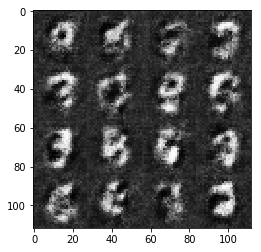

Epoch 1/2... Discriminator Loss: 0.0539... Generator Loss: 3.7053


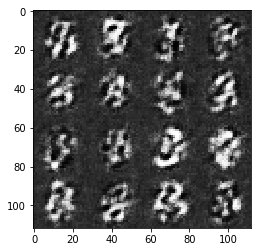

Epoch 1/2... Discriminator Loss: 0.0702... Generator Loss: 3.4105


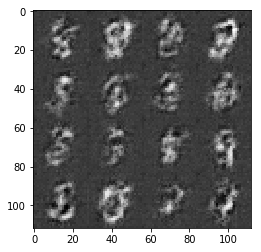

Epoch 2/2... Discriminator Loss: 0.0391... Generator Loss: 4.2502


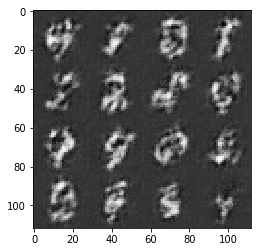

Epoch 2/2... Discriminator Loss: 0.0303... Generator Loss: 4.5220


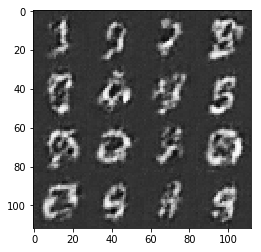

Epoch 2/2... Discriminator Loss: 0.0095... Generator Loss: 5.6603


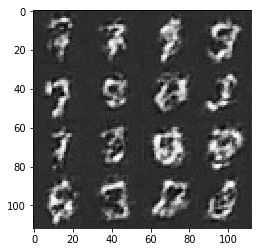

Epoch 2/2... Discriminator Loss: 0.0210... Generator Loss: 4.9303


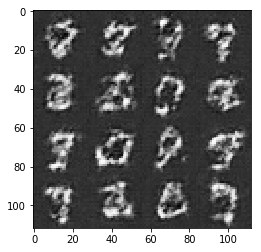

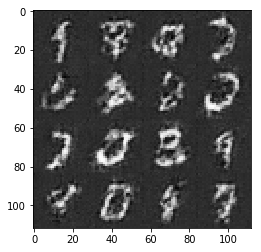

Set finished
Results for parameters:  64 100 0.0001 0.9
Epoch 1/2... Discriminator Loss: 0.0215... Generator Loss: 6.8728


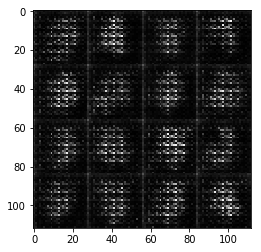

Epoch 1/2... Discriminator Loss: 0.0118... Generator Loss: 6.5747


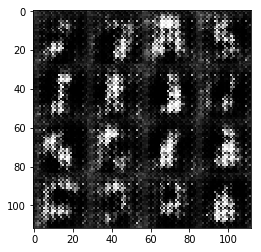

Epoch 1/2... Discriminator Loss: 0.0089... Generator Loss: 5.5403


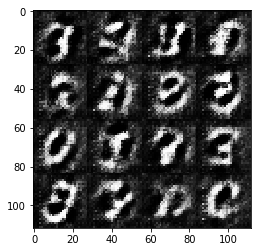

Epoch 2/2... Discriminator Loss: 0.0730... Generator Loss: 4.2927


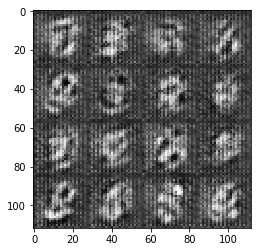

Epoch 2/2... Discriminator Loss: 0.0427... Generator Loss: 4.2750


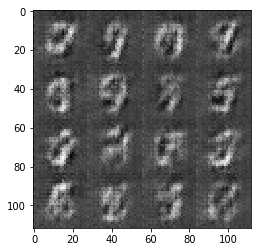

Epoch 2/2... Discriminator Loss: 0.0082... Generator Loss: 5.8038


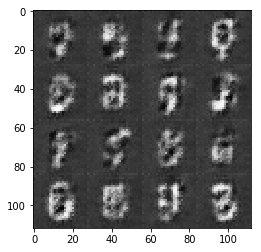

Epoch 2/2... Discriminator Loss: 0.0146... Generator Loss: 6.1928


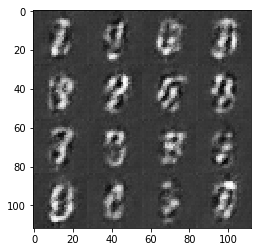

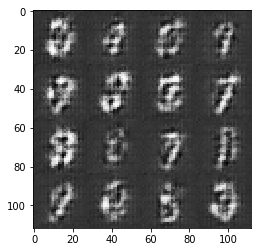

Set finished
Results for parameters:  64 100 3e-05 0.5
Epoch 1/2... Discriminator Loss: 0.0599... Generator Loss: 3.5886


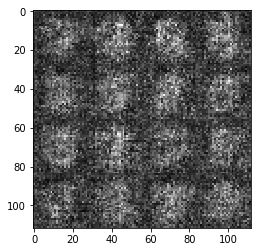

Epoch 1/2... Discriminator Loss: 0.0603... Generator Loss: 4.2096


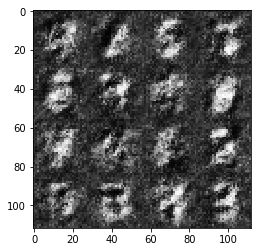

Epoch 1/2... Discriminator Loss: 0.0332... Generator Loss: 4.6624


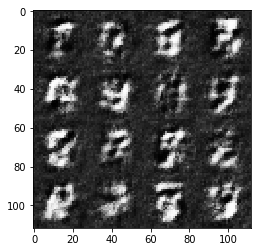

Epoch 2/2... Discriminator Loss: 0.0385... Generator Loss: 4.3384


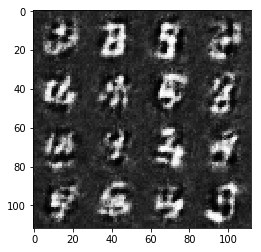

Epoch 2/2... Discriminator Loss: 0.0269... Generator Loss: 4.6711


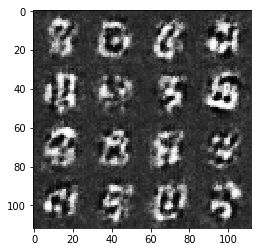

Epoch 2/2... Discriminator Loss: 0.0519... Generator Loss: 4.1694


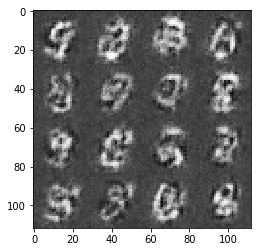

Epoch 2/2... Discriminator Loss: 0.0401... Generator Loss: 4.1617


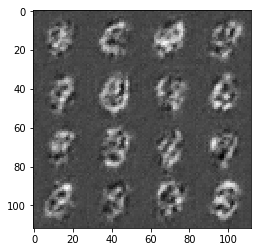

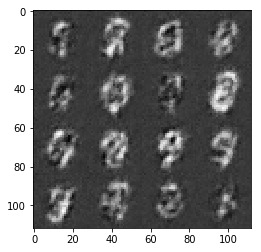

Set finished
Results for parameters:  64 100 3e-05 0.9
Epoch 1/2... Discriminator Loss: 0.0885... Generator Loss: 4.7795


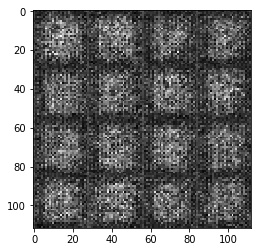

Epoch 1/2... Discriminator Loss: 0.0261... Generator Loss: 5.1999


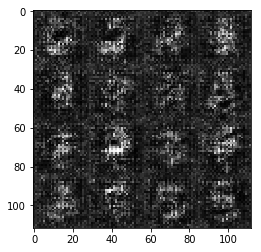

Epoch 1/2... Discriminator Loss: 0.0228... Generator Loss: 5.1801


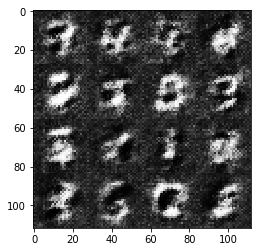

Epoch 2/2... Discriminator Loss: 0.0251... Generator Loss: 6.7696


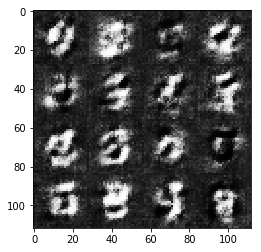

Epoch 2/2... Discriminator Loss: 0.0168... Generator Loss: 4.9201


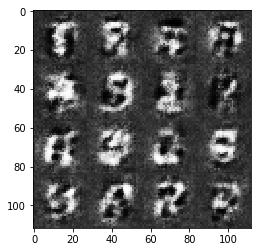

Epoch 2/2... Discriminator Loss: 0.0301... Generator Loss: 4.6230


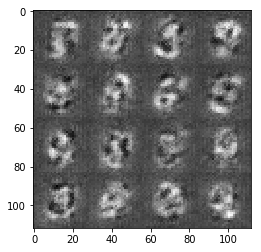

Epoch 2/2... Discriminator Loss: 0.0166... Generator Loss: 6.0489


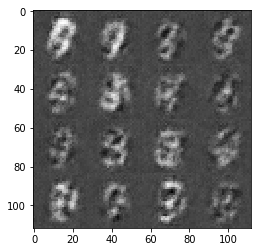

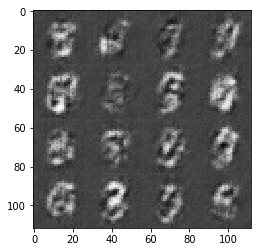

Set finished
Results for parameters:  64 150 0.0001 0.5
Epoch 1/2... Discriminator Loss: 0.0757... Generator Loss: 4.3507


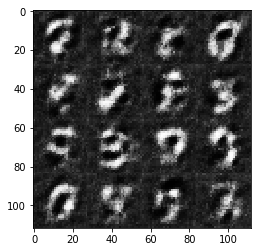

Epoch 1/2... Discriminator Loss: 0.0255... Generator Loss: 5.3225


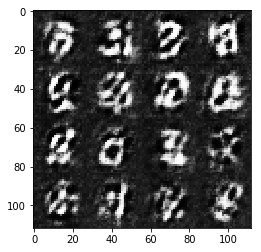

Epoch 1/2... Discriminator Loss: 0.0945... Generator Loss: 3.2713


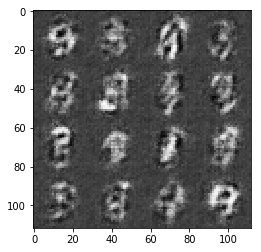

Epoch 2/2... Discriminator Loss: 0.0520... Generator Loss: 4.1687


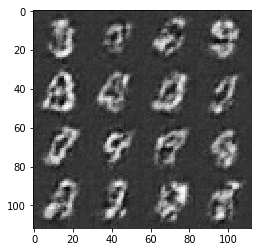

Epoch 2/2... Discriminator Loss: 0.0394... Generator Loss: 4.1335


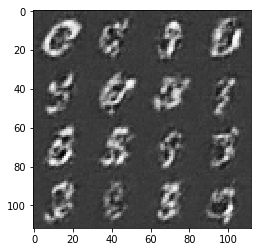

Epoch 2/2... Discriminator Loss: 0.0165... Generator Loss: 4.9401


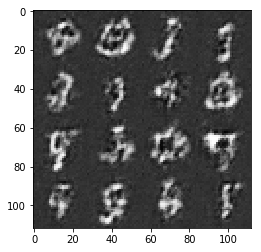

Epoch 2/2... Discriminator Loss: 0.0229... Generator Loss: 4.6749


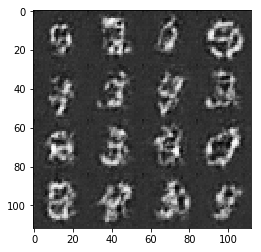

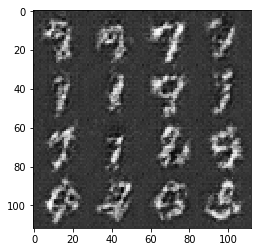

Set finished
Results for parameters:  64 150 0.0001 0.9
Epoch 1/2... Discriminator Loss: 0.0031... Generator Loss: 7.8423


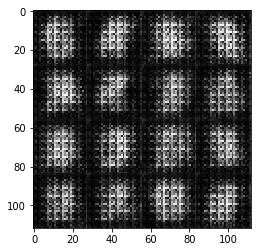

Epoch 1/2... Discriminator Loss: 0.0120... Generator Loss: 6.6625


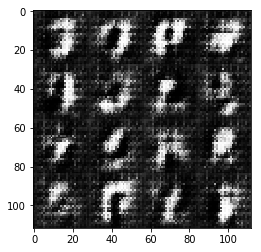

Epoch 1/2... Discriminator Loss: 0.0066... Generator Loss: 5.9889


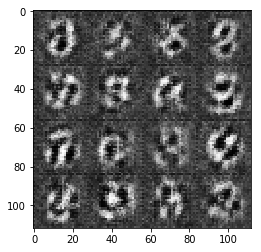

Epoch 2/2... Discriminator Loss: 0.0425... Generator Loss: 9.4339


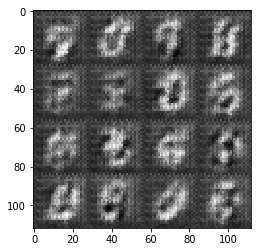

Epoch 2/2... Discriminator Loss: 0.0066... Generator Loss: 6.2114


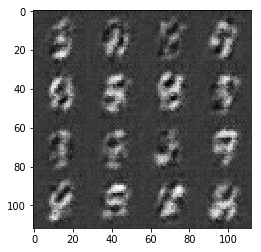

Epoch 2/2... Discriminator Loss: 0.0075... Generator Loss: 5.9373


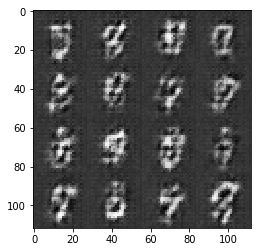

Epoch 2/2... Discriminator Loss: 0.0034... Generator Loss: 8.7892


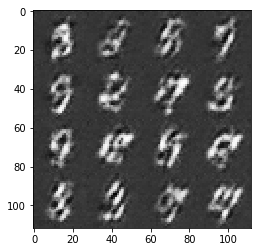

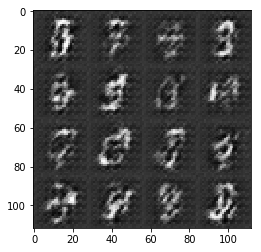

Set finished
Results for parameters:  64 150 3e-05 0.5
Epoch 1/2... Discriminator Loss: 0.0538... Generator Loss: 3.8158


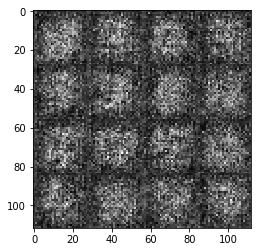

Epoch 1/2... Discriminator Loss: 0.0454... Generator Loss: 4.3883


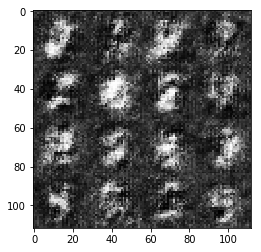

Epoch 1/2... Discriminator Loss: 0.0319... Generator Loss: 5.1411


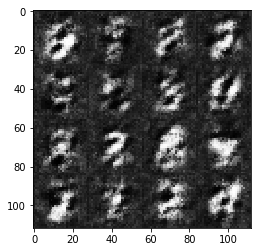

Epoch 2/2... Discriminator Loss: 0.0285... Generator Loss: 4.5881


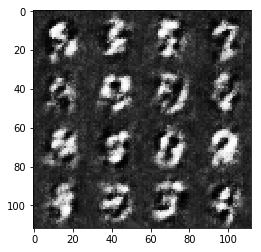

Epoch 2/2... Discriminator Loss: 0.0142... Generator Loss: 5.3294


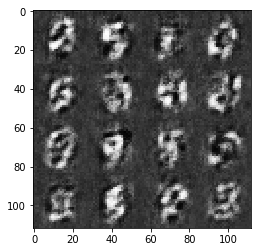

Epoch 2/2... Discriminator Loss: 0.0963... Generator Loss: 3.5499


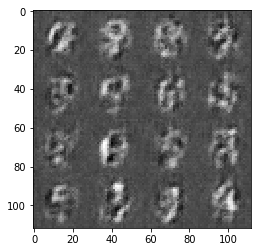

Epoch 2/2... Discriminator Loss: 0.0277... Generator Loss: 4.4732


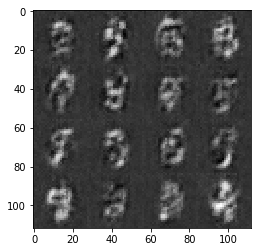

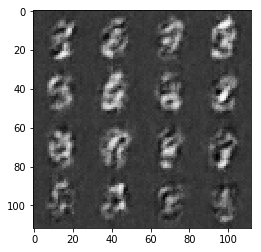

Set finished
Results for parameters:  64 150 3e-05 0.9
Epoch 1/2... Discriminator Loss: 0.0559... Generator Loss: 4.4395


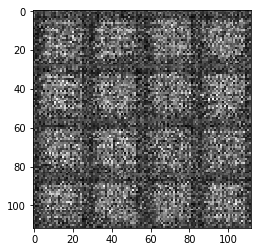

Epoch 1/2... Discriminator Loss: 0.0203... Generator Loss: 5.4692


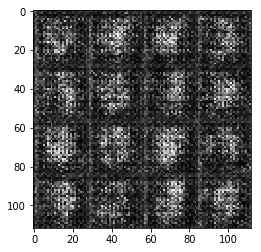

Epoch 1/2... Discriminator Loss: 0.0204... Generator Loss: 6.0039


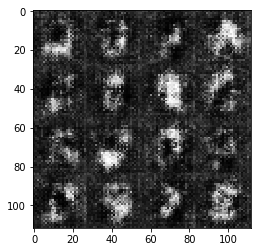

Epoch 2/2... Discriminator Loss: 0.0317... Generator Loss: 5.9099


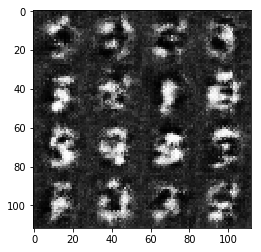

Epoch 2/2... Discriminator Loss: 0.0122... Generator Loss: 5.4111


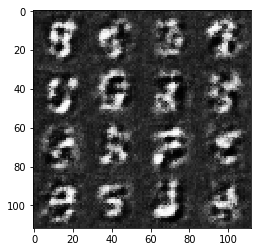

Epoch 2/2... Discriminator Loss: 0.0132... Generator Loss: 5.8533


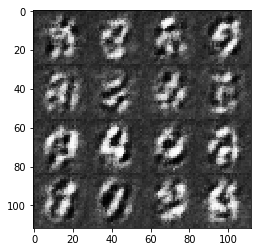

In [ ]:
batch_sizes = [64,128]
z_dims = [100,150,200]
learning_rates = [0.0001, 0.00003]
beta1s = [0.5,0.9]

#batch_size = 64
#z_dim = 100
#learning_rate = 0.001
#beta1 = 0.3
epochs = 2

for batch_size in batch_sizes:
    for z_dim in z_dims:
        for learning_rate in learning_rates:
            for beta1 in beta1s:
                print("Results for parameters: ", batch_size, z_dim, learning_rate, beta1)
                mnist_dataset = helper.Dataset('mnist', glob(os.path.join(data_dir, 'mnist/*.jpg')))
                with tf.Graph().as_default():
                    train(epochs, batch_size, z_dim, learning_rate, beta1, mnist_dataset.get_batches,
                          mnist_dataset.shape, mnist_dataset.image_mode)
                print("Set finished")

### CelebA
Run your GANs on CelebA.  It will take around 20 minutes on the average GPU to run one epoch.  You can run the whole epoch or stop when it starts to generate realistic faces.

Epoch 1/2... Discriminator Loss: 4.0395... Generator Loss: 0.1118


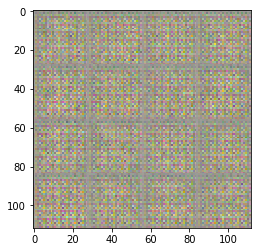

Epoch 1/2... Discriminator Loss: 0.2537... Generator Loss: 3.0063


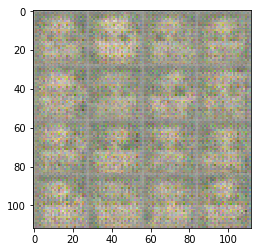

Epoch 1/2... Discriminator Loss: 0.9604... Generator Loss: 3.2365


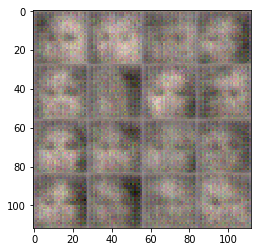

Epoch 1/2... Discriminator Loss: 1.7782... Generator Loss: 0.2290


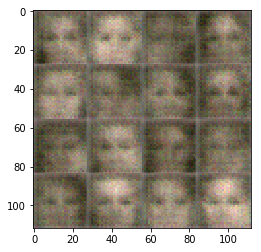

Epoch 1/2... Discriminator Loss: 0.4583... Generator Loss: 1.5730


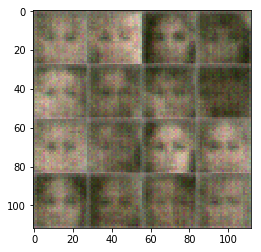

Epoch 1/2... Discriminator Loss: 0.6792... Generator Loss: 3.1756


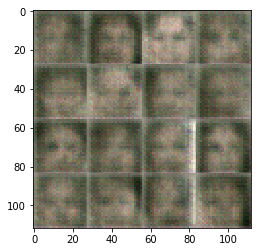

Epoch 1/2... Discriminator Loss: 0.3157... Generator Loss: 1.8069


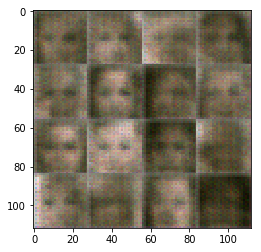

Epoch 1/2... Discriminator Loss: 0.2398... Generator Loss: 2.0754


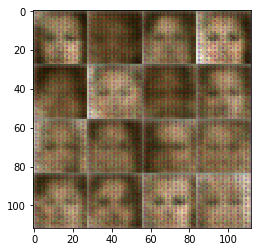

Epoch 1/2... Discriminator Loss: 0.0940... Generator Loss: 3.5597


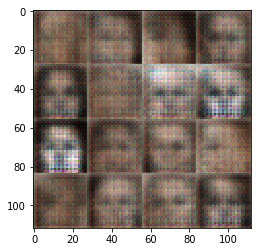

Epoch 1/2... Discriminator Loss: 3.4955... Generator Loss: 0.0395


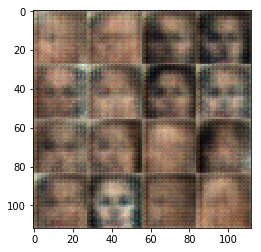

Epoch 1/2... Discriminator Loss: 1.8572... Generator Loss: 3.7648


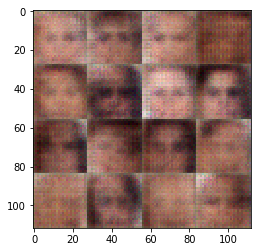

Epoch 1/2... Discriminator Loss: 0.1462... Generator Loss: 2.1617


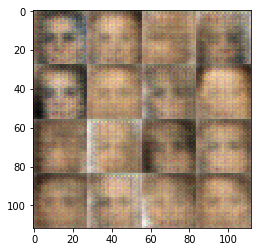

Epoch 1/2... Discriminator Loss: 7.0654... Generator Loss: 5.9396


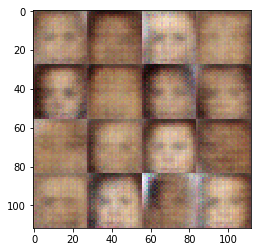

Epoch 1/2... Discriminator Loss: 1.1064... Generator Loss: 0.5531


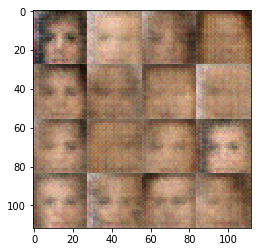

Epoch 1/2... Discriminator Loss: 0.0984... Generator Loss: 5.1921


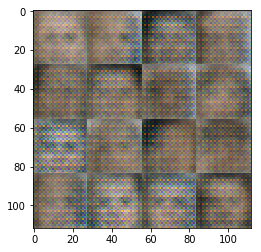

Epoch 1/2... Discriminator Loss: 0.2176... Generator Loss: 1.8873


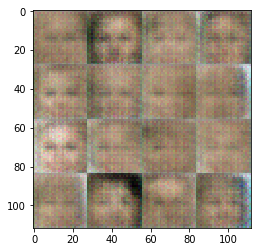

Epoch 1/2... Discriminator Loss: 0.0236... Generator Loss: 4.0730


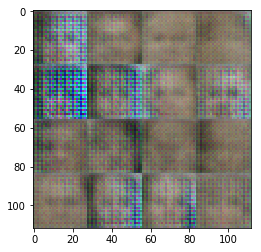

Epoch 1/2... Discriminator Loss: 0.6399... Generator Loss: 0.9115


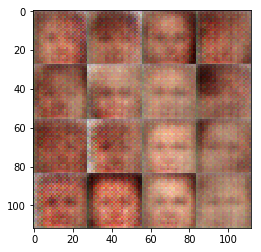

Epoch 1/2... Discriminator Loss: 1.1822... Generator Loss: 0.7563


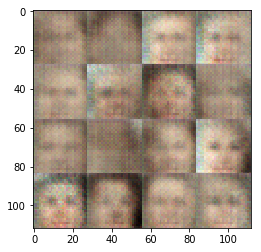

Epoch 1/2... Discriminator Loss: 1.4598... Generator Loss: 2.3537


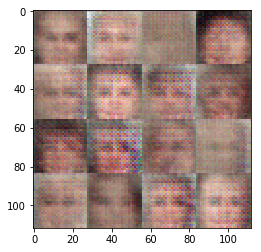

Epoch 1/2... Discriminator Loss: 0.0472... Generator Loss: 3.7271


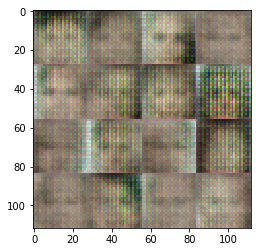

Epoch 1/2... Discriminator Loss: 0.1141... Generator Loss: 2.6775


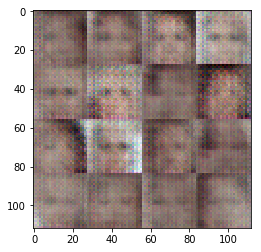

Epoch 1/2... Discriminator Loss: 0.0758... Generator Loss: 5.5227


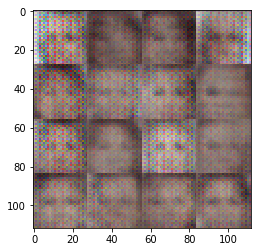

Epoch 1/2... Discriminator Loss: 0.0211... Generator Loss: 6.2572


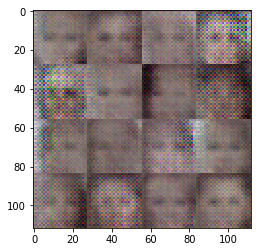

Epoch 1/2... Discriminator Loss: 2.1500... Generator Loss: 0.1998


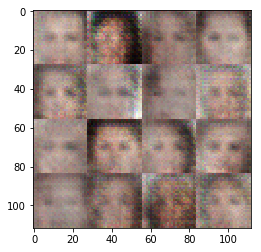

Epoch 1/2... Discriminator Loss: 0.0802... Generator Loss: 2.8228


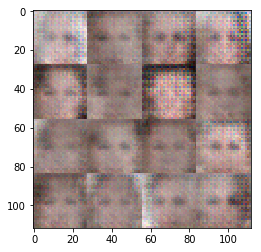

Epoch 1/2... Discriminator Loss: 1.1762... Generator Loss: 0.7584


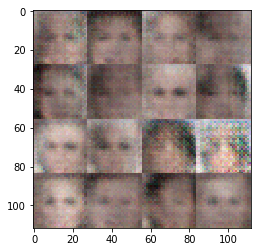

Epoch 1/2... Discriminator Loss: 0.9287... Generator Loss: 1.9647


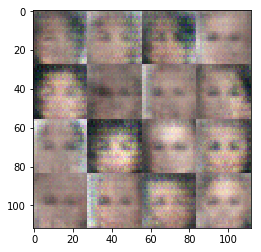

Epoch 1/2... Discriminator Loss: 0.0622... Generator Loss: 3.5633


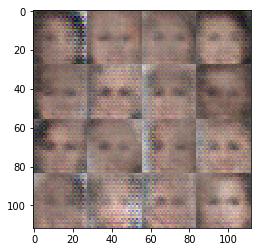

Epoch 1/2... Discriminator Loss: 0.0133... Generator Loss: 5.4210


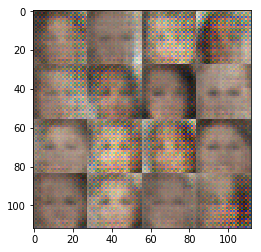

Epoch 1/2... Discriminator Loss: 1.3805... Generator Loss: 3.5596


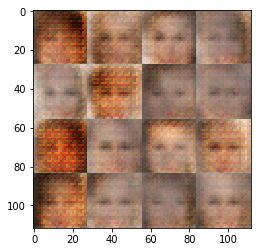

Epoch 1/2... Discriminator Loss: 0.0683... Generator Loss: 3.0880


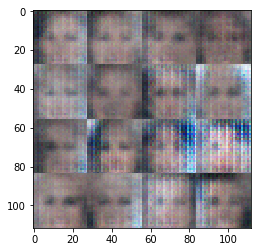

Epoch 1/2... Discriminator Loss: 2.1300... Generator Loss: 1.8281


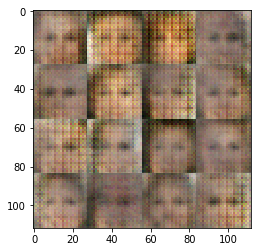

Epoch 1/2... Discriminator Loss: 1.4478... Generator Loss: 0.5825


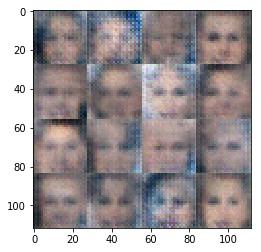

Epoch 1/2... Discriminator Loss: 1.2710... Generator Loss: 0.8652


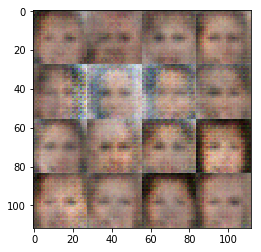

Epoch 1/2... Discriminator Loss: 1.2374... Generator Loss: 0.8962


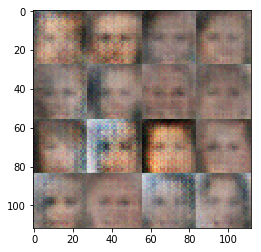

Epoch 1/2... Discriminator Loss: 1.4185... Generator Loss: 0.4993


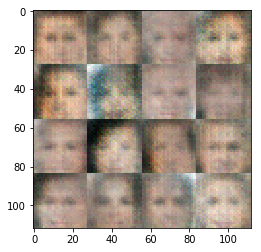

Epoch 1/2... Discriminator Loss: 1.4878... Generator Loss: 1.1286


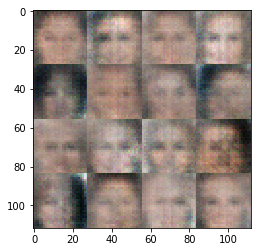

Epoch 1/2... Discriminator Loss: 1.3441... Generator Loss: 1.1205


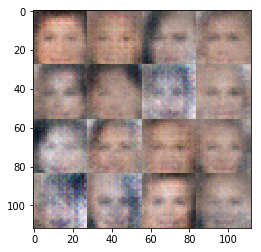

Epoch 1/2... Discriminator Loss: 1.2683... Generator Loss: 0.8186


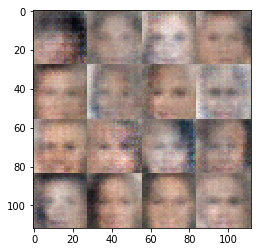

Epoch 1/2... Discriminator Loss: 1.3130... Generator Loss: 0.5144


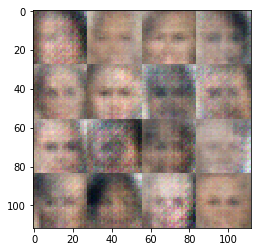

Epoch 1/2... Discriminator Loss: 1.2492... Generator Loss: 0.5614


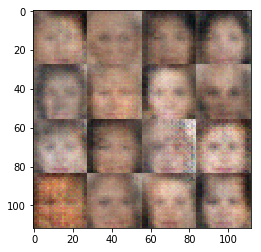

Epoch 1/2... Discriminator Loss: 1.1397... Generator Loss: 0.7061


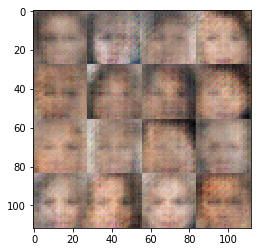

Epoch 1/2... Discriminator Loss: 1.4113... Generator Loss: 0.3871


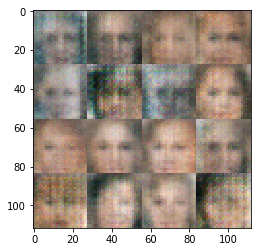

Epoch 1/2... Discriminator Loss: 1.8135... Generator Loss: 0.2197


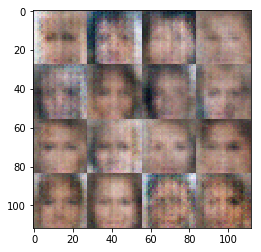

Epoch 1/2... Discriminator Loss: 1.3864... Generator Loss: 0.9461


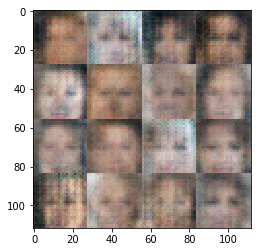

Epoch 1/2... Discriminator Loss: 1.1980... Generator Loss: 1.1299


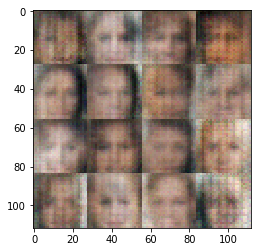

Epoch 1/2... Discriminator Loss: 0.5981... Generator Loss: 1.6948


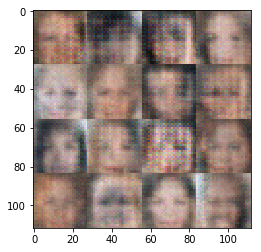

Epoch 1/2... Discriminator Loss: 0.2407... Generator Loss: 1.8123


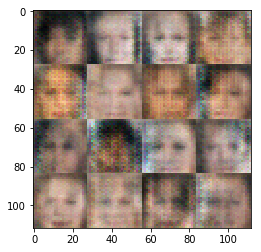

Epoch 1/2... Discriminator Loss: 0.7808... Generator Loss: 0.6971


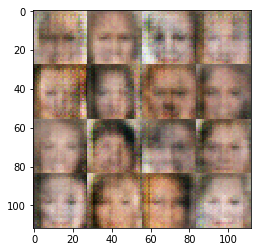

Epoch 1/2... Discriminator Loss: 1.1199... Generator Loss: 1.8925


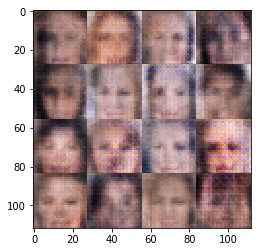

Epoch 1/2... Discriminator Loss: 0.6560... Generator Loss: 0.8057


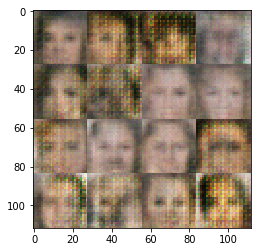

Epoch 1/2... Discriminator Loss: 0.0319... Generator Loss: 3.7256


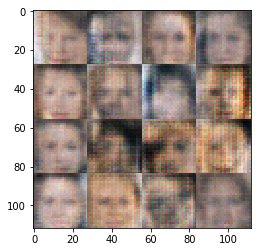

Epoch 1/2... Discriminator Loss: 1.3298... Generator Loss: 0.8281


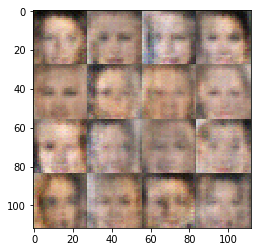

Epoch 1/2... Discriminator Loss: 1.2963... Generator Loss: 0.7162


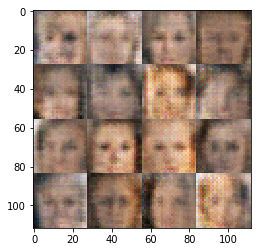

Epoch 1/2... Discriminator Loss: 1.3174... Generator Loss: 0.6578


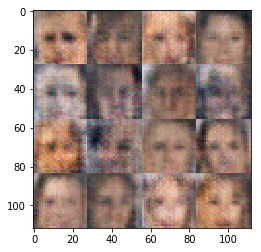

Epoch 1/2... Discriminator Loss: 1.4205... Generator Loss: 0.6482


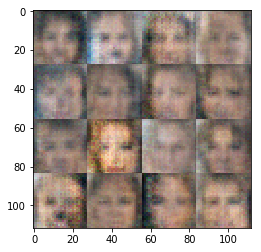

Epoch 1/2... Discriminator Loss: 1.2931... Generator Loss: 0.7007


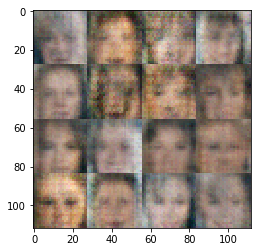

Epoch 1/2... Discriminator Loss: 1.3196... Generator Loss: 0.6548


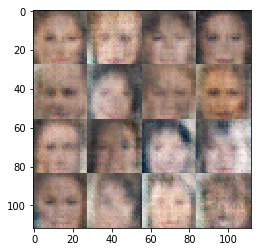

Epoch 1/2... Discriminator Loss: 1.1690... Generator Loss: 0.6107


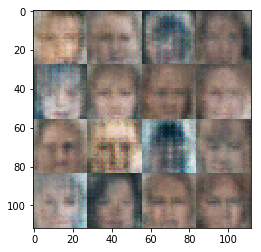

Epoch 1/2... Discriminator Loss: 1.0166... Generator Loss: 3.5171


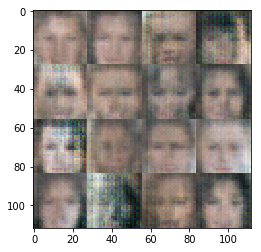

Epoch 1/2... Discriminator Loss: 0.6641... Generator Loss: 0.7744


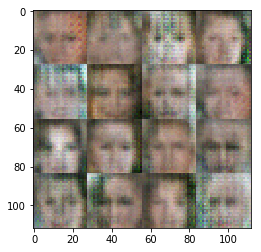

Epoch 1/2... Discriminator Loss: 0.1123... Generator Loss: 2.4859


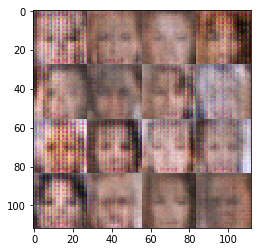

Epoch 1/2... Discriminator Loss: 0.8038... Generator Loss: 0.9709


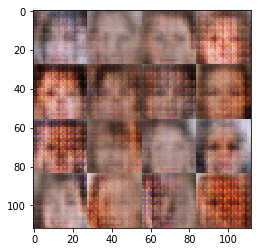

Epoch 1/2... Discriminator Loss: 1.4692... Generator Loss: 1.7069


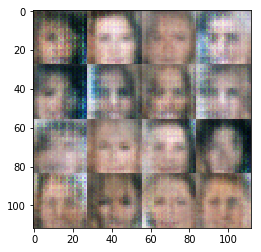

Epoch 1/2... Discriminator Loss: 0.1676... Generator Loss: 2.1638


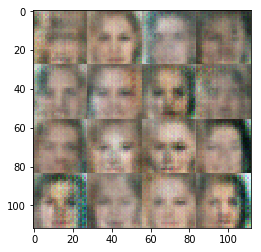

Epoch 1/2... Discriminator Loss: 0.0348... Generator Loss: 4.1543


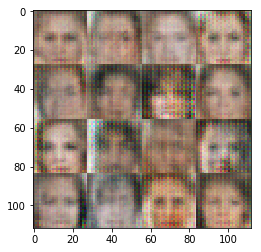

Epoch 1/2... Discriminator Loss: 1.6853... Generator Loss: 5.3122


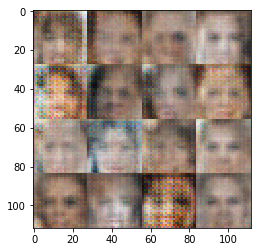

Epoch 1/2... Discriminator Loss: 2.2797... Generator Loss: 2.8523


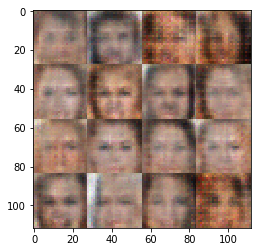

Epoch 1/2... Discriminator Loss: 0.2359... Generator Loss: 1.7290


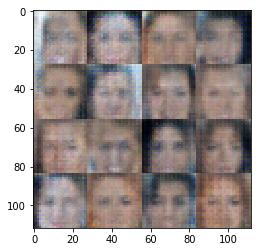

Epoch 1/2... Discriminator Loss: 0.3837... Generator Loss: 1.2864


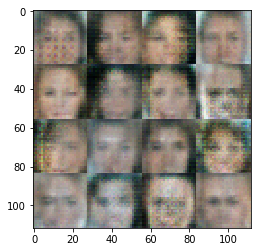

Epoch 1/2... Discriminator Loss: 1.9056... Generator Loss: 1.4942


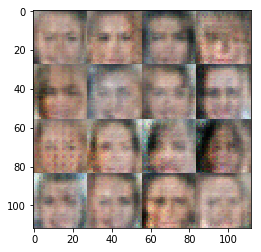

Epoch 1/2... Discriminator Loss: 1.3000... Generator Loss: 0.6260


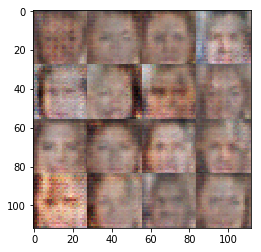

Epoch 1/2... Discriminator Loss: 1.3619... Generator Loss: 0.7189


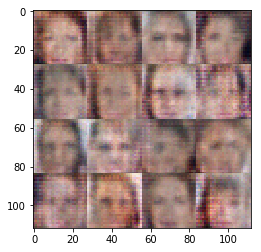

Epoch 1/2... Discriminator Loss: 1.4920... Generator Loss: 0.4345


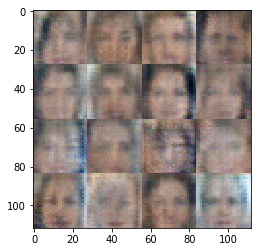

Epoch 1/2... Discriminator Loss: 1.2748... Generator Loss: 0.7883


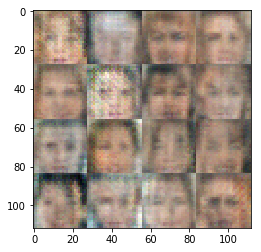

Epoch 1/2... Discriminator Loss: 1.5359... Generator Loss: 1.2054


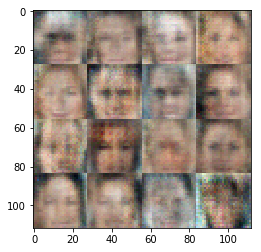

Epoch 1/2... Discriminator Loss: 1.3105... Generator Loss: 0.6263


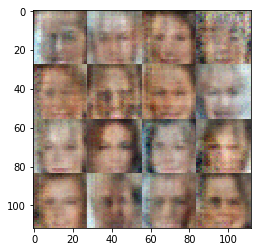

Epoch 1/2... Discriminator Loss: 1.1989... Generator Loss: 0.6615


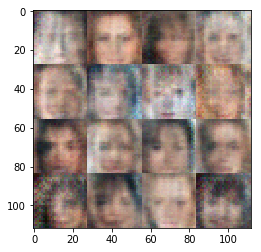

Epoch 1/2... Discriminator Loss: 1.1935... Generator Loss: 1.2135


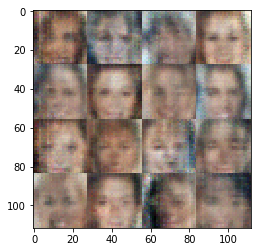

Epoch 1/2... Discriminator Loss: 0.5722... Generator Loss: 6.1850


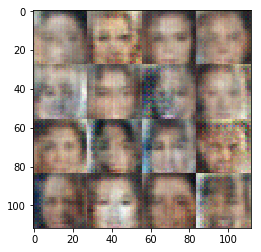

Epoch 1/2... Discriminator Loss: 0.0476... Generator Loss: 3.4769


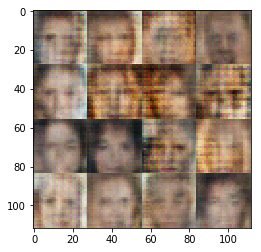

Epoch 1/2... Discriminator Loss: 0.0186... Generator Loss: 5.1548


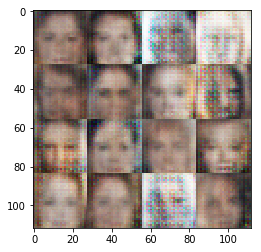

Epoch 1/2... Discriminator Loss: 0.0089... Generator Loss: 5.5915


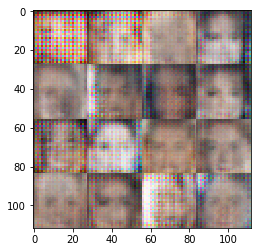

Epoch 1/2... Discriminator Loss: 0.1572... Generator Loss: 2.2795


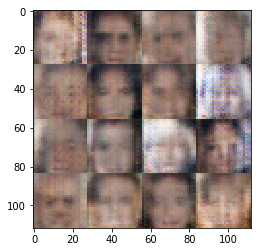

Epoch 1/2... Discriminator Loss: 0.0077... Generator Loss: 5.2239


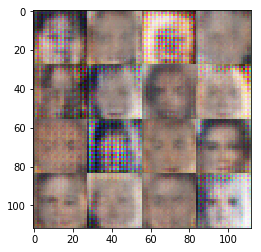

Epoch 1/2... Discriminator Loss: 0.3977... Generator Loss: 1.2917


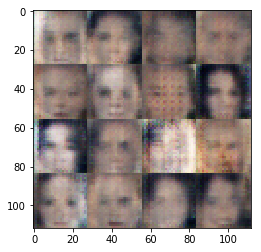

Epoch 1/2... Discriminator Loss: 3.8517... Generator Loss: 3.4047


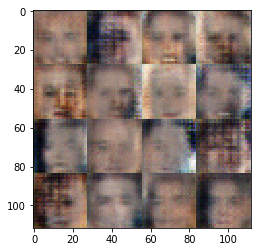

Epoch 1/2... Discriminator Loss: 1.2259... Generator Loss: 0.6610


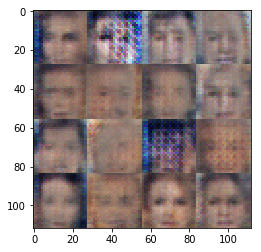

Epoch 1/2... Discriminator Loss: 0.7832... Generator Loss: 0.9940


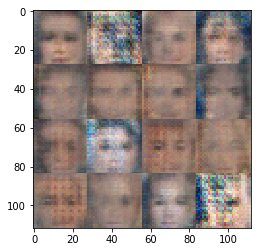

Epoch 1/2... Discriminator Loss: 1.4234... Generator Loss: 0.3672


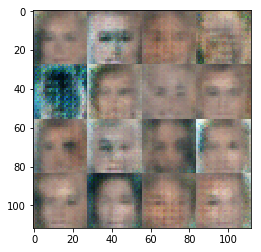

Epoch 1/2... Discriminator Loss: 1.7810... Generator Loss: 1.5209


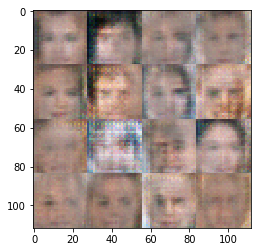

Epoch 1/2... Discriminator Loss: 0.5522... Generator Loss: 0.9319


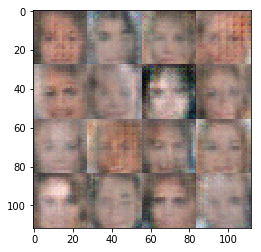

Epoch 1/2... Discriminator Loss: 1.5337... Generator Loss: 1.7859


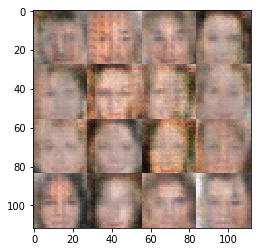

Epoch 1/2... Discriminator Loss: 3.4183... Generator Loss: 3.4797


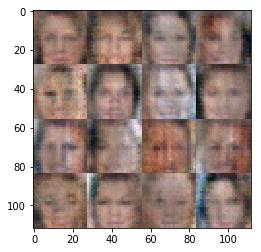

Epoch 1/2... Discriminator Loss: 0.1224... Generator Loss: 3.1438


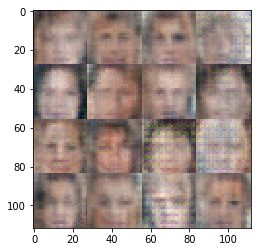

Epoch 1/2... Discriminator Loss: 0.1099... Generator Loss: 5.2013


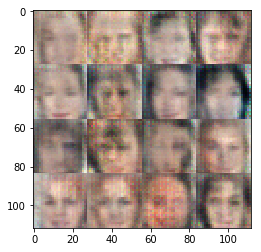

Epoch 1/2... Discriminator Loss: 3.0138... Generator Loss: 5.5552


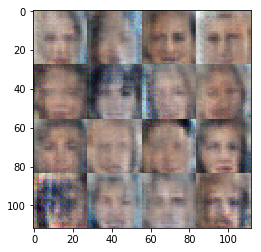

Epoch 1/2... Discriminator Loss: 1.6087... Generator Loss: 0.6274


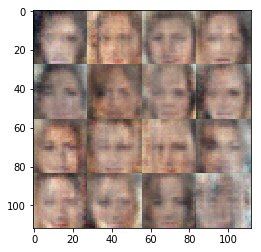

Epoch 1/2... Discriminator Loss: 1.3899... Generator Loss: 0.6661


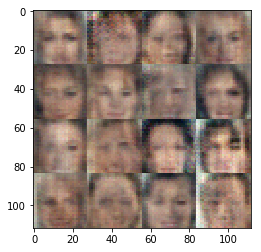

Epoch 1/2... Discriminator Loss: 1.3625... Generator Loss: 0.4476


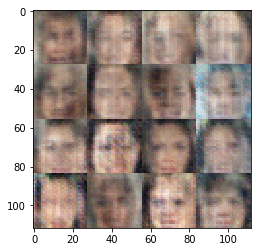

Epoch 1/2... Discriminator Loss: 0.0775... Generator Loss: 3.2108


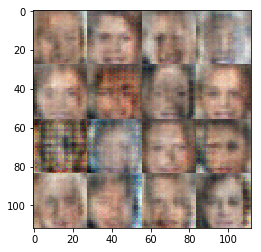

Epoch 1/2... Discriminator Loss: 1.9667... Generator Loss: 0.3385


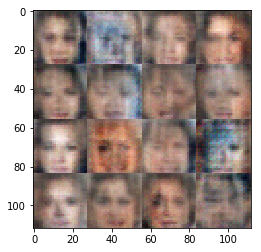

Epoch 1/2... Discriminator Loss: 1.4000... Generator Loss: 0.6749


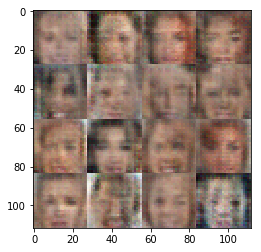

Epoch 1/2... Discriminator Loss: 1.3536... Generator Loss: 0.5638


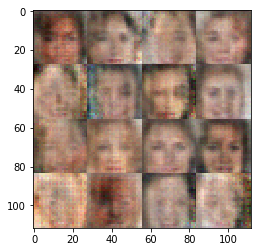

Epoch 1/2... Discriminator Loss: 1.4119... Generator Loss: 0.9790


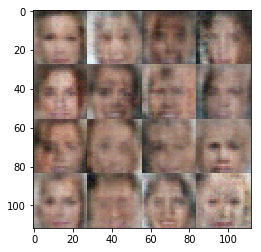

Epoch 1/2... Discriminator Loss: 1.3412... Generator Loss: 0.7054


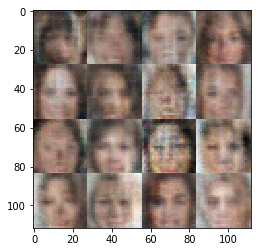

Epoch 1/2... Discriminator Loss: 1.2629... Generator Loss: 0.6639


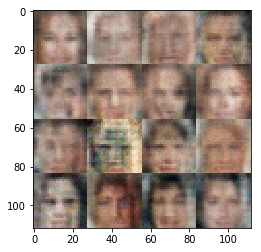

Epoch 1/2... Discriminator Loss: 1.3918... Generator Loss: 0.5583


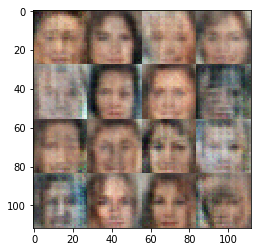

Epoch 1/2... Discriminator Loss: 1.4520... Generator Loss: 1.0351


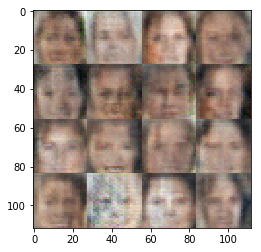

Epoch 1/2... Discriminator Loss: 1.4143... Generator Loss: 0.5759


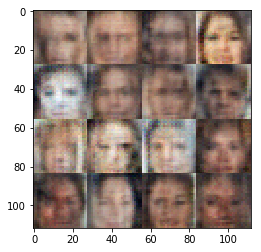

Epoch 1/2... Discriminator Loss: 1.2783... Generator Loss: 0.9535


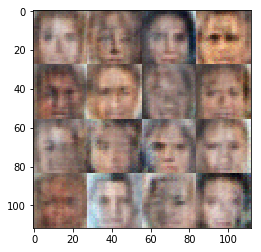

Epoch 1/2... Discriminator Loss: 1.2712... Generator Loss: 0.7436


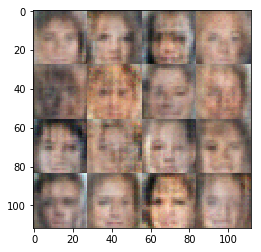

Epoch 1/2... Discriminator Loss: 1.2739... Generator Loss: 0.5790


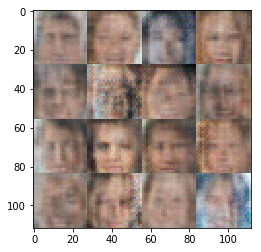

Epoch 1/2... Discriminator Loss: 1.2732... Generator Loss: 0.8080


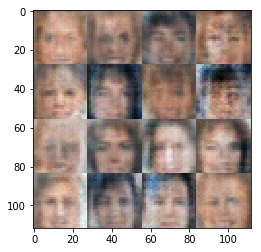

Epoch 1/2... Discriminator Loss: 1.3599... Generator Loss: 0.7526


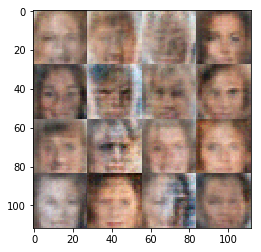

Epoch 1/2... Discriminator Loss: 1.3128... Generator Loss: 0.4959


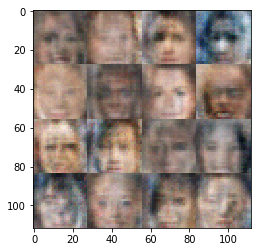

Epoch 1/2... Discriminator Loss: 1.1583... Generator Loss: 0.6261


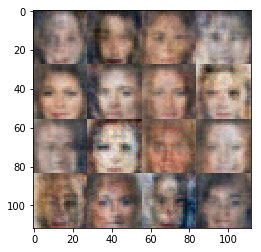

Epoch 1/2... Discriminator Loss: 1.2776... Generator Loss: 0.6792


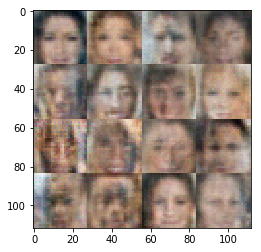

Epoch 1/2... Discriminator Loss: 1.3168... Generator Loss: 0.4820


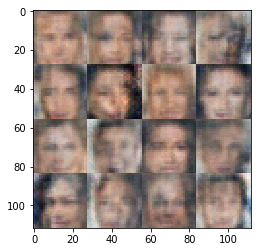

Epoch 1/2... Discriminator Loss: 1.7850... Generator Loss: 0.2439


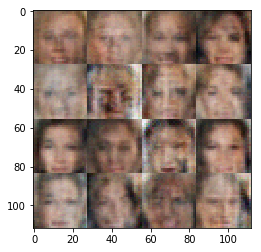

Epoch 1/2... Discriminator Loss: 1.2817... Generator Loss: 0.6774


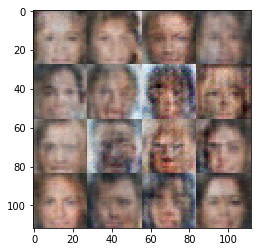

Epoch 1/2... Discriminator Loss: 1.2888... Generator Loss: 0.7761


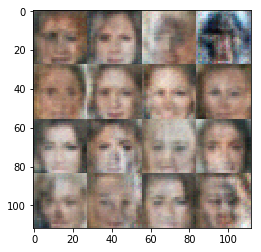

Epoch 1/2... Discriminator Loss: 1.2109... Generator Loss: 1.8647


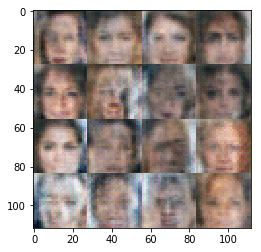

Epoch 1/2... Discriminator Loss: 1.3002... Generator Loss: 0.6856


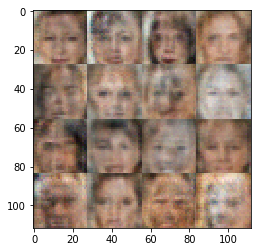

Epoch 1/2... Discriminator Loss: 0.4725... Generator Loss: 1.3790


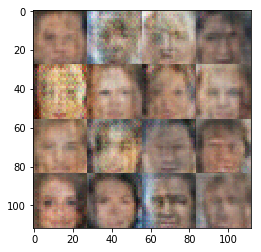

Epoch 1/2... Discriminator Loss: 2.1057... Generator Loss: 0.4172


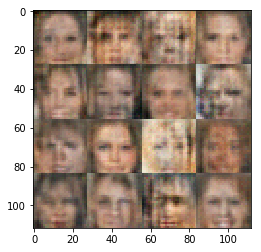

Epoch 1/2... Discriminator Loss: 1.2905... Generator Loss: 0.6365


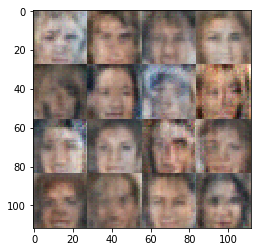

Epoch 1/2... Discriminator Loss: 1.1699... Generator Loss: 0.9742


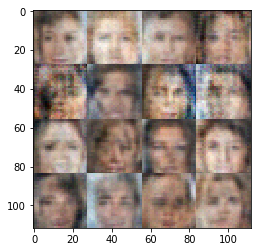

Epoch 1/2... Discriminator Loss: 1.1263... Generator Loss: 0.5536


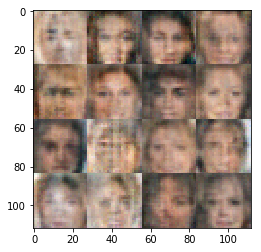

Epoch 1/2... Discriminator Loss: 1.3956... Generator Loss: 0.6017


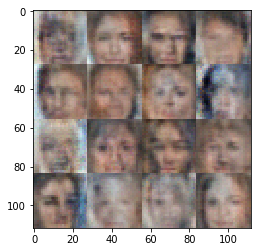

Epoch 1/2... Discriminator Loss: 0.1059... Generator Loss: 3.1764


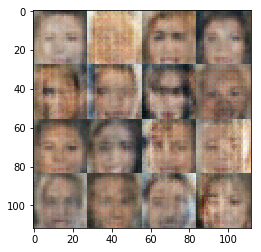

Epoch 1/2... Discriminator Loss: 1.5089... Generator Loss: 0.6743


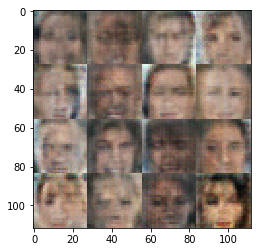

Epoch 1/2... Discriminator Loss: 0.7632... Generator Loss: 1.3714


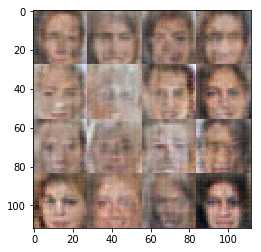

Epoch 1/2... Discriminator Loss: 1.6179... Generator Loss: 3.0838


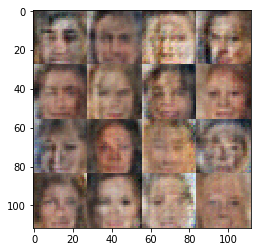

Epoch 1/2... Discriminator Loss: 1.0002... Generator Loss: 0.9518


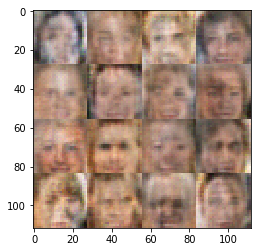

Epoch 1/2... Discriminator Loss: 1.0226... Generator Loss: 1.2799


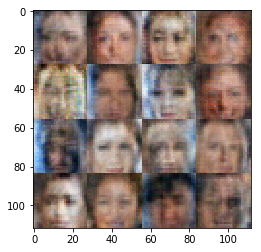

Epoch 1/2... Discriminator Loss: 0.9262... Generator Loss: 0.7545


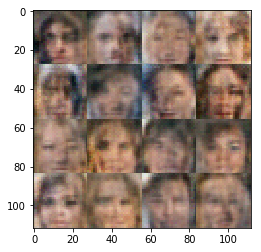

Epoch 1/2... Discriminator Loss: 0.3904... Generator Loss: 2.5872


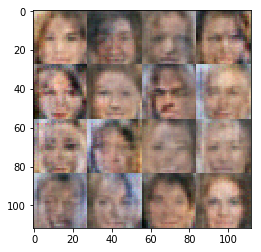

Epoch 1/2... Discriminator Loss: 1.3701... Generator Loss: 0.7087


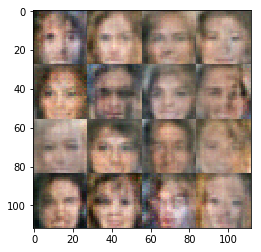

Epoch 1/2... Discriminator Loss: 1.3646... Generator Loss: 0.6979


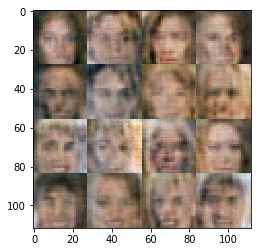

Epoch 1/2... Discriminator Loss: 1.3220... Generator Loss: 0.7580


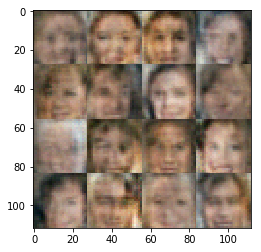

Epoch 1/2... Discriminator Loss: 1.3437... Generator Loss: 0.7434


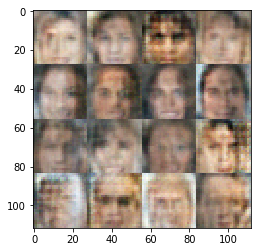

Epoch 1/2... Discriminator Loss: 1.3483... Generator Loss: 0.5854


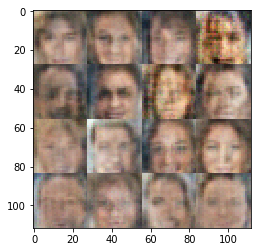

Epoch 1/2... Discriminator Loss: 1.2697... Generator Loss: 0.8660


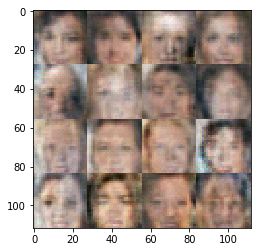

Epoch 1/2... Discriminator Loss: 1.3658... Generator Loss: 1.2349


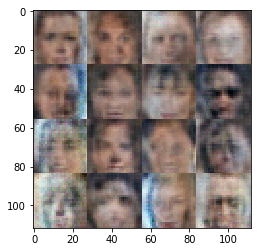

Epoch 1/2... Discriminator Loss: 1.2997... Generator Loss: 0.5092


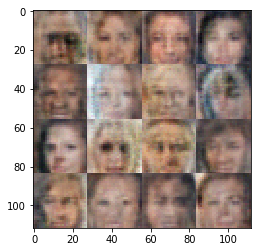

Epoch 1/2... Discriminator Loss: 1.3077... Generator Loss: 0.5810


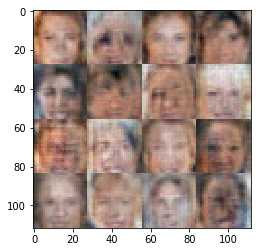

Epoch 1/2... Discriminator Loss: 1.5482... Generator Loss: 0.3459


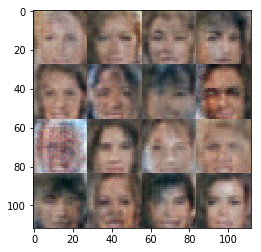

Epoch 1/2... Discriminator Loss: 1.7594... Generator Loss: 0.2615


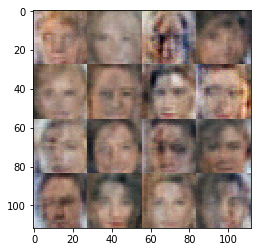

Epoch 1/2... Discriminator Loss: 0.7210... Generator Loss: 1.0027


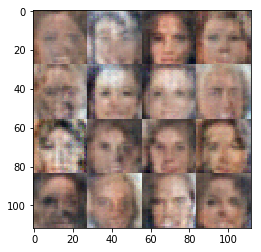

Epoch 1/2... Discriminator Loss: 1.4573... Generator Loss: 0.7798


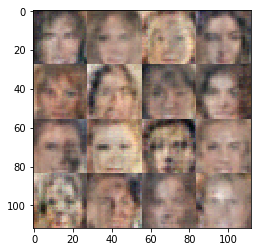

Epoch 1/2... Discriminator Loss: 1.2763... Generator Loss: 0.6854


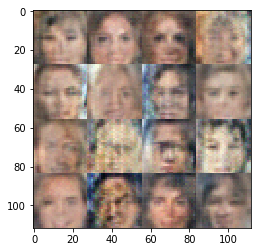

Epoch 1/2... Discriminator Loss: 1.2702... Generator Loss: 0.7881


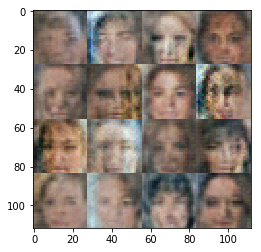

Epoch 1/2... Discriminator Loss: 1.2836... Generator Loss: 0.6998


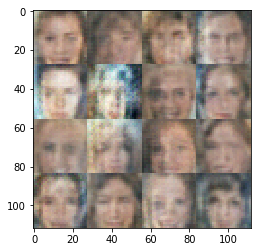

Epoch 1/2... Discriminator Loss: 1.3406... Generator Loss: 0.7586


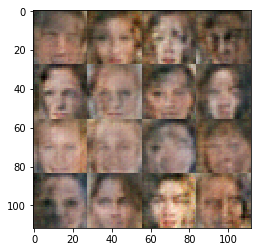

Epoch 1/2... Discriminator Loss: 1.1972... Generator Loss: 0.7207


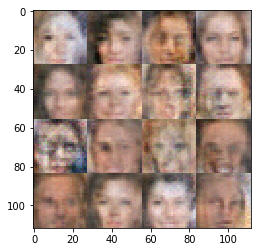

Epoch 1/2... Discriminator Loss: 0.6968... Generator Loss: 0.9677


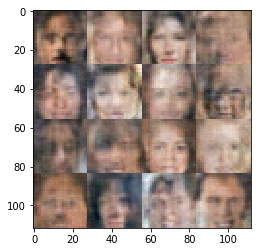

Epoch 1/2... Discriminator Loss: 2.0075... Generator Loss: 0.1815


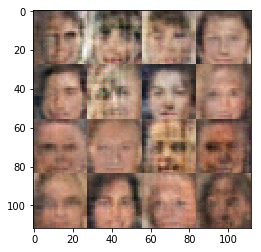

Epoch 1/2... Discriminator Loss: 0.5928... Generator Loss: 0.9334


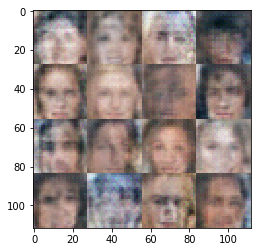

Epoch 1/2... Discriminator Loss: 1.4969... Generator Loss: 1.0284


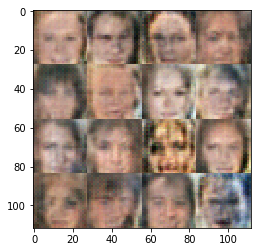

Epoch 1/2... Discriminator Loss: 1.7753... Generator Loss: 0.3179


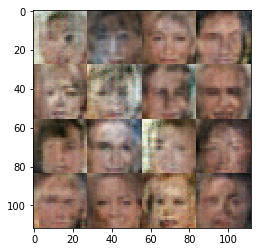

Epoch 1/2... Discriminator Loss: 1.2979... Generator Loss: 0.4777


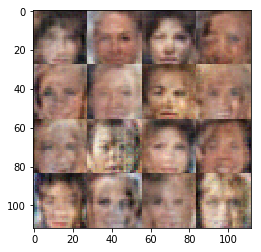

Epoch 1/2... Discriminator Loss: 1.3078... Generator Loss: 0.4011


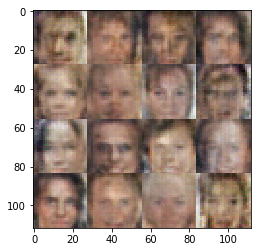

Epoch 1/2... Discriminator Loss: 0.9449... Generator Loss: 1.8881


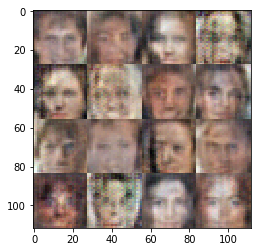

Epoch 1/2... Discriminator Loss: 3.5910... Generator Loss: 3.8967


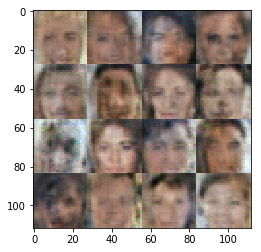

Epoch 1/2... Discriminator Loss: 0.2185... Generator Loss: 2.0074


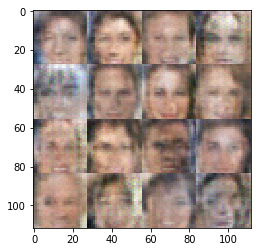

Epoch 1/2... Discriminator Loss: 0.1032... Generator Loss: 2.9202


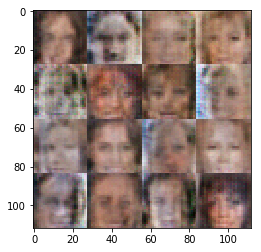

Epoch 1/2... Discriminator Loss: 0.5141... Generator Loss: 1.0888


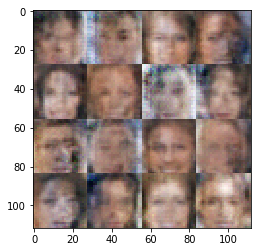

Epoch 1/2... Discriminator Loss: 0.1123... Generator Loss: 3.6397


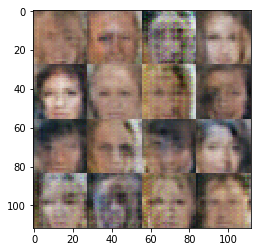

Epoch 1/2... Discriminator Loss: 0.1908... Generator Loss: 2.0453


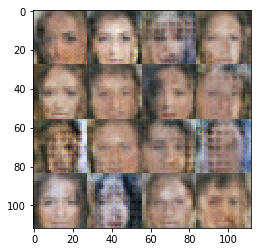

Epoch 1/2... Discriminator Loss: 0.4561... Generator Loss: 1.1451


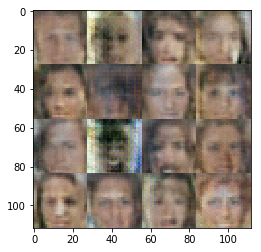

Epoch 1/2... Discriminator Loss: 0.1126... Generator Loss: 2.4674


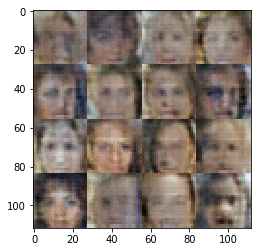

Epoch 1/2... Discriminator Loss: 0.0824... Generator Loss: 2.8133


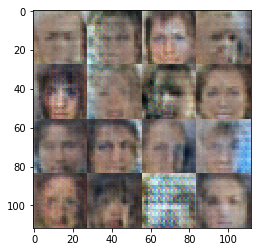

Epoch 1/2... Discriminator Loss: 0.0095... Generator Loss: 5.6709


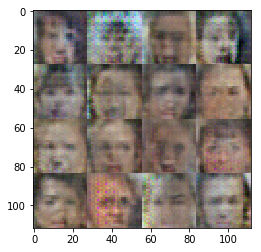

Epoch 1/2... Discriminator Loss: 0.0066... Generator Loss: 6.0145


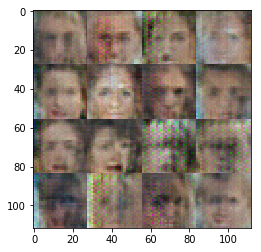

Epoch 1/2... Discriminator Loss: 0.0154... Generator Loss: 4.7317


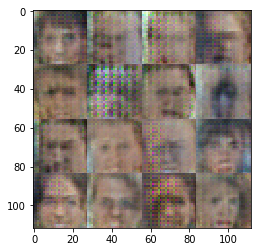

Epoch 1/2... Discriminator Loss: 0.0292... Generator Loss: 4.0217


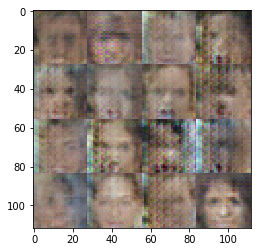

Epoch 1/2... Discriminator Loss: 0.1377... Generator Loss: 2.2532


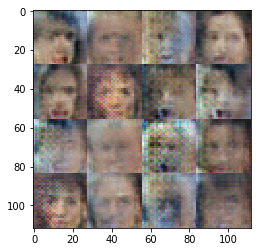

Epoch 1/2... Discriminator Loss: 0.0174... Generator Loss: 4.6741


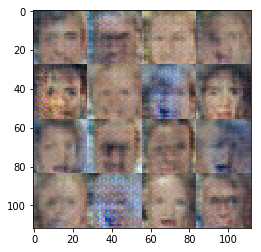

Epoch 1/2... Discriminator Loss: 0.0110... Generator Loss: 5.0606


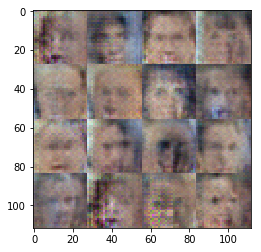

Epoch 1/2... Discriminator Loss: 0.0074... Generator Loss: 5.7623


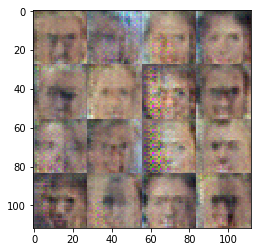

Epoch 1/2... Discriminator Loss: 0.0078... Generator Loss: 5.9805


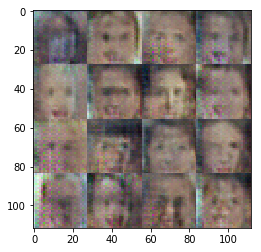

Epoch 1/2... Discriminator Loss: 0.0425... Generator Loss: 3.5340


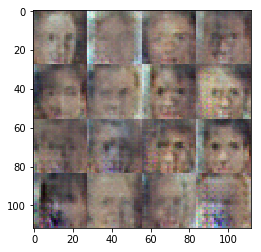

Epoch 1/2... Discriminator Loss: 0.0074... Generator Loss: 5.7134


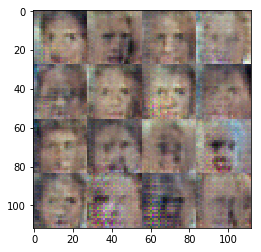

Epoch 1/2... Discriminator Loss: 0.0112... Generator Loss: 5.4670


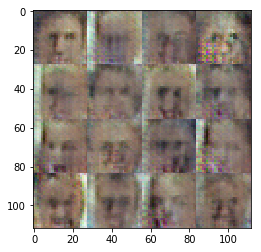

Epoch 1/2... Discriminator Loss: 0.0146... Generator Loss: 5.0221


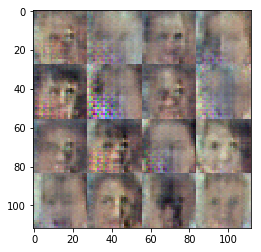

Epoch 1/2... Discriminator Loss: 0.0313... Generator Loss: 3.9718


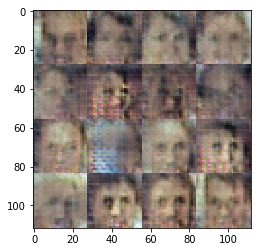

Epoch 1/2... Discriminator Loss: 0.0251... Generator Loss: 4.6256


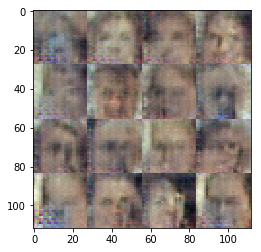

Epoch 1/2... Discriminator Loss: 0.0487... Generator Loss: 3.4888


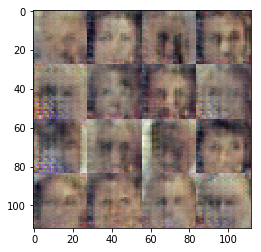

Epoch 1/2... Discriminator Loss: 0.0041... Generator Loss: 7.0924


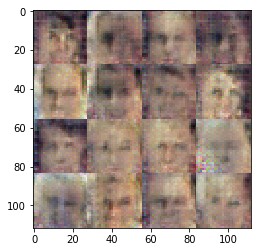

Epoch 1/2... Discriminator Loss: 0.0373... Generator Loss: 3.7476


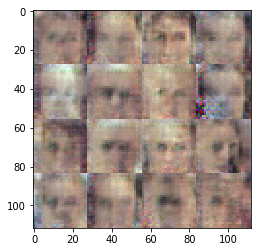

Epoch 1/2... Discriminator Loss: 0.0333... Generator Loss: 3.8789


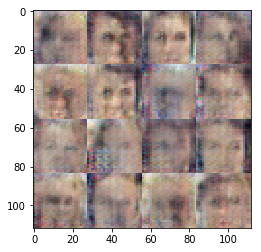

Epoch 1/2... Discriminator Loss: 0.0188... Generator Loss: 4.8148


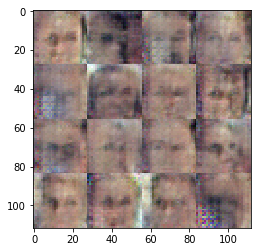

Epoch 1/2... Discriminator Loss: 0.0041... Generator Loss: 8.7101


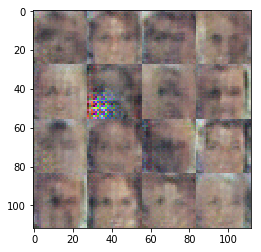

Epoch 1/2... Discriminator Loss: 1.9135... Generator Loss: 4.4681


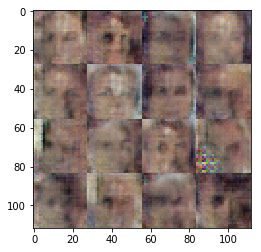

Epoch 1/2... Discriminator Loss: 0.3159... Generator Loss: 2.2259


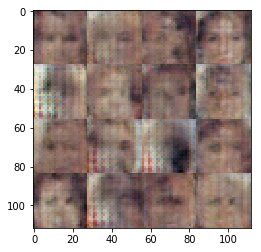

Epoch 1/2... Discriminator Loss: 0.4876... Generator Loss: 3.3747


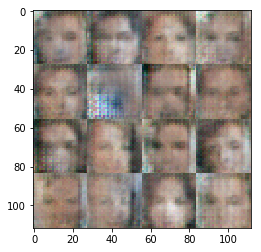

Epoch 1/2... Discriminator Loss: 1.2145... Generator Loss: 0.5714


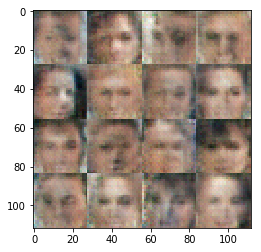

Epoch 1/2... Discriminator Loss: 0.9127... Generator Loss: 1.3096


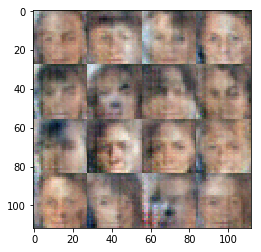

Epoch 1/2... Discriminator Loss: 1.2239... Generator Loss: 0.5154


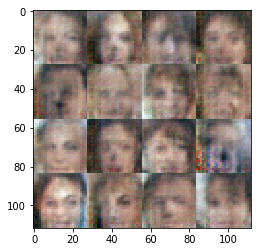

Epoch 1/2... Discriminator Loss: 1.4638... Generator Loss: 0.3768


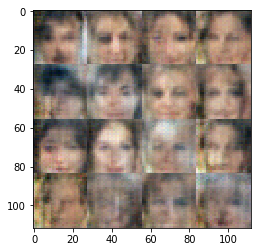

Epoch 1/2... Discriminator Loss: 1.9634... Generator Loss: 0.2099


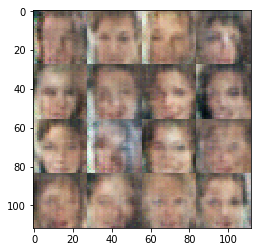

Epoch 1/2... Discriminator Loss: 1.0902... Generator Loss: 0.6966


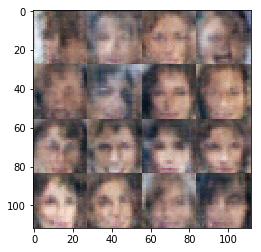

Epoch 1/2... Discriminator Loss: 1.0729... Generator Loss: 0.6635


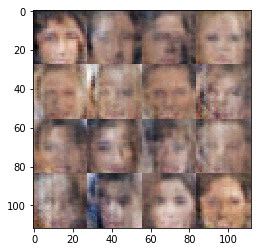

Epoch 1/2... Discriminator Loss: 1.2024... Generator Loss: 0.5076


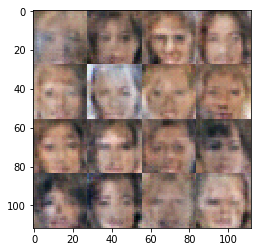

Epoch 1/2... Discriminator Loss: 0.3418... Generator Loss: 1.7138


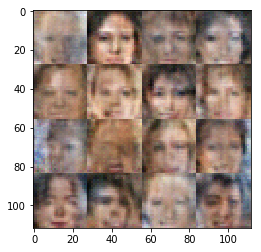

Epoch 1/2... Discriminator Loss: 1.3607... Generator Loss: 0.6744


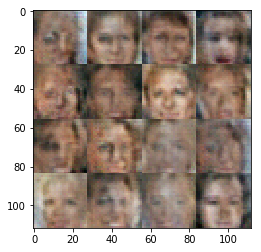

Epoch 1/2... Discriminator Loss: 0.7044... Generator Loss: 1.0588


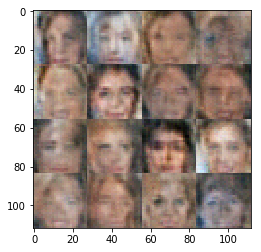

Epoch 1/2... Discriminator Loss: 1.7409... Generator Loss: 0.3064


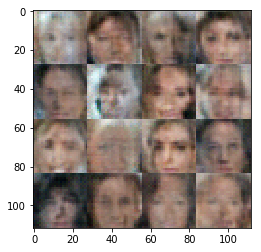

Epoch 1/2... Discriminator Loss: 0.1241... Generator Loss: 3.0830


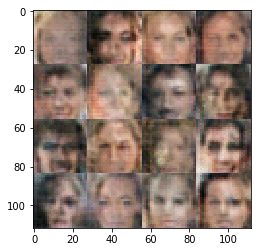

Epoch 1/2... Discriminator Loss: 4.1696... Generator Loss: 3.7774


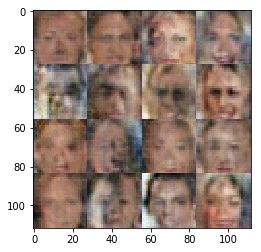

Epoch 1/2... Discriminator Loss: 1.3909... Generator Loss: 0.6706


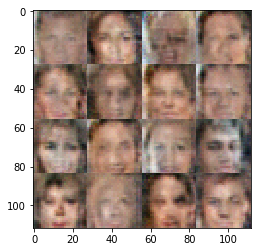

Epoch 1/2... Discriminator Loss: 1.3008... Generator Loss: 1.0930


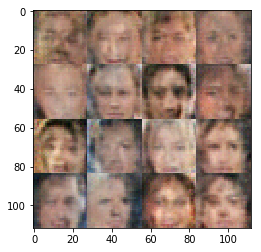

Epoch 1/2... Discriminator Loss: 1.3579... Generator Loss: 1.4236


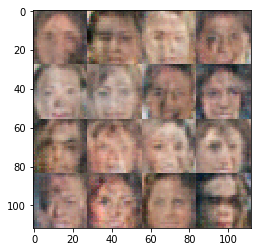

Epoch 1/2... Discriminator Loss: 1.2961... Generator Loss: 0.5075


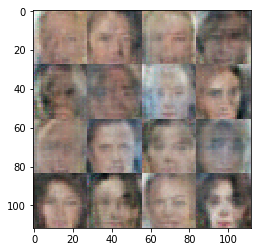

Epoch 1/2... Discriminator Loss: 1.2592... Generator Loss: 1.2876


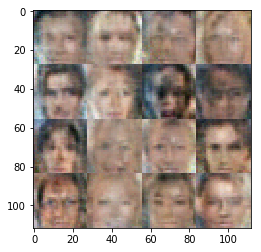

Epoch 1/2... Discriminator Loss: 1.6148... Generator Loss: 1.9598


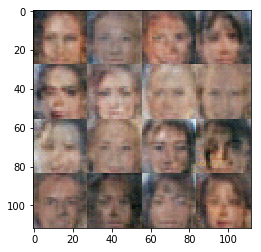

Epoch 1/2... Discriminator Loss: 1.1824... Generator Loss: 0.8047


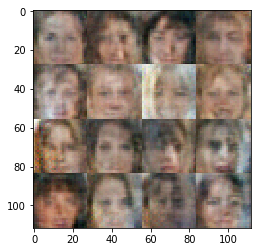

Epoch 1/2... Discriminator Loss: 1.2370... Generator Loss: 0.4780


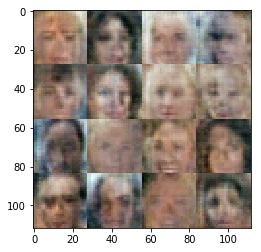

Epoch 1/2... Discriminator Loss: 2.8900... Generator Loss: 3.4336


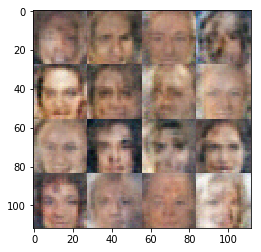

Epoch 1/2... Discriminator Loss: 2.2089... Generator Loss: 0.1501


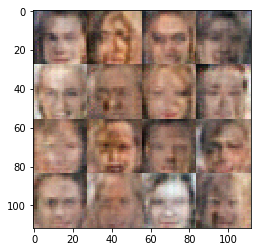

Epoch 1/2... Discriminator Loss: 1.2765... Generator Loss: 0.5732


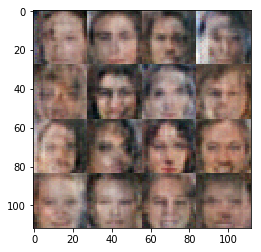

Epoch 1/2... Discriminator Loss: 1.1694... Generator Loss: 2.1744


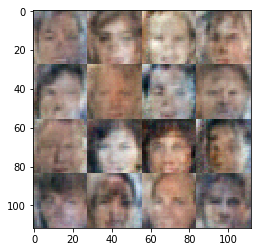

Epoch 1/2... Discriminator Loss: 1.6156... Generator Loss: 0.2927


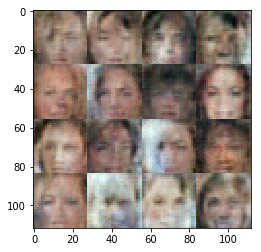

Epoch 1/2... Discriminator Loss: 1.3160... Generator Loss: 0.3756


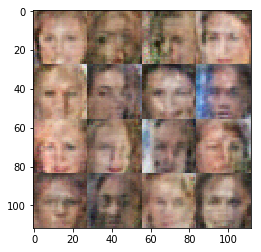

Epoch 1/2... Discriminator Loss: 1.4094... Generator Loss: 0.6218


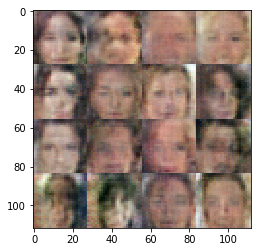

Epoch 1/2... Discriminator Loss: 0.2553... Generator Loss: 1.8612


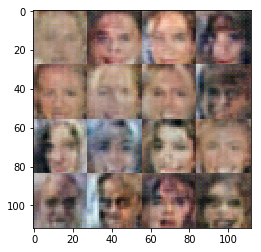

Epoch 1/2... Discriminator Loss: 0.2643... Generator Loss: 3.4301


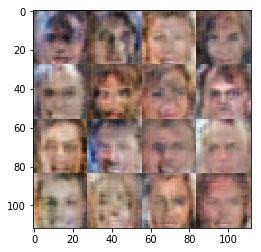

Epoch 1/2... Discriminator Loss: 0.3818... Generator Loss: 1.5122


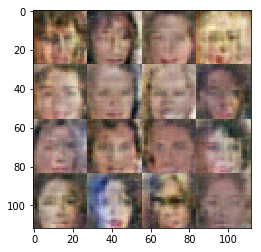

Epoch 1/2... Discriminator Loss: 1.2629... Generator Loss: 0.6982


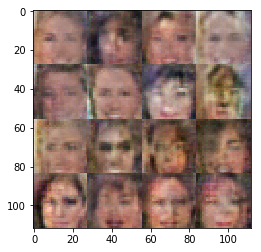

Epoch 1/2... Discriminator Loss: 1.2857... Generator Loss: 0.5494


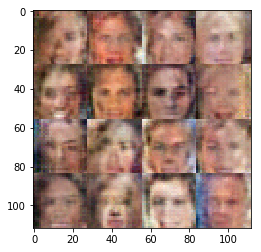

Epoch 1/2... Discriminator Loss: 0.6906... Generator Loss: 0.9458


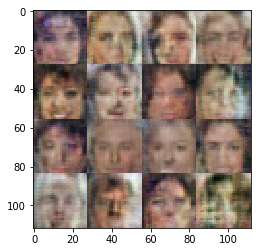

Epoch 1/2... Discriminator Loss: 1.3385... Generator Loss: 0.9351


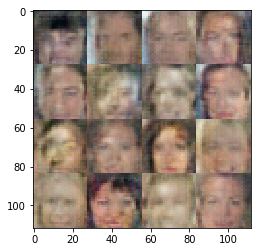

Epoch 1/2... Discriminator Loss: 1.3231... Generator Loss: 0.5893


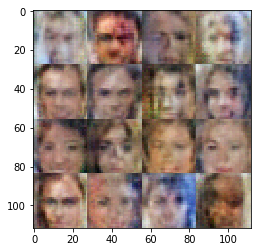

Epoch 1/2... Discriminator Loss: 1.3642... Generator Loss: 0.4483


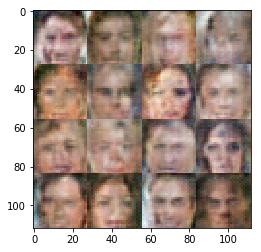

Epoch 1/2... Discriminator Loss: 1.2391... Generator Loss: 1.0992


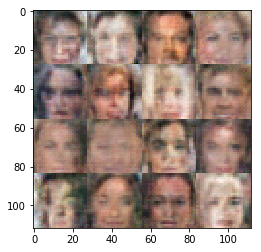

Epoch 1/2... Discriminator Loss: 1.2462... Generator Loss: 0.4641


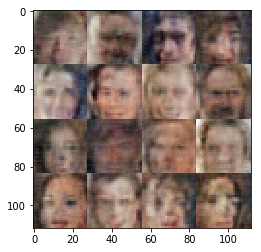

Epoch 1/2... Discriminator Loss: 1.0959... Generator Loss: 0.7610


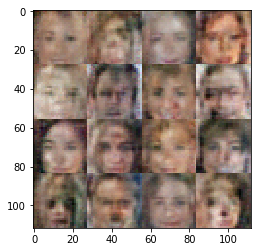

Epoch 1/2... Discriminator Loss: 0.8578... Generator Loss: 1.3155


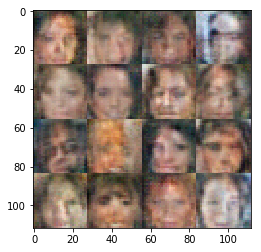

Epoch 1/2... Discriminator Loss: 1.1292... Generator Loss: 1.3126


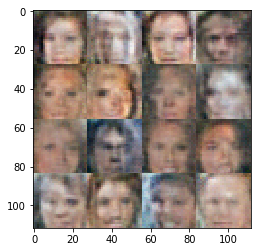

Epoch 1/2... Discriminator Loss: 0.3503... Generator Loss: 1.4965


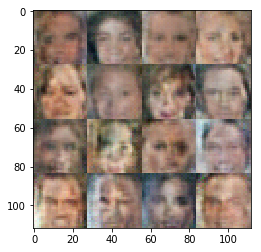

Epoch 1/2... Discriminator Loss: 2.9774... Generator Loss: 5.5447


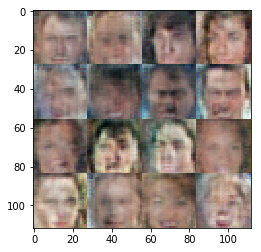

Epoch 1/2... Discriminator Loss: 1.1715... Generator Loss: 0.4956


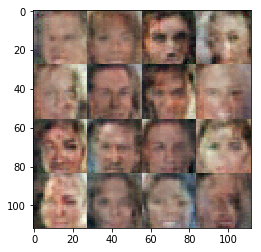

Epoch 1/2... Discriminator Loss: 0.1344... Generator Loss: 2.6729


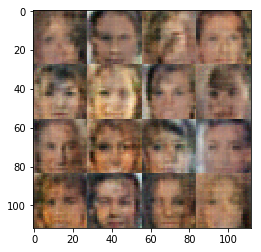

Epoch 1/2... Discriminator Loss: 1.1079... Generator Loss: 0.5192


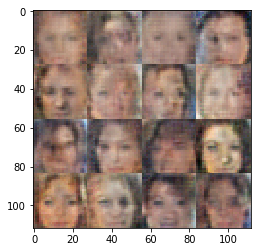

Epoch 1/2... Discriminator Loss: 0.2799... Generator Loss: 2.4198


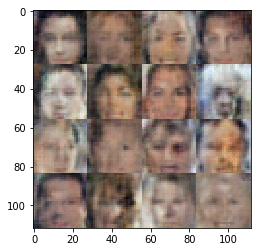

Epoch 1/2... Discriminator Loss: 0.5475... Generator Loss: 1.7348


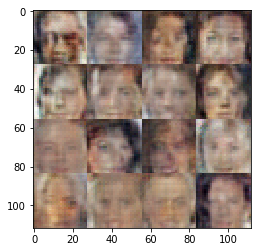

Epoch 1/2... Discriminator Loss: 1.0061... Generator Loss: 0.5608


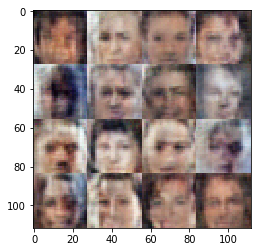

Epoch 1/2... Discriminator Loss: 0.0526... Generator Loss: 3.5500


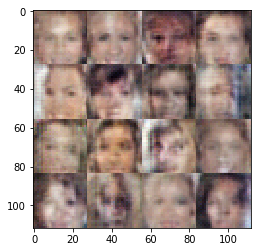

Epoch 1/2... Discriminator Loss: 1.3424... Generator Loss: 0.3756


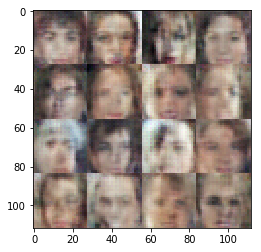

Epoch 1/2... Discriminator Loss: 1.5547... Generator Loss: 0.6131


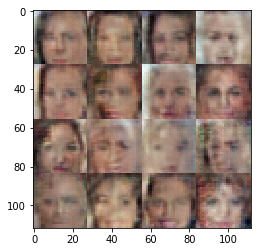

Epoch 1/2... Discriminator Loss: 0.3967... Generator Loss: 2.5695


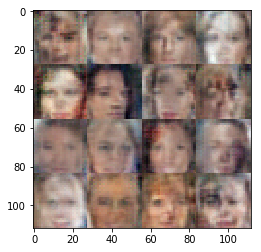

Epoch 1/2... Discriminator Loss: 0.0930... Generator Loss: 2.8405


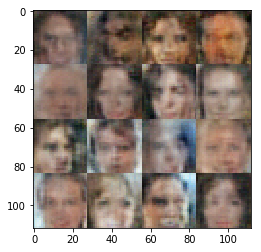

Epoch 1/2... Discriminator Loss: 1.4838... Generator Loss: 1.0106


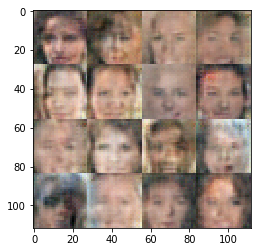

Epoch 1/2... Discriminator Loss: 1.2353... Generator Loss: 0.8128


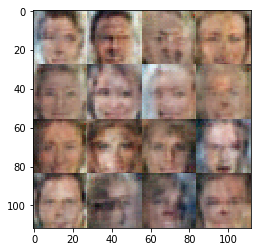

Epoch 1/2... Discriminator Loss: 1.2490... Generator Loss: 1.0070


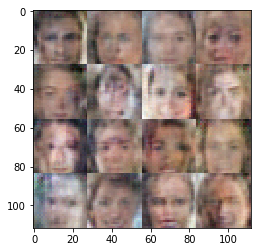

Epoch 1/2... Discriminator Loss: 1.5823... Generator Loss: 0.2910


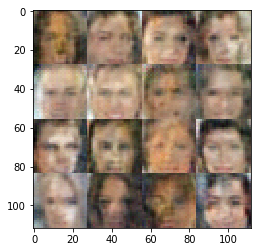

Epoch 1/2... Discriminator Loss: 1.1023... Generator Loss: 0.7549


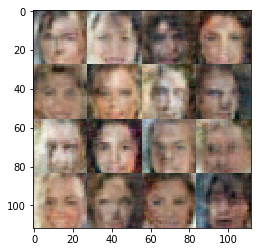

Epoch 1/2... Discriminator Loss: 0.4264... Generator Loss: 1.6317


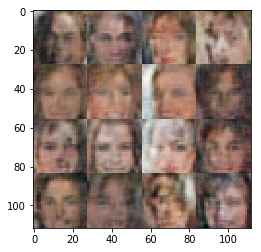

Epoch 1/2... Discriminator Loss: 1.3171... Generator Loss: 0.4263


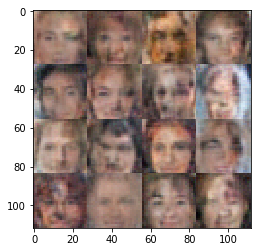

Epoch 1/2... Discriminator Loss: 1.8393... Generator Loss: 1.9646


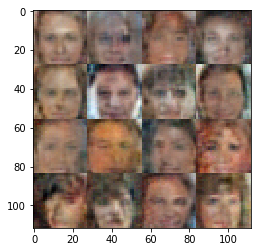

Epoch 1/2... Discriminator Loss: 1.8062... Generator Loss: 0.2315


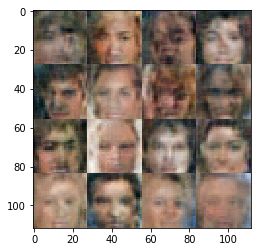

Epoch 1/2... Discriminator Loss: 1.7004... Generator Loss: 0.2526


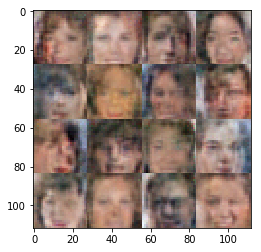

Epoch 1/2... Discriminator Loss: 0.6840... Generator Loss: 1.1527


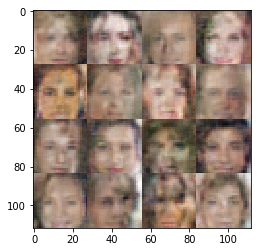

Epoch 1/2... Discriminator Loss: 0.3726... Generator Loss: 1.7080


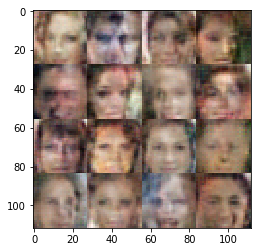

Epoch 1/2... Discriminator Loss: 1.1253... Generator Loss: 1.6996


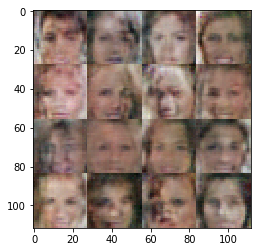

Epoch 1/2... Discriminator Loss: 1.3471... Generator Loss: 2.1396


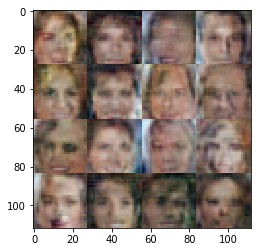

Epoch 1/2... Discriminator Loss: 0.8787... Generator Loss: 0.9167


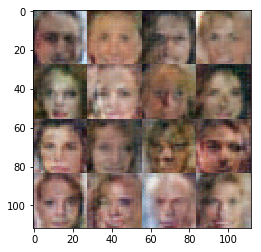

Epoch 1/2... Discriminator Loss: 2.5328... Generator Loss: 3.8118


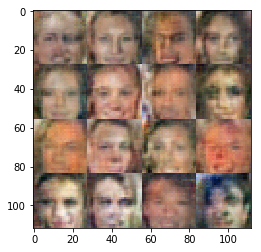

Epoch 1/2... Discriminator Loss: 1.0949... Generator Loss: 0.7134


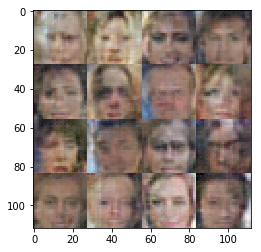

Epoch 1/2... Discriminator Loss: 1.1815... Generator Loss: 1.1210


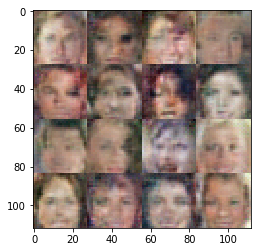

Epoch 1/2... Discriminator Loss: 1.2279... Generator Loss: 0.4994


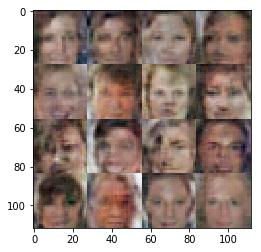

Epoch 1/2... Discriminator Loss: 0.9673... Generator Loss: 0.6403


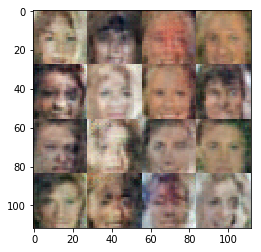

Epoch 1/2... Discriminator Loss: 0.8148... Generator Loss: 1.2079


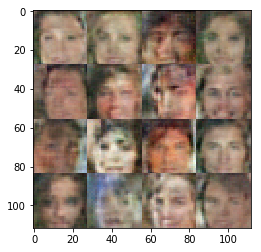

Epoch 1/2... Discriminator Loss: 2.3241... Generator Loss: 3.4636


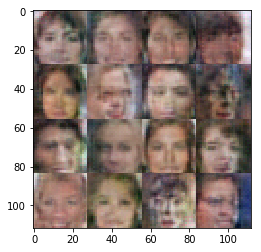

Epoch 1/2... Discriminator Loss: 1.3385... Generator Loss: 0.5181


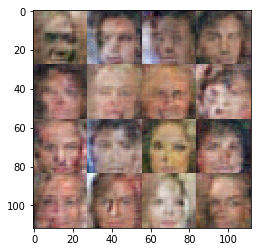

Epoch 1/2... Discriminator Loss: 1.3545... Generator Loss: 0.4021


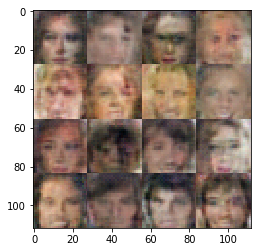

Epoch 1/2... Discriminator Loss: 1.0309... Generator Loss: 1.0416


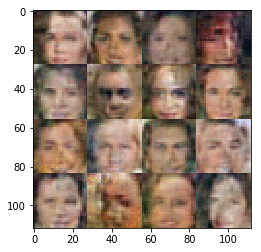

Epoch 1/2... Discriminator Loss: 1.1256... Generator Loss: 0.5928


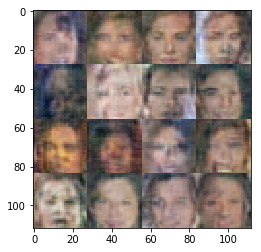

Epoch 1/2... Discriminator Loss: 1.7181... Generator Loss: 0.2547


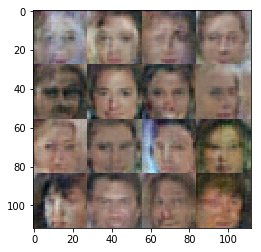

Epoch 1/2... Discriminator Loss: 0.9905... Generator Loss: 0.7363


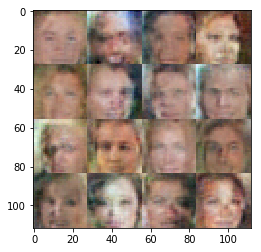

Epoch 1/2... Discriminator Loss: 1.6737... Generator Loss: 0.2947


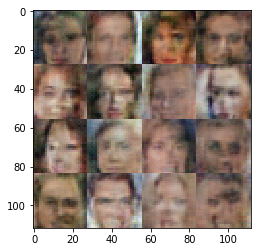

Epoch 1/2... Discriminator Loss: 1.1836... Generator Loss: 0.5332


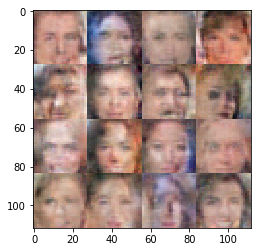

Epoch 1/2... Discriminator Loss: 0.8900... Generator Loss: 1.7344


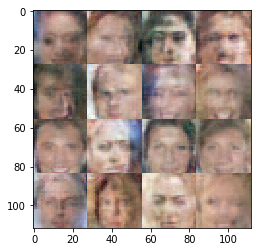

Epoch 1/2... Discriminator Loss: 1.4827... Generator Loss: 0.3676


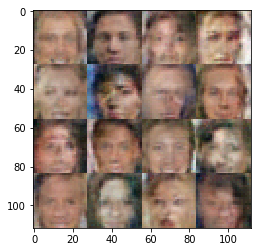

Epoch 1/2... Discriminator Loss: 1.0854... Generator Loss: 0.9032


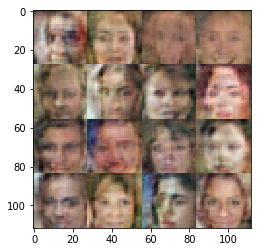

Epoch 1/2... Discriminator Loss: 1.5325... Generator Loss: 0.3096


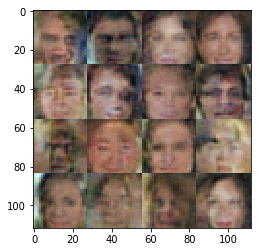

Epoch 1/2... Discriminator Loss: 0.5704... Generator Loss: 3.0253


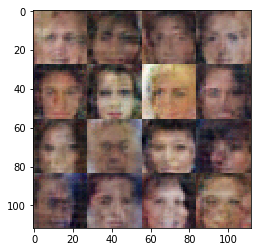

Epoch 1/2... Discriminator Loss: 1.6116... Generator Loss: 0.3053


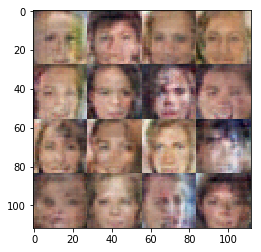

Epoch 1/2... Discriminator Loss: 1.0743... Generator Loss: 0.5462


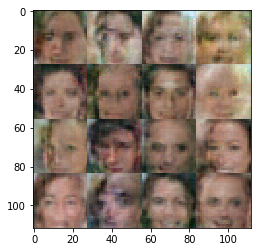

Epoch 1/2... Discriminator Loss: 0.1073... Generator Loss: 3.3433


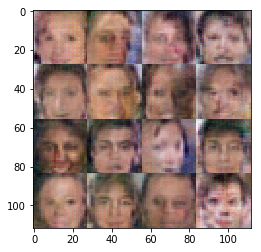

Epoch 1/2... Discriminator Loss: 1.3431... Generator Loss: 0.5459


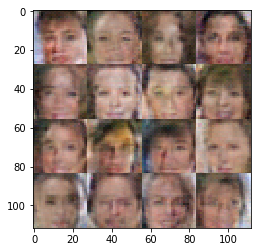

Epoch 1/2... Discriminator Loss: 1.0941... Generator Loss: 0.6397


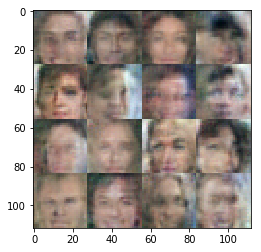

Epoch 1/2... Discriminator Loss: 1.1084... Generator Loss: 0.5929


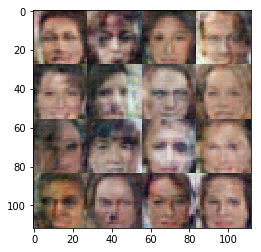

Epoch 1/2... Discriminator Loss: 0.5949... Generator Loss: 1.0735


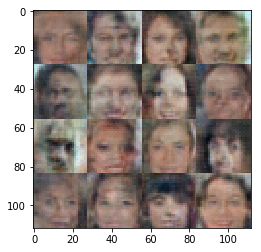

Epoch 1/2... Discriminator Loss: 1.0672... Generator Loss: 1.8186


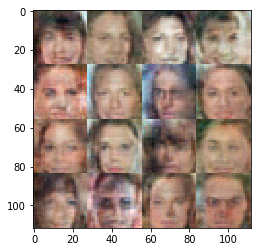

Epoch 1/2... Discriminator Loss: 2.5447... Generator Loss: 0.0996


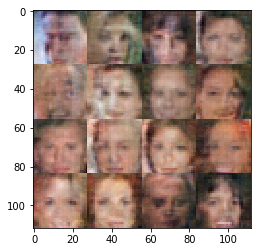

Epoch 1/2... Discriminator Loss: 0.5226... Generator Loss: 1.2951


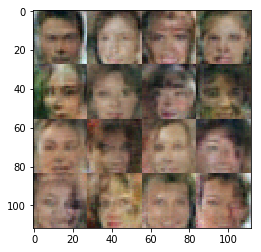

Epoch 1/2... Discriminator Loss: 0.7740... Generator Loss: 0.8733


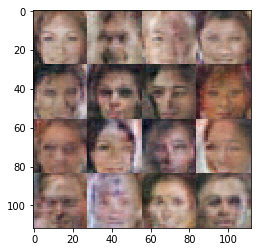

Epoch 1/2... Discriminator Loss: 2.0583... Generator Loss: 2.2984


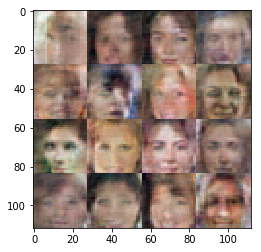

Epoch 1/2... Discriminator Loss: 0.8991... Generator Loss: 0.6875


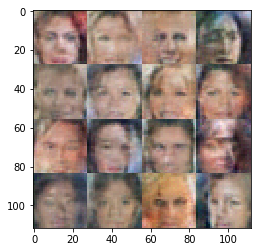

Epoch 1/2... Discriminator Loss: 0.4997... Generator Loss: 1.2392


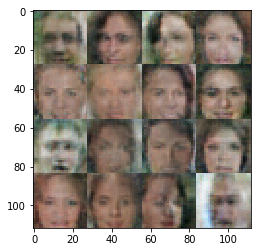

Epoch 1/2... Discriminator Loss: 0.2894... Generator Loss: 2.4126


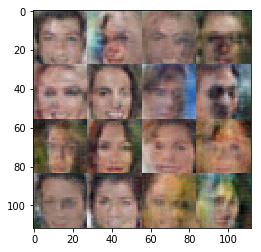

Epoch 1/2... Discriminator Loss: 1.1987... Generator Loss: 0.5844


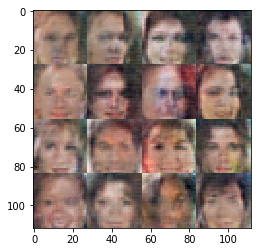

Epoch 1/2... Discriminator Loss: 1.2079... Generator Loss: 0.5821


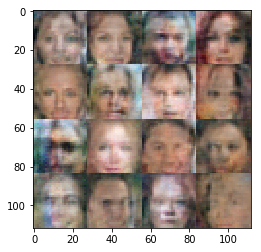

Epoch 1/2... Discriminator Loss: 1.3241... Generator Loss: 0.7119


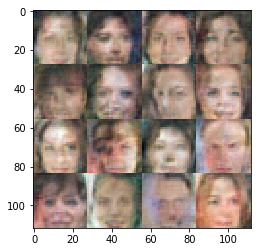

Epoch 1/2... Discriminator Loss: 1.5565... Generator Loss: 0.3273


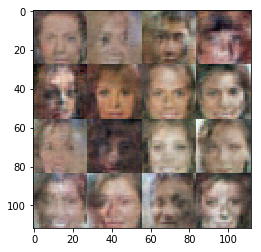

Epoch 1/2... Discriminator Loss: 1.0714... Generator Loss: 0.5105


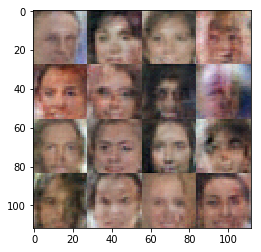

Epoch 1/2... Discriminator Loss: 1.0922... Generator Loss: 0.7016


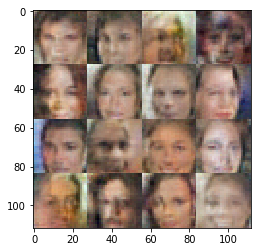

Epoch 1/2... Discriminator Loss: 1.4428... Generator Loss: 0.3468


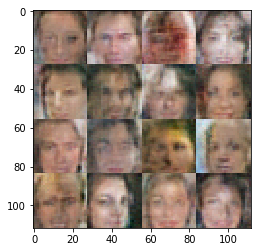

Epoch 1/2... Discriminator Loss: 0.4497... Generator Loss: 1.3714


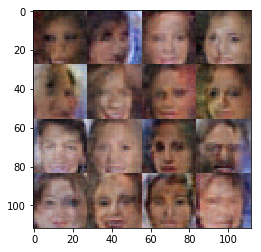

Epoch 1/2... Discriminator Loss: 1.1831... Generator Loss: 0.5350


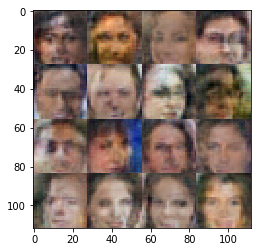

Epoch 1/2... Discriminator Loss: 0.8668... Generator Loss: 1.0300


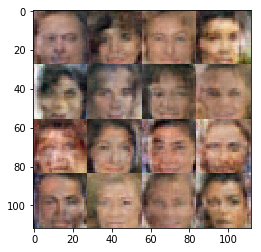

Epoch 1/2... Discriminator Loss: 0.3934... Generator Loss: 1.7947


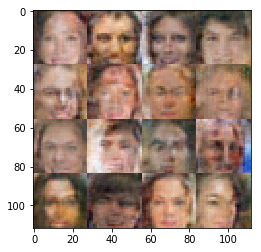

Epoch 1/2... Discriminator Loss: 1.5768... Generator Loss: 0.3050


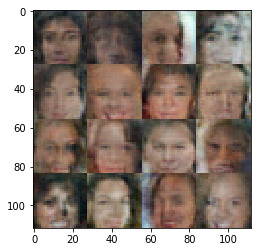

Epoch 2/2... Discriminator Loss: 1.2353... Generator Loss: 0.4518


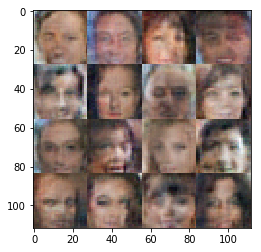

Epoch 2/2... Discriminator Loss: 1.2876... Generator Loss: 0.3936


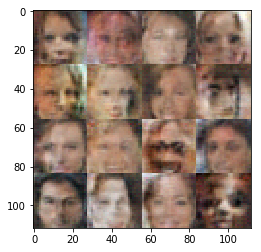

Epoch 2/2... Discriminator Loss: 1.2144... Generator Loss: 0.5850


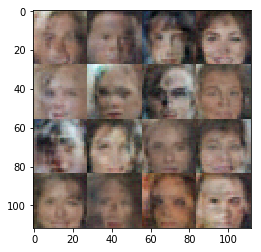

Epoch 2/2... Discriminator Loss: 0.5132... Generator Loss: 1.5842


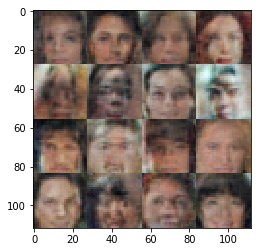

Epoch 2/2... Discriminator Loss: 1.7412... Generator Loss: 0.2686


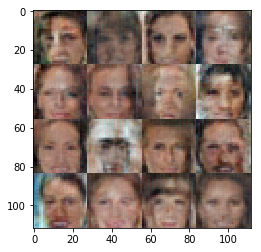

Epoch 2/2... Discriminator Loss: 0.7635... Generator Loss: 1.8079


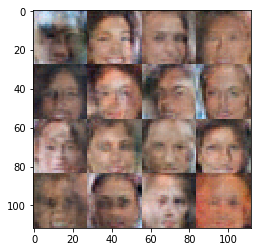

Epoch 2/2... Discriminator Loss: 1.4295... Generator Loss: 0.3893


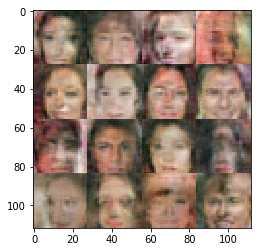

Epoch 2/2... Discriminator Loss: 1.1018... Generator Loss: 0.5263


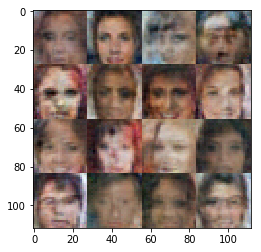

Epoch 2/2... Discriminator Loss: 1.0755... Generator Loss: 0.6923


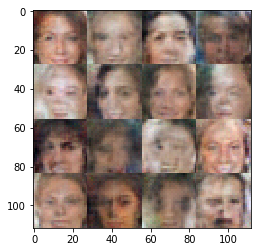

Epoch 2/2... Discriminator Loss: 1.2082... Generator Loss: 0.5553


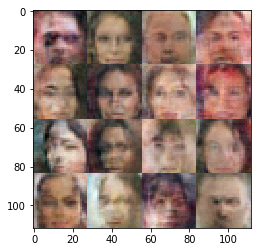

Epoch 2/2... Discriminator Loss: 0.9870... Generator Loss: 1.3316


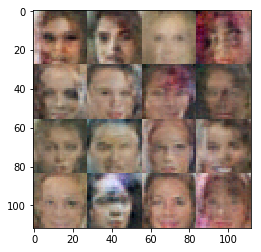

Epoch 2/2... Discriminator Loss: 1.3942... Generator Loss: 0.3724


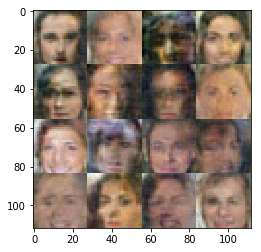

Epoch 2/2... Discriminator Loss: 1.1828... Generator Loss: 0.4917


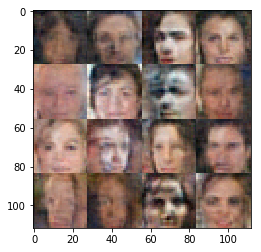

Epoch 2/2... Discriminator Loss: 1.3370... Generator Loss: 0.3702


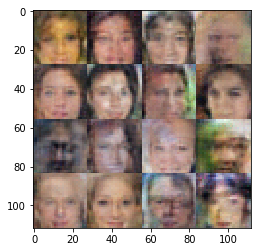

Epoch 2/2... Discriminator Loss: 0.6360... Generator Loss: 0.8912


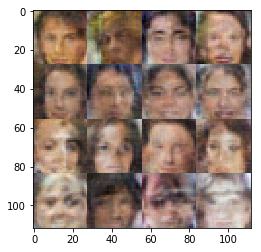

Epoch 2/2... Discriminator Loss: 2.5358... Generator Loss: 0.1070


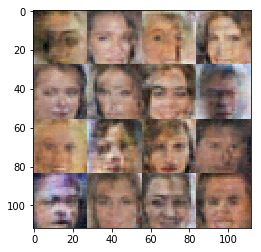

Epoch 2/2... Discriminator Loss: 0.6615... Generator Loss: 2.2101


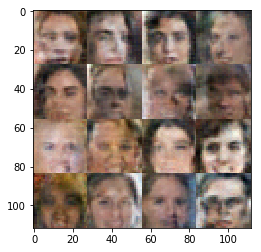

Epoch 2/2... Discriminator Loss: 1.2451... Generator Loss: 1.0273


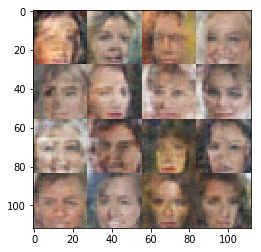

Epoch 2/2... Discriminator Loss: 0.3293... Generator Loss: 1.8389


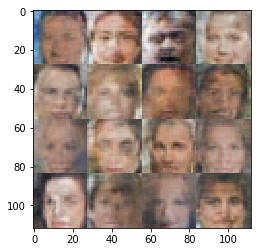

Epoch 2/2... Discriminator Loss: 0.5730... Generator Loss: 1.0020


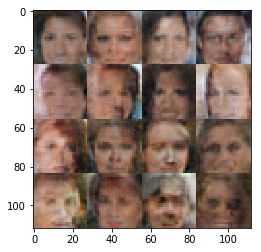

Epoch 2/2... Discriminator Loss: 0.6847... Generator Loss: 1.1568


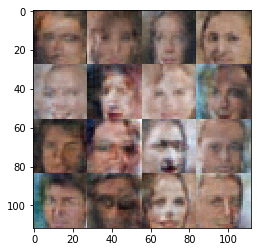

Epoch 2/2... Discriminator Loss: 1.7654... Generator Loss: 2.5824


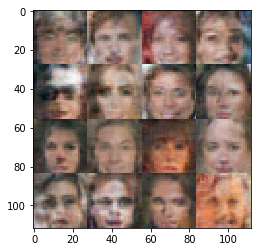

Epoch 2/2... Discriminator Loss: 0.6438... Generator Loss: 0.9628


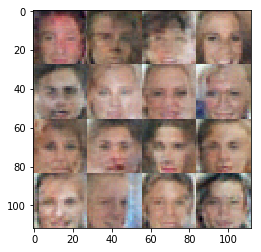

Epoch 2/2... Discriminator Loss: 1.5424... Generator Loss: 0.3268


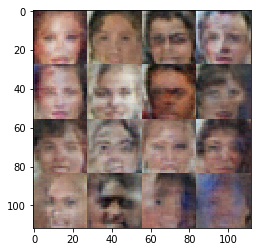

Epoch 2/2... Discriminator Loss: 1.2906... Generator Loss: 0.8810


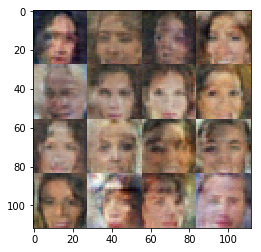

Epoch 2/2... Discriminator Loss: 0.5242... Generator Loss: 1.2874


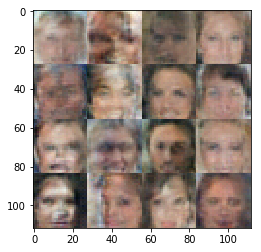

Epoch 2/2... Discriminator Loss: 0.9156... Generator Loss: 0.8550


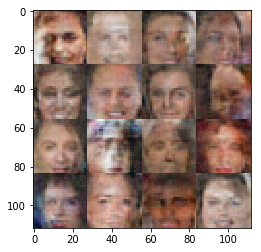

Epoch 2/2... Discriminator Loss: 0.9063... Generator Loss: 1.3263


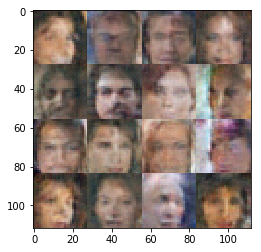

Epoch 2/2... Discriminator Loss: 1.0519... Generator Loss: 0.5896


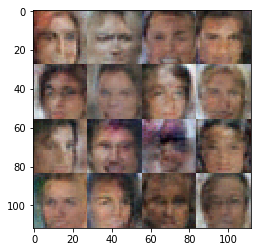

Epoch 2/2... Discriminator Loss: 2.2771... Generator Loss: 0.1410


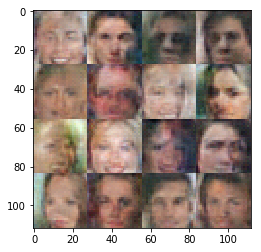

Epoch 2/2... Discriminator Loss: 0.1981... Generator Loss: 3.0001


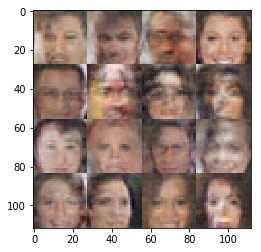

Epoch 2/2... Discriminator Loss: 3.0598... Generator Loss: 4.1015


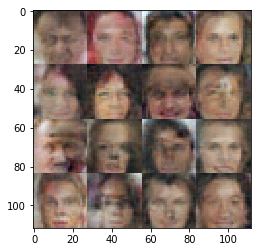

Epoch 2/2... Discriminator Loss: 0.6353... Generator Loss: 1.0720


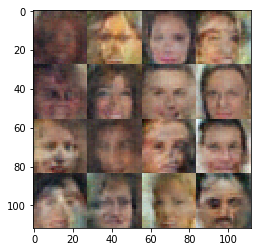

Epoch 2/2... Discriminator Loss: 1.3460... Generator Loss: 0.4946


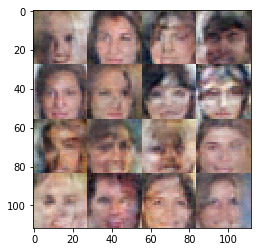

Epoch 2/2... Discriminator Loss: 0.9783... Generator Loss: 1.0797


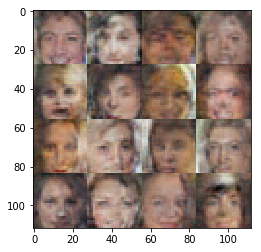

Epoch 2/2... Discriminator Loss: 1.7434... Generator Loss: 2.1406


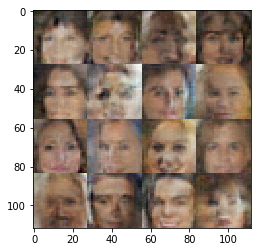

Epoch 2/2... Discriminator Loss: 1.1579... Generator Loss: 0.4930


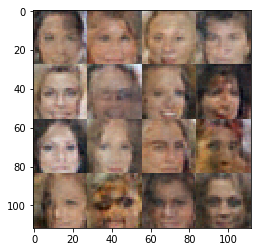

Epoch 2/2... Discriminator Loss: 0.8029... Generator Loss: 1.7020


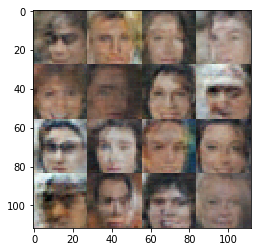

Epoch 2/2... Discriminator Loss: 0.9806... Generator Loss: 0.6420


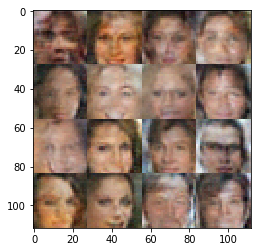

Epoch 2/2... Discriminator Loss: 1.2256... Generator Loss: 0.4534


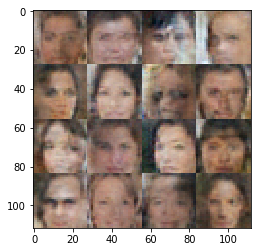

Epoch 2/2... Discriminator Loss: 1.3279... Generator Loss: 0.4298


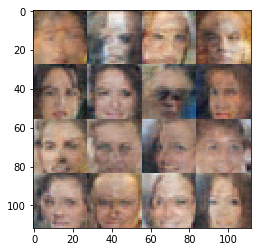

Epoch 2/2... Discriminator Loss: 1.5995... Generator Loss: 0.2906


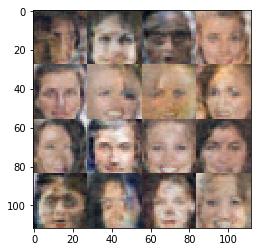

Epoch 2/2... Discriminator Loss: 0.3595... Generator Loss: 1.8381


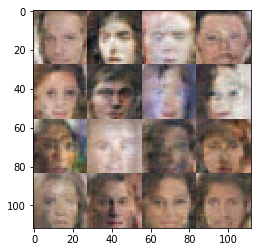

Epoch 2/2... Discriminator Loss: 1.6089... Generator Loss: 2.5774


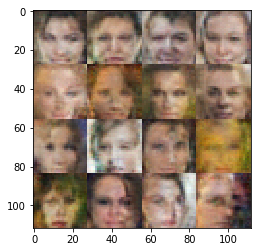

Epoch 2/2... Discriminator Loss: 1.1053... Generator Loss: 1.3411


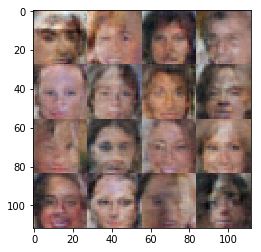

Epoch 2/2... Discriminator Loss: 1.2228... Generator Loss: 1.1506


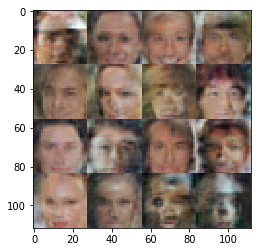

Epoch 2/2... Discriminator Loss: 1.4976... Generator Loss: 0.3325


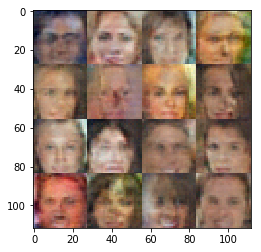

Epoch 2/2... Discriminator Loss: 1.0380... Generator Loss: 0.5614


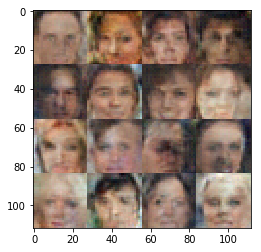

Epoch 2/2... Discriminator Loss: 1.5515... Generator Loss: 0.3047


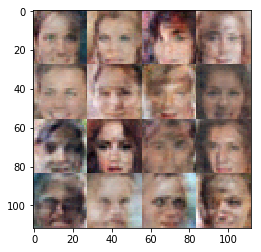

Epoch 2/2... Discriminator Loss: 0.8949... Generator Loss: 0.7714


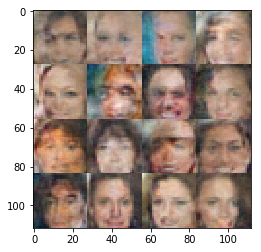

Epoch 2/2... Discriminator Loss: 0.6136... Generator Loss: 1.9782


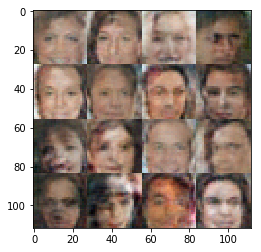

Epoch 2/2... Discriminator Loss: 1.2933... Generator Loss: 0.5064


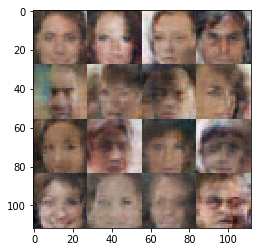

Epoch 2/2... Discriminator Loss: 0.7288... Generator Loss: 1.6378


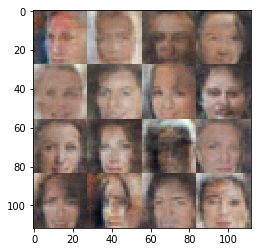

Epoch 2/2... Discriminator Loss: 0.4917... Generator Loss: 1.1024


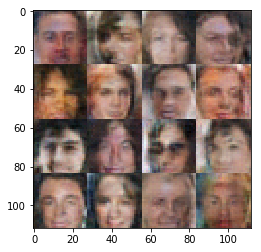

Epoch 2/2... Discriminator Loss: 1.2863... Generator Loss: 0.4300


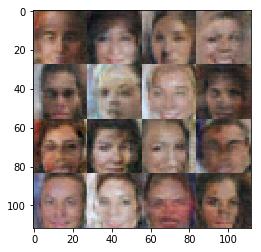

Epoch 2/2... Discriminator Loss: 1.9695... Generator Loss: 0.2190


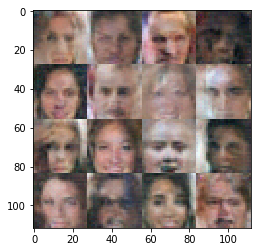

Epoch 2/2... Discriminator Loss: 1.2977... Generator Loss: 0.5092


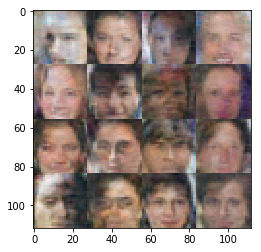

Epoch 2/2... Discriminator Loss: 1.7406... Generator Loss: 2.5422


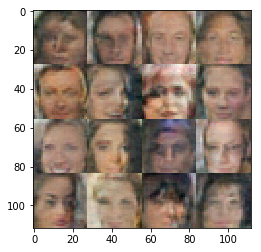

Epoch 2/2... Discriminator Loss: 0.7245... Generator Loss: 0.8438


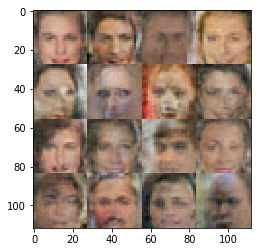

Epoch 2/2... Discriminator Loss: 1.0336... Generator Loss: 0.5455


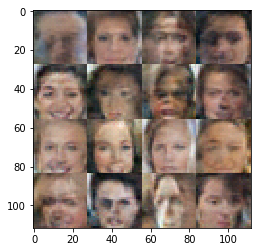

Epoch 2/2... Discriminator Loss: 1.0920... Generator Loss: 1.1844


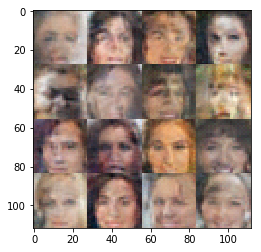

Epoch 2/2... Discriminator Loss: 1.0678... Generator Loss: 0.6903


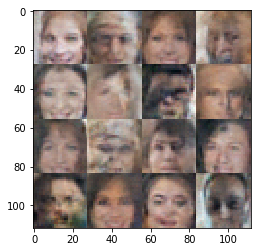

Epoch 2/2... Discriminator Loss: 1.2368... Generator Loss: 0.4519


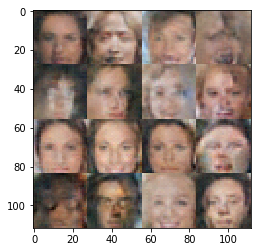

Epoch 2/2... Discriminator Loss: 1.8360... Generator Loss: 0.2220


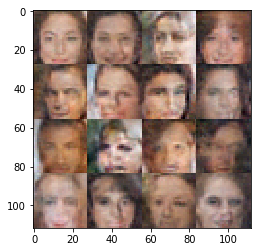

Epoch 2/2... Discriminator Loss: 0.8188... Generator Loss: 1.0912


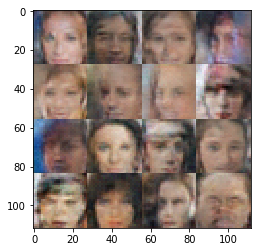

Epoch 2/2... Discriminator Loss: 0.5222... Generator Loss: 1.2505


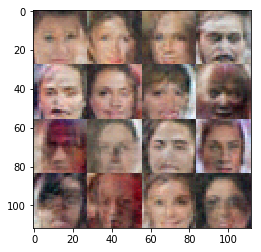

Epoch 2/2... Discriminator Loss: 0.9346... Generator Loss: 0.7768


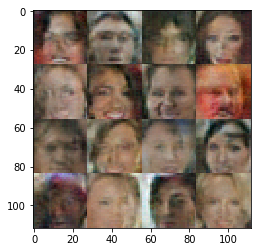

Epoch 2/2... Discriminator Loss: 1.3107... Generator Loss: 0.4825


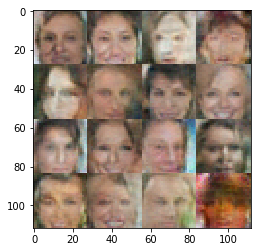

Epoch 2/2... Discriminator Loss: 1.1125... Generator Loss: 1.3489


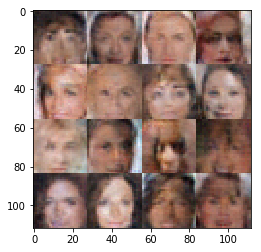

Epoch 2/2... Discriminator Loss: 1.1962... Generator Loss: 0.8380


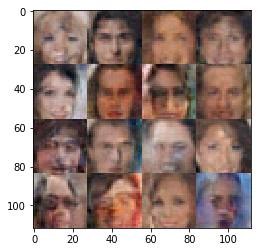

Epoch 2/2... Discriminator Loss: 0.9099... Generator Loss: 1.0670


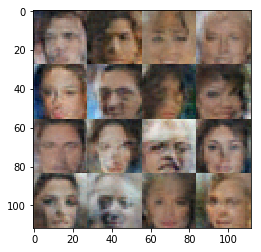

Epoch 2/2... Discriminator Loss: 1.2398... Generator Loss: 2.3170


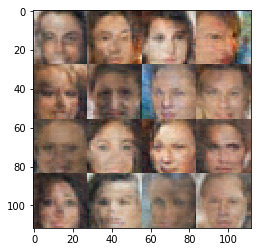

Epoch 2/2... Discriminator Loss: 1.8816... Generator Loss: 0.2031


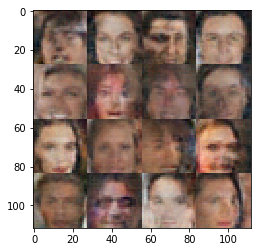

Epoch 2/2... Discriminator Loss: 1.1616... Generator Loss: 2.0512


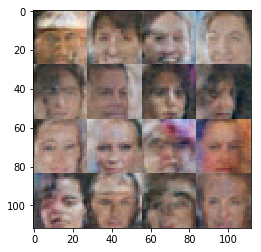

Epoch 2/2... Discriminator Loss: 0.8891... Generator Loss: 1.1340


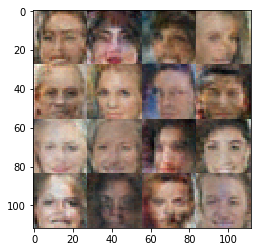

Epoch 2/2... Discriminator Loss: 0.8318... Generator Loss: 0.7406


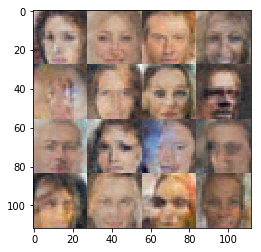

Epoch 2/2... Discriminator Loss: 2.1854... Generator Loss: 3.4305


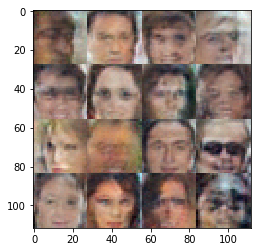

Epoch 2/2... Discriminator Loss: 1.6271... Generator Loss: 0.2966


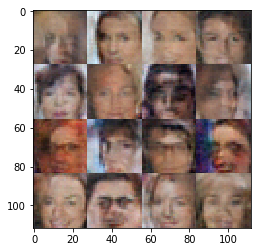

Epoch 2/2... Discriminator Loss: 1.1600... Generator Loss: 0.5676


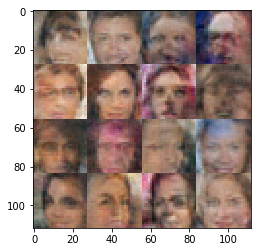

Epoch 2/2... Discriminator Loss: 0.5397... Generator Loss: 1.5164


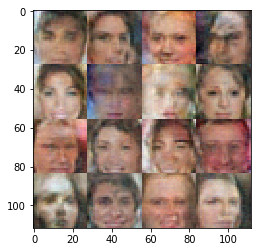

Epoch 2/2... Discriminator Loss: 2.0377... Generator Loss: 0.1704


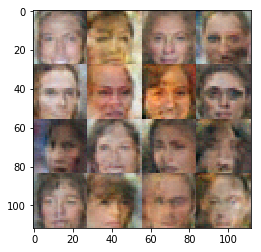

Epoch 2/2... Discriminator Loss: 0.8581... Generator Loss: 1.1460


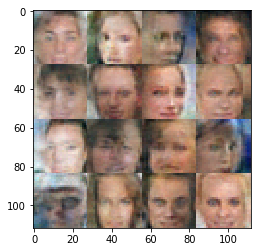

Epoch 2/2... Discriminator Loss: 0.8602... Generator Loss: 1.9195


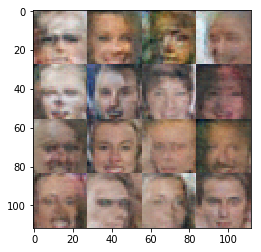

Epoch 2/2... Discriminator Loss: 1.0071... Generator Loss: 3.4298


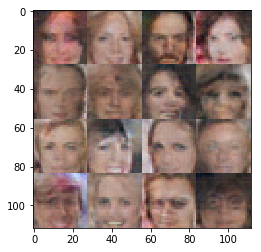

Epoch 2/2... Discriminator Loss: 0.3190... Generator Loss: 1.5075


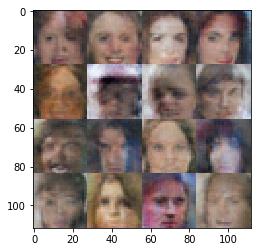

Epoch 2/2... Discriminator Loss: 0.9660... Generator Loss: 1.2155


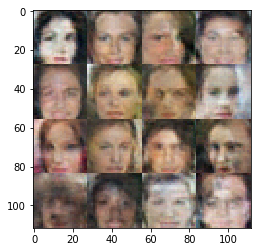

Epoch 2/2... Discriminator Loss: 0.7648... Generator Loss: 1.2785


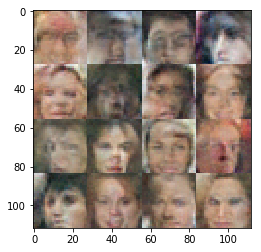

Epoch 2/2... Discriminator Loss: 2.0388... Generator Loss: 0.1829


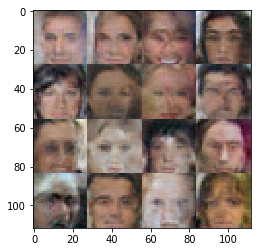

Epoch 2/2... Discriminator Loss: 1.6339... Generator Loss: 0.2918


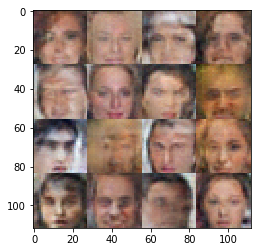

Epoch 2/2... Discriminator Loss: 0.9217... Generator Loss: 0.8268


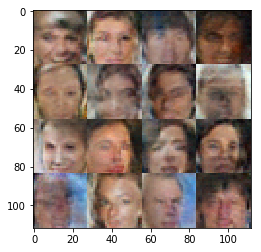

Epoch 2/2... Discriminator Loss: 1.5682... Generator Loss: 2.5218


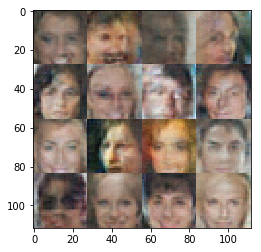

Epoch 2/2... Discriminator Loss: 0.4327... Generator Loss: 1.3512


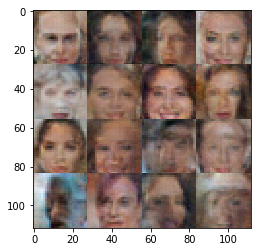

Epoch 2/2... Discriminator Loss: 1.1611... Generator Loss: 1.1489


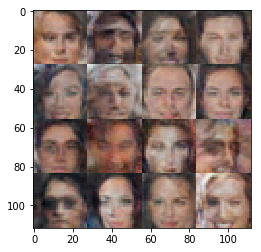

Epoch 2/2... Discriminator Loss: 1.7918... Generator Loss: 0.2422


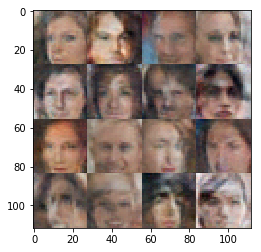

Epoch 2/2... Discriminator Loss: 1.4805... Generator Loss: 0.3396


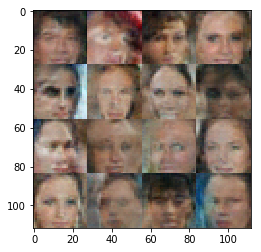

Epoch 2/2... Discriminator Loss: 0.7374... Generator Loss: 0.8365


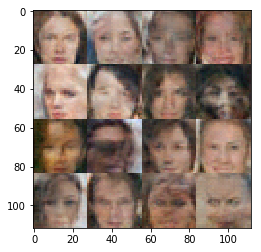

Epoch 2/2... Discriminator Loss: 1.6774... Generator Loss: 0.2654


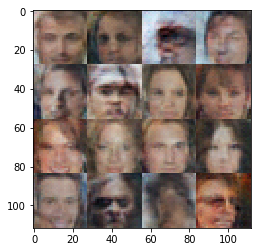

Epoch 2/2... Discriminator Loss: 0.7459... Generator Loss: 1.6230


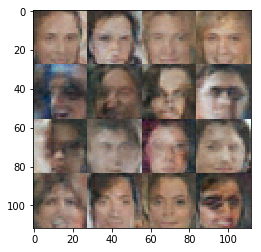

Epoch 2/2... Discriminator Loss: 0.6922... Generator Loss: 0.9459


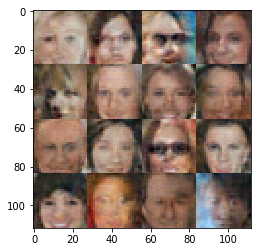

Epoch 2/2... Discriminator Loss: 0.9068... Generator Loss: 1.1125


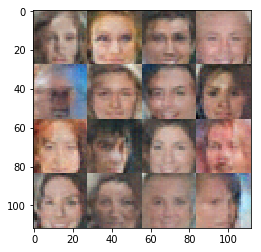

Epoch 2/2... Discriminator Loss: 0.7799... Generator Loss: 0.9551


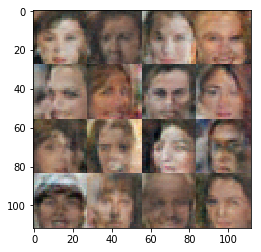

Epoch 2/2... Discriminator Loss: 0.5981... Generator Loss: 0.9949


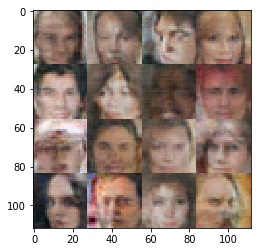

Epoch 2/2... Discriminator Loss: 1.5152... Generator Loss: 0.3867


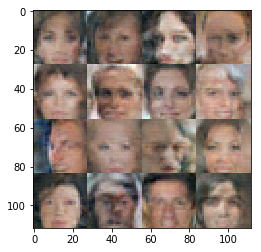

Epoch 2/2... Discriminator Loss: 1.1968... Generator Loss: 0.4638


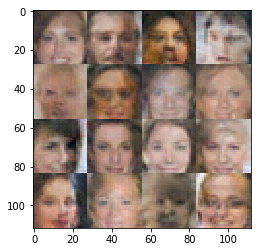

Epoch 2/2... Discriminator Loss: 0.7856... Generator Loss: 0.8443


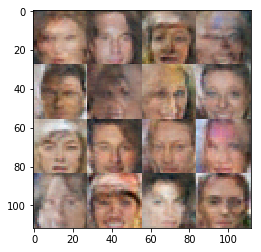

Epoch 2/2... Discriminator Loss: 1.5131... Generator Loss: 0.3223


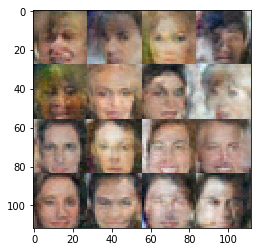

Epoch 2/2... Discriminator Loss: 1.6807... Generator Loss: 0.2750


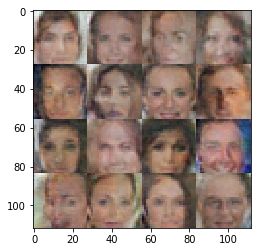

Epoch 2/2... Discriminator Loss: 0.6040... Generator Loss: 1.9635


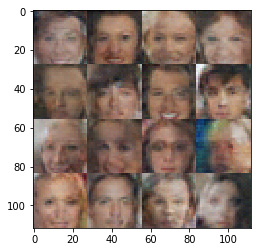

Epoch 2/2... Discriminator Loss: 1.2254... Generator Loss: 2.5619


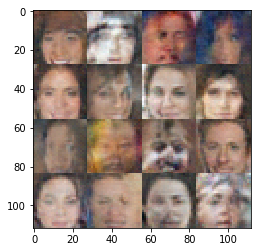

Epoch 2/2... Discriminator Loss: 1.9586... Generator Loss: 0.2326


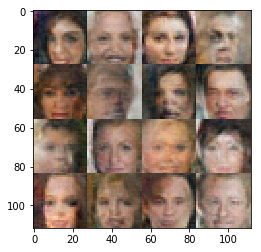

Epoch 2/2... Discriminator Loss: 1.4198... Generator Loss: 1.6270


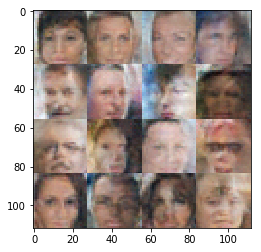

Epoch 2/2... Discriminator Loss: 0.3699... Generator Loss: 2.3521


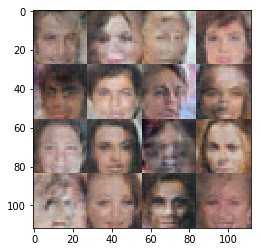

Epoch 2/2... Discriminator Loss: 1.0188... Generator Loss: 0.6344


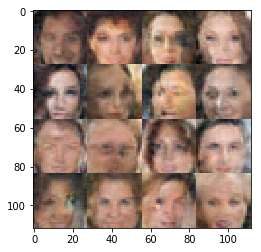

Epoch 2/2... Discriminator Loss: 1.6514... Generator Loss: 2.2900


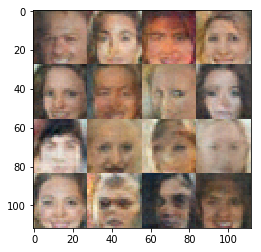

Epoch 2/2... Discriminator Loss: 1.4001... Generator Loss: 0.3667


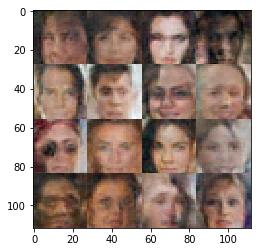

Epoch 2/2... Discriminator Loss: 1.5652... Generator Loss: 0.3067


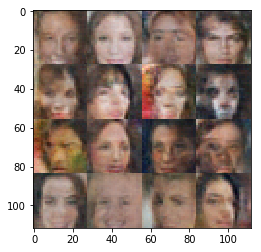

Epoch 2/2... Discriminator Loss: 0.7101... Generator Loss: 0.9527


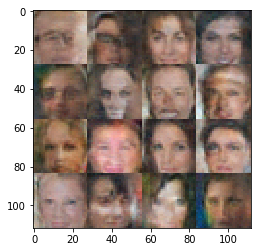

Epoch 2/2... Discriminator Loss: 0.3769... Generator Loss: 1.8612


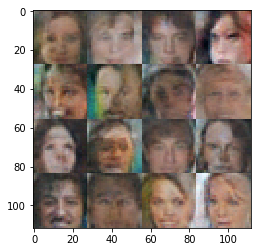

Epoch 2/2... Discriminator Loss: 0.1915... Generator Loss: 2.3329


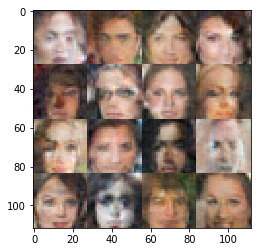

Epoch 2/2... Discriminator Loss: 2.3673... Generator Loss: 0.1219


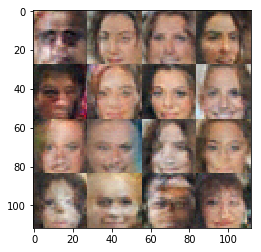

Epoch 2/2... Discriminator Loss: 0.9862... Generator Loss: 0.7717


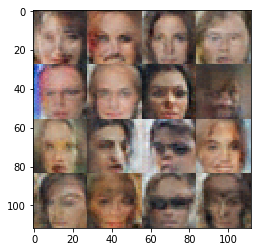

Epoch 2/2... Discriminator Loss: 0.7689... Generator Loss: 1.3144


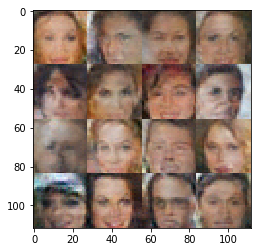

Epoch 2/2... Discriminator Loss: 1.7064... Generator Loss: 0.2692


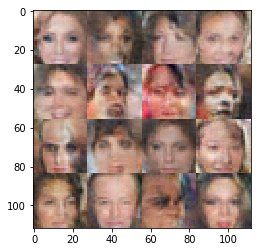

Epoch 2/2... Discriminator Loss: 0.7668... Generator Loss: 1.4410


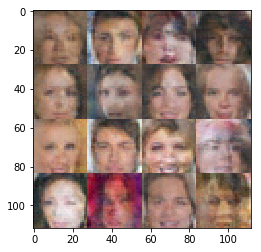

Epoch 2/2... Discriminator Loss: 0.4450... Generator Loss: 1.4916


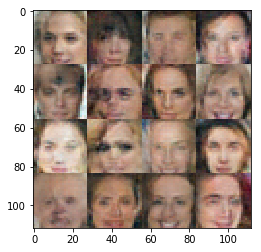

Epoch 2/2... Discriminator Loss: 0.4650... Generator Loss: 1.4878


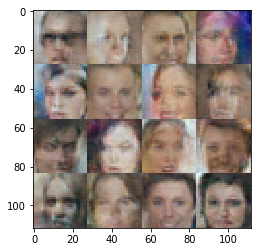

Epoch 2/2... Discriminator Loss: 1.2318... Generator Loss: 0.4462


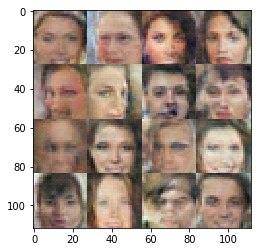

Epoch 2/2... Discriminator Loss: 0.5180... Generator Loss: 1.0915


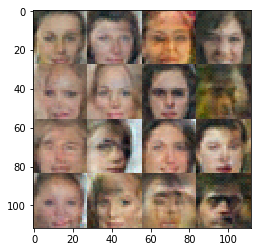

Epoch 2/2... Discriminator Loss: 0.7829... Generator Loss: 1.9876


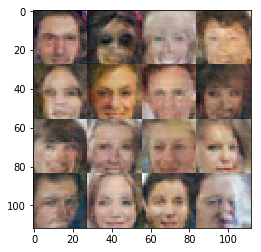

Epoch 2/2... Discriminator Loss: 1.9149... Generator Loss: 0.2254


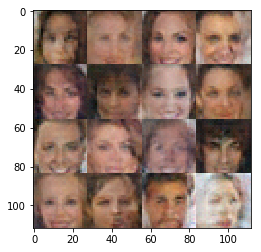

Epoch 2/2... Discriminator Loss: 1.4069... Generator Loss: 0.4104


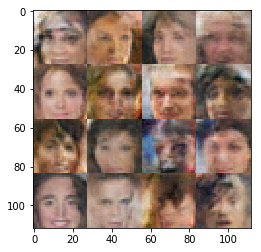

Epoch 2/2... Discriminator Loss: 1.4629... Generator Loss: 0.3464


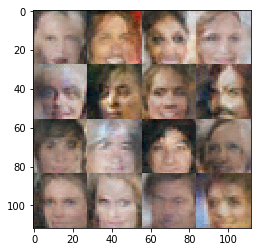

Epoch 2/2... Discriminator Loss: 1.3454... Generator Loss: 0.3707


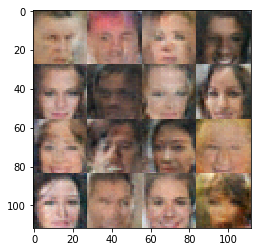

Epoch 2/2... Discriminator Loss: 2.3818... Generator Loss: 0.1506


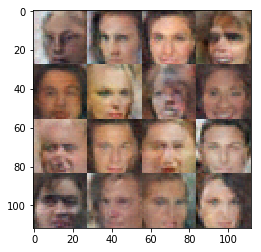

Epoch 2/2... Discriminator Loss: 0.8477... Generator Loss: 1.2043


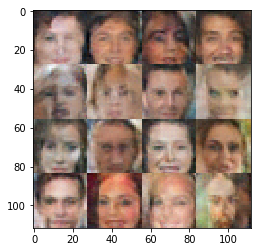

Epoch 2/2... Discriminator Loss: 0.7523... Generator Loss: 1.2928


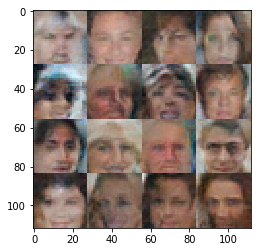

Epoch 2/2... Discriminator Loss: 1.2151... Generator Loss: 0.5165


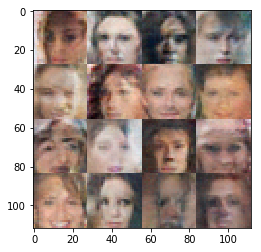

Epoch 2/2... Discriminator Loss: 0.6263... Generator Loss: 1.0014


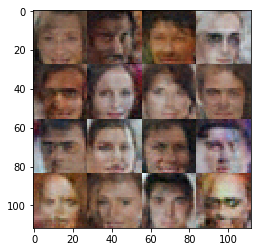

Epoch 2/2... Discriminator Loss: 1.2009... Generator Loss: 2.1174


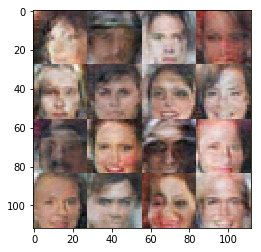

Epoch 2/2... Discriminator Loss: 0.8635... Generator Loss: 0.7093


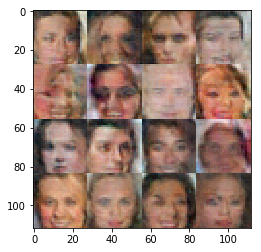

Epoch 2/2... Discriminator Loss: 0.2873... Generator Loss: 2.0701


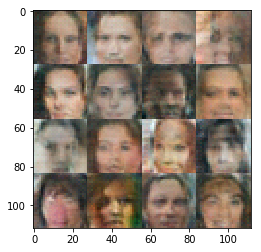

Epoch 2/2... Discriminator Loss: 1.0191... Generator Loss: 0.5792


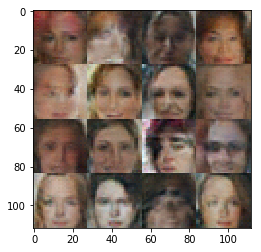

Epoch 2/2... Discriminator Loss: 1.2975... Generator Loss: 0.7098


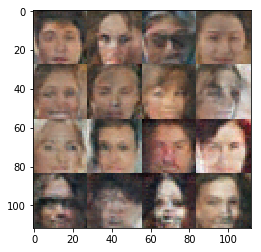

Epoch 2/2... Discriminator Loss: 1.0343... Generator Loss: 0.6508


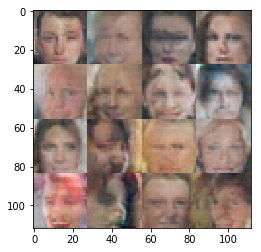

Epoch 2/2... Discriminator Loss: 2.0390... Generator Loss: 0.2066


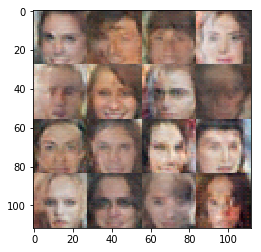

Epoch 2/2... Discriminator Loss: 0.9368... Generator Loss: 1.7604


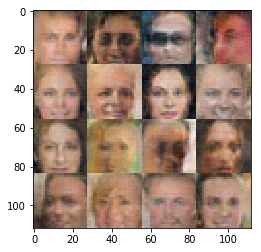

Epoch 2/2... Discriminator Loss: 2.6123... Generator Loss: 0.0974


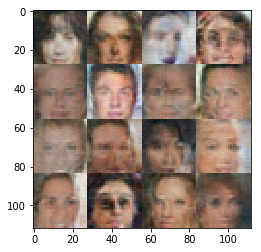

Epoch 2/2... Discriminator Loss: 1.8010... Generator Loss: 0.2503


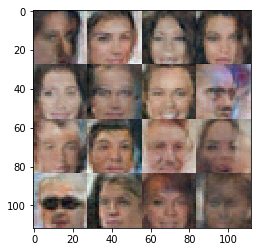

Epoch 2/2... Discriminator Loss: 1.6692... Generator Loss: 0.2822


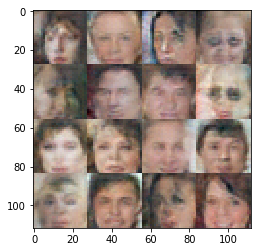

Epoch 2/2... Discriminator Loss: 1.0791... Generator Loss: 2.0099


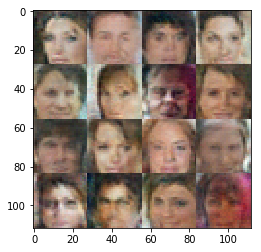

Epoch 2/2... Discriminator Loss: 0.7345... Generator Loss: 1.2399


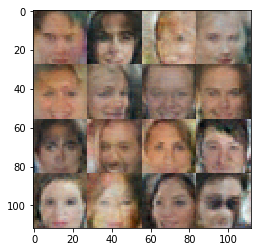

Epoch 2/2... Discriminator Loss: 0.7747... Generator Loss: 1.1724


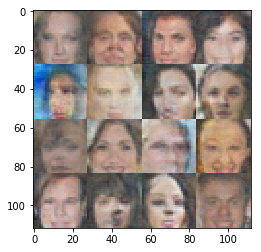

Epoch 2/2... Discriminator Loss: 1.1184... Generator Loss: 0.6488


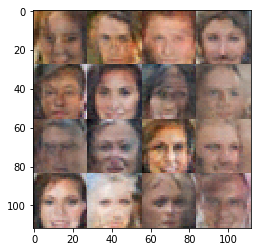

Epoch 2/2... Discriminator Loss: 1.6707... Generator Loss: 0.2945


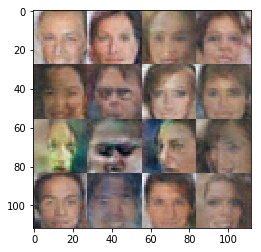

Epoch 2/2... Discriminator Loss: 0.3442... Generator Loss: 2.5329


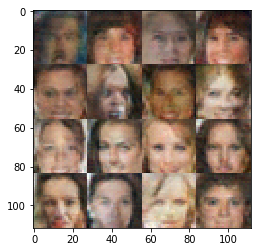

Epoch 2/2... Discriminator Loss: 1.1924... Generator Loss: 0.4560


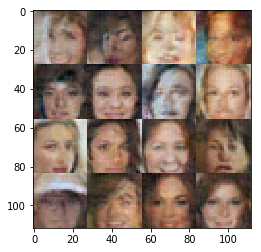

Epoch 2/2... Discriminator Loss: 1.1167... Generator Loss: 0.5101


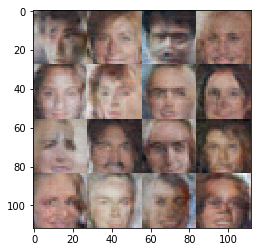

Epoch 2/2... Discriminator Loss: 1.2421... Generator Loss: 2.8878


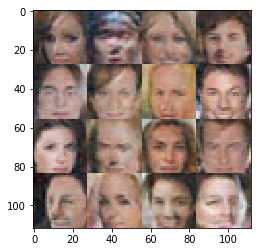

Epoch 2/2... Discriminator Loss: 1.4599... Generator Loss: 0.3603


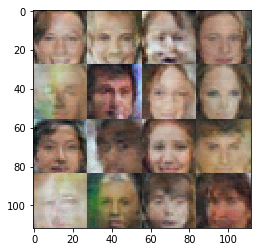

Epoch 2/2... Discriminator Loss: 0.2544... Generator Loss: 1.9268


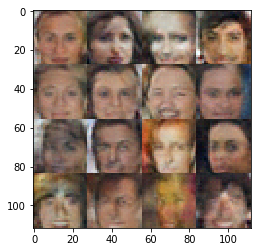

Epoch 2/2... Discriminator Loss: 1.0475... Generator Loss: 1.3328


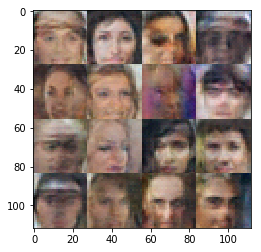

Epoch 2/2... Discriminator Loss: 0.6628... Generator Loss: 1.1932


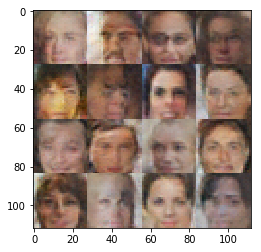

Epoch 2/2... Discriminator Loss: 0.2762... Generator Loss: 1.9649


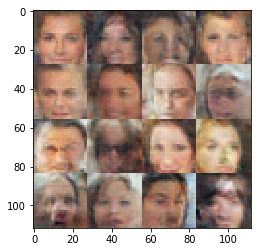

Epoch 2/2... Discriminator Loss: 1.6087... Generator Loss: 0.4076


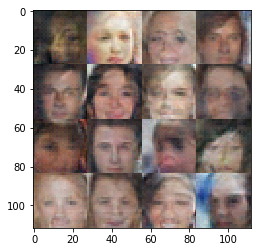

Epoch 2/2... Discriminator Loss: 0.3364... Generator Loss: 1.7219


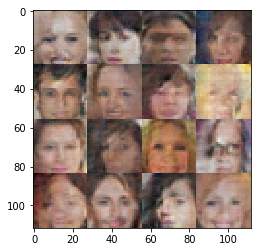

Epoch 2/2... Discriminator Loss: 1.0619... Generator Loss: 2.3855


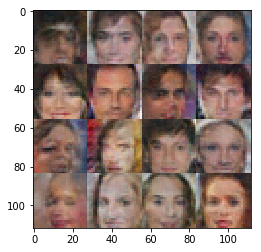

Epoch 2/2... Discriminator Loss: 1.3472... Generator Loss: 0.5078


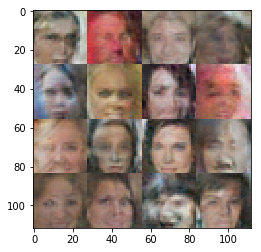

Epoch 2/2... Discriminator Loss: 0.6418... Generator Loss: 0.9210


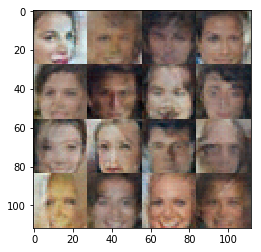

Epoch 2/2... Discriminator Loss: 1.1004... Generator Loss: 1.4857


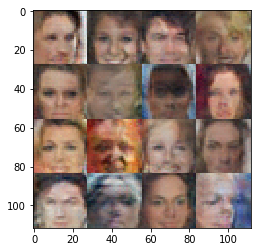

Epoch 2/2... Discriminator Loss: 1.4527... Generator Loss: 0.3642


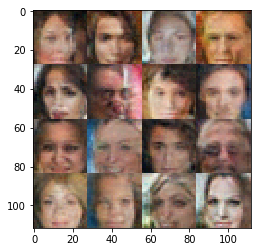

Epoch 2/2... Discriminator Loss: 0.8623... Generator Loss: 4.4302


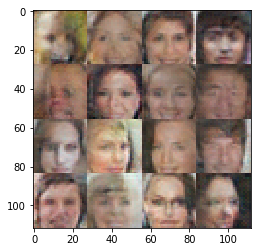

Epoch 2/2... Discriminator Loss: 1.1964... Generator Loss: 0.4840


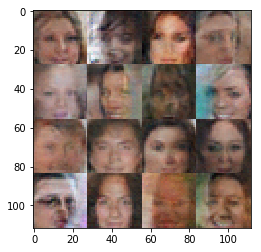

Epoch 2/2... Discriminator Loss: 1.4148... Generator Loss: 0.4217


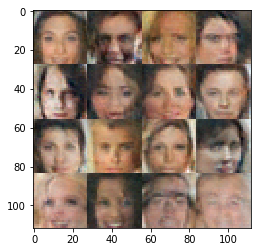

Epoch 2/2... Discriminator Loss: 0.8015... Generator Loss: 0.8391


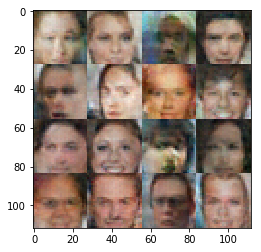

Epoch 2/2... Discriminator Loss: 1.6653... Generator Loss: 0.2634


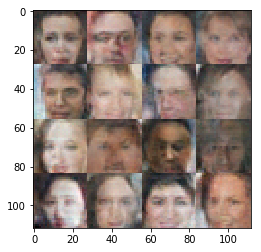

Epoch 2/2... Discriminator Loss: 0.8884... Generator Loss: 1.0362


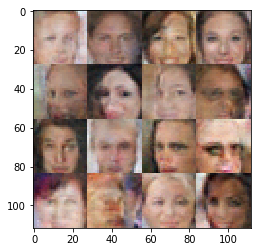

Epoch 2/2... Discriminator Loss: 1.1598... Generator Loss: 0.5108


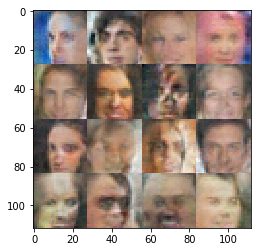

Epoch 2/2... Discriminator Loss: 2.0791... Generator Loss: 0.2069


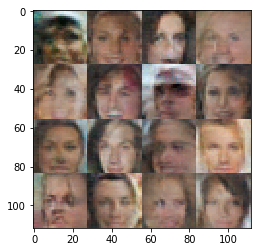

Epoch 2/2... Discriminator Loss: 1.3204... Generator Loss: 0.4056


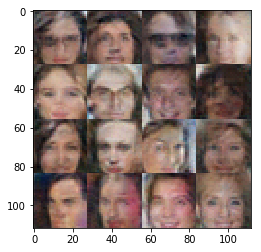

Epoch 2/2... Discriminator Loss: 1.2539... Generator Loss: 0.5209


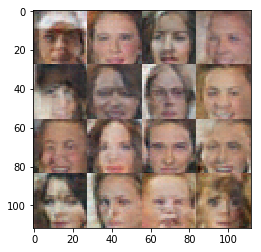

Epoch 2/2... Discriminator Loss: 0.7530... Generator Loss: 1.1653


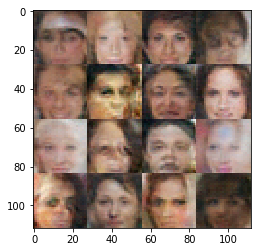

Epoch 2/2... Discriminator Loss: 2.1839... Generator Loss: 3.6884


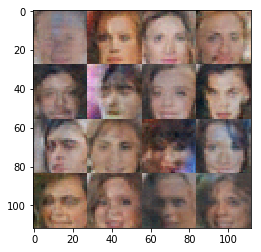

Epoch 2/2... Discriminator Loss: 0.9946... Generator Loss: 0.7983


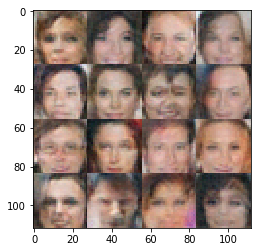

Epoch 2/2... Discriminator Loss: 0.7561... Generator Loss: 1.0188


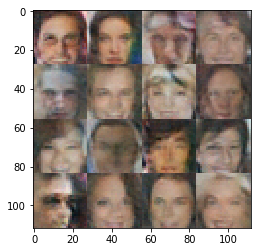

Epoch 2/2... Discriminator Loss: 0.4196... Generator Loss: 1.3993


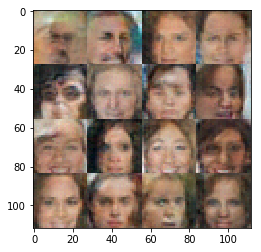

Epoch 2/2... Discriminator Loss: 1.8320... Generator Loss: 0.2300


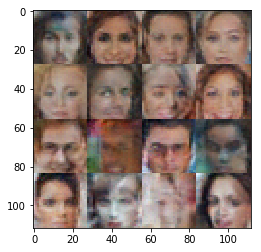

Epoch 2/2... Discriminator Loss: 0.9988... Generator Loss: 0.7875


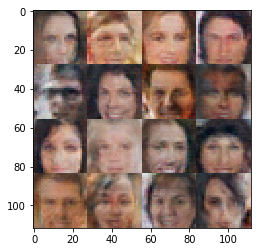

Epoch 2/2... Discriminator Loss: 0.5713... Generator Loss: 1.0603


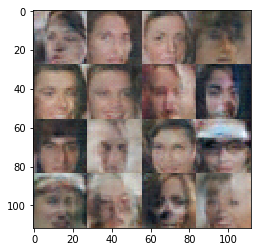

Epoch 2/2... Discriminator Loss: 1.1095... Generator Loss: 2.8714


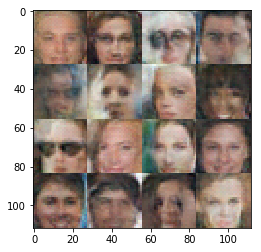

Epoch 2/2... Discriminator Loss: 1.8925... Generator Loss: 0.2006


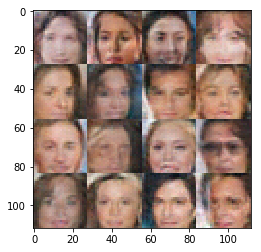

Epoch 2/2... Discriminator Loss: 0.9545... Generator Loss: 1.4449


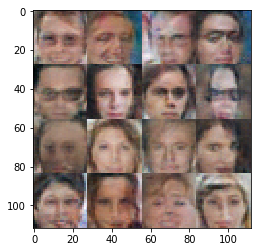

Epoch 2/2... Discriminator Loss: 1.5765... Generator Loss: 0.2983


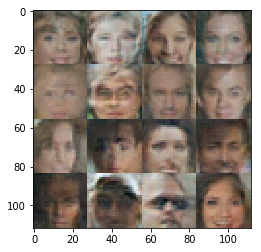

Epoch 2/2... Discriminator Loss: 1.9958... Generator Loss: 0.1842


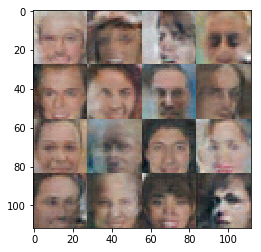

Epoch 2/2... Discriminator Loss: 2.6203... Generator Loss: 0.1137


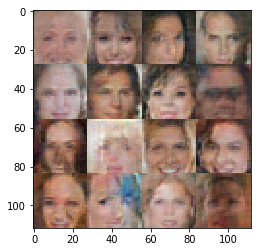

Epoch 2/2... Discriminator Loss: 0.7514... Generator Loss: 0.8678


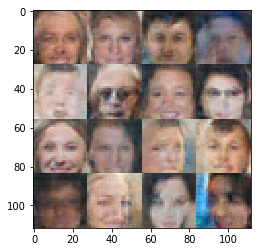

Epoch 2/2... Discriminator Loss: 0.8476... Generator Loss: 0.6867


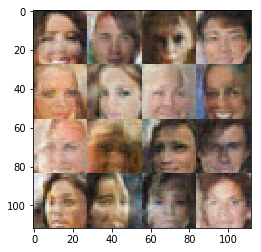

Epoch 2/2... Discriminator Loss: 0.5887... Generator Loss: 1.1917


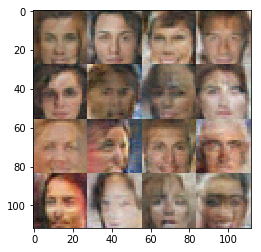

Epoch 2/2... Discriminator Loss: 1.0817... Generator Loss: 0.7690


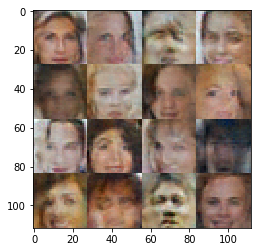

Epoch 2/2... Discriminator Loss: 0.9234... Generator Loss: 0.7309


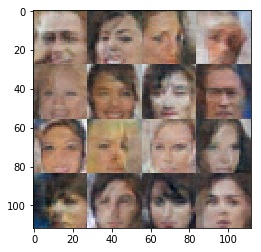

Epoch 2/2... Discriminator Loss: 0.9085... Generator Loss: 0.6770


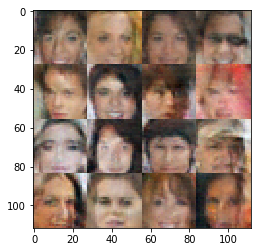

Epoch 2/2... Discriminator Loss: 1.7453... Generator Loss: 0.2842


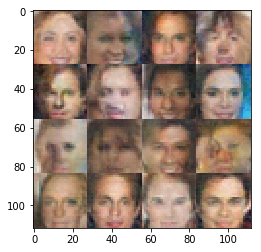

Epoch 2/2... Discriminator Loss: 0.7169... Generator Loss: 1.0633


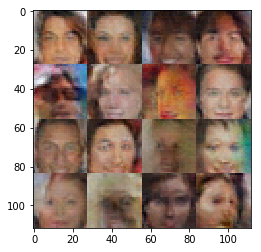

Epoch 2/2... Discriminator Loss: 2.2451... Generator Loss: 4.0774


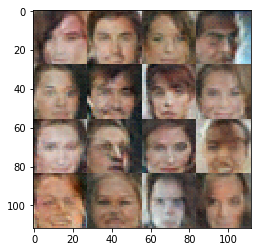

Epoch 2/2... Discriminator Loss: 1.2840... Generator Loss: 0.4759


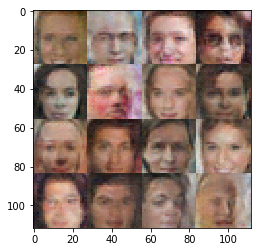

Epoch 2/2... Discriminator Loss: 1.7870... Generator Loss: 0.2439


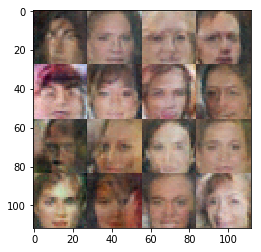

Epoch 2/2... Discriminator Loss: 1.8234... Generator Loss: 0.3144


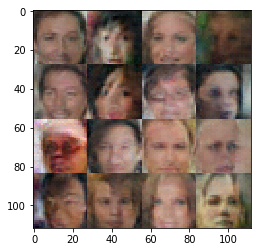

Epoch 2/2... Discriminator Loss: 1.1498... Generator Loss: 0.6169


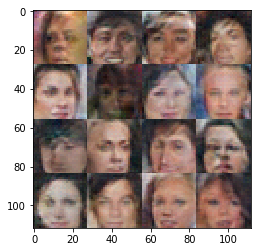

Epoch 2/2... Discriminator Loss: 0.6676... Generator Loss: 2.8991


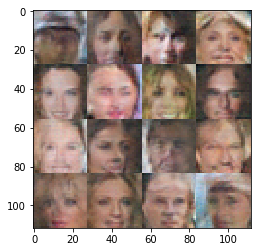

Epoch 2/2... Discriminator Loss: 2.4693... Generator Loss: 0.1215


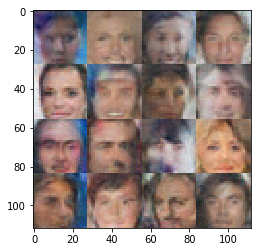

Epoch 2/2... Discriminator Loss: 1.8141... Generator Loss: 0.2446


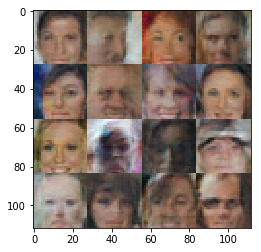

Epoch 2/2... Discriminator Loss: 1.2311... Generator Loss: 0.4797


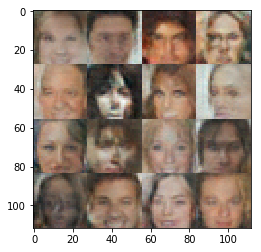

Epoch 2/2... Discriminator Loss: 1.6063... Generator Loss: 0.3131


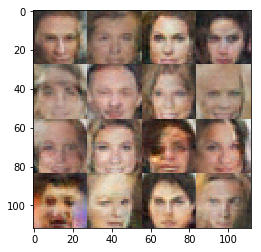

Epoch 2/2... Discriminator Loss: 1.5346... Generator Loss: 0.3026


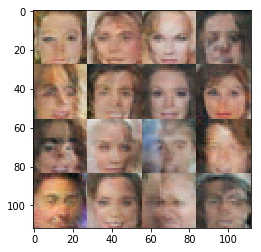

Epoch 2/2... Discriminator Loss: 0.7735... Generator Loss: 1.2414


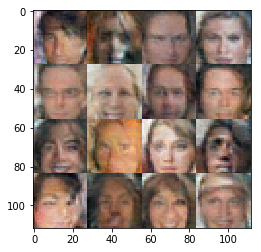

Epoch 2/2... Discriminator Loss: 1.4329... Generator Loss: 0.3750


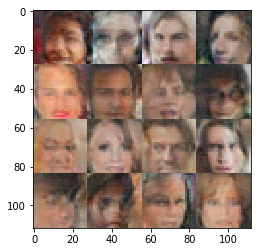

Epoch 2/2... Discriminator Loss: 0.9500... Generator Loss: 0.7242


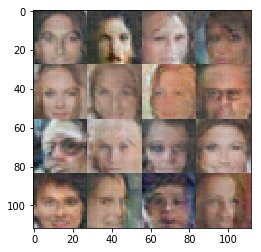

Epoch 2/2... Discriminator Loss: 1.0936... Generator Loss: 1.2021


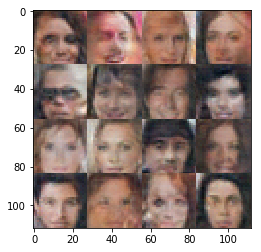

Epoch 2/2... Discriminator Loss: 0.6155... Generator Loss: 0.9681


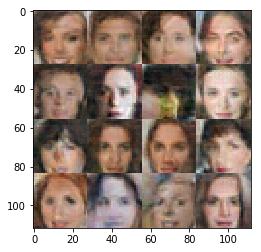

Epoch 2/2... Discriminator Loss: 1.8723... Generator Loss: 0.2616


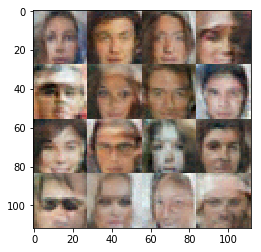

Epoch 2/2... Discriminator Loss: 0.9638... Generator Loss: 0.9406


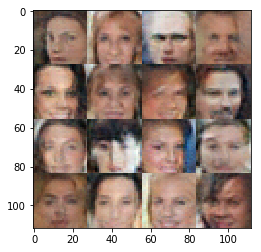

Epoch 2/2... Discriminator Loss: 0.9009... Generator Loss: 0.8998


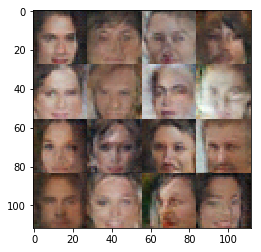

Epoch 2/2... Discriminator Loss: 1.1203... Generator Loss: 0.5132


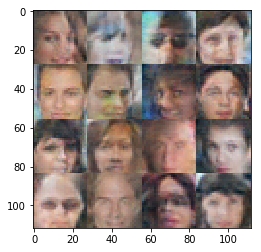

Epoch 2/2... Discriminator Loss: 0.4190... Generator Loss: 2.6266


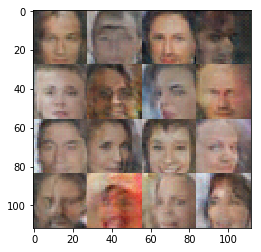

Epoch 2/2... Discriminator Loss: 0.2099... Generator Loss: 2.0362


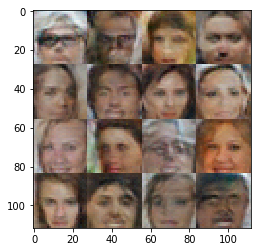

Epoch 2/2... Discriminator Loss: 0.4391... Generator Loss: 1.6753


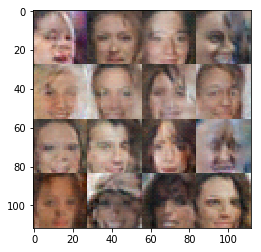

Epoch 2/2... Discriminator Loss: 1.2760... Generator Loss: 1.7285


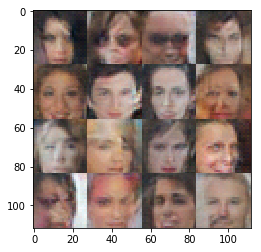

Epoch 2/2... Discriminator Loss: 0.8779... Generator Loss: 0.7943


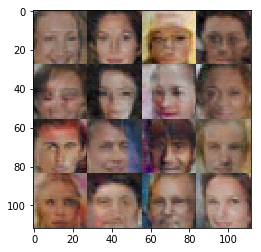

Epoch 2/2... Discriminator Loss: 2.1654... Generator Loss: 0.1674


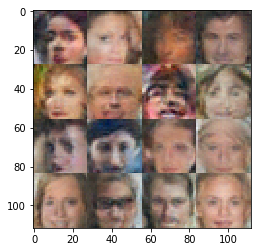

Epoch 2/2... Discriminator Loss: 0.5932... Generator Loss: 3.4567


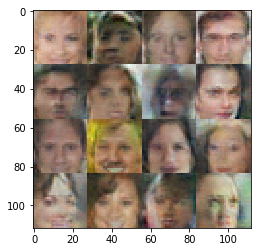

Epoch 2/2... Discriminator Loss: 0.7952... Generator Loss: 0.7586


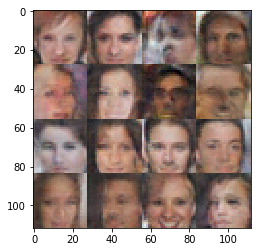

Epoch 2/2... Discriminator Loss: 0.2710... Generator Loss: 1.8720


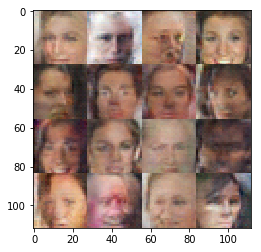

Epoch 2/2... Discriminator Loss: 1.2120... Generator Loss: 2.3681


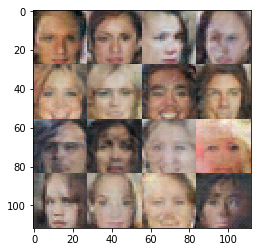

Epoch 2/2... Discriminator Loss: 0.9694... Generator Loss: 0.8069


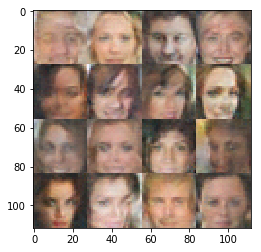

Epoch 2/2... Discriminator Loss: 2.0272... Generator Loss: 0.1849


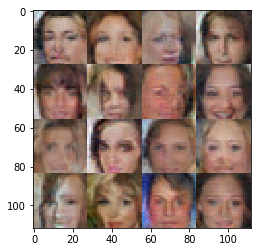

Epoch 2/2... Discriminator Loss: 0.6813... Generator Loss: 1.6121


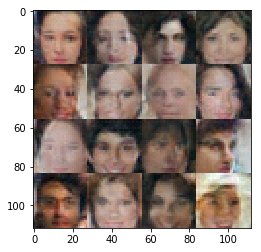

Epoch 2/2... Discriminator Loss: 0.2418... Generator Loss: 1.8966


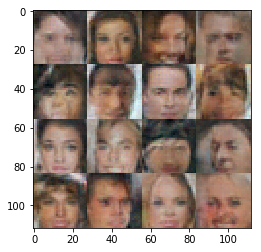

Epoch 2/2... Discriminator Loss: 0.4488... Generator Loss: 2.3633


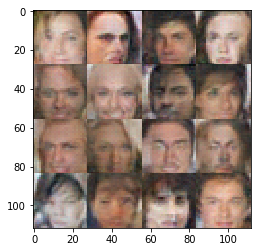

Epoch 2/2... Discriminator Loss: 0.8260... Generator Loss: 1.9370


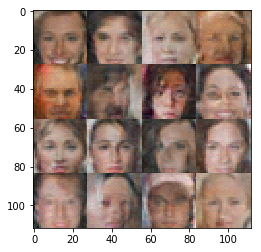

Epoch 2/2... Discriminator Loss: 1.2389... Generator Loss: 0.4769


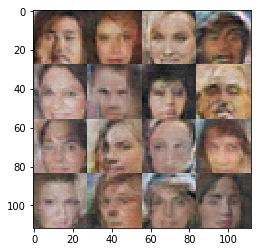

Epoch 2/2... Discriminator Loss: 0.7600... Generator Loss: 1.1748


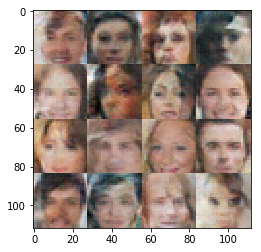

Epoch 2/2... Discriminator Loss: 0.4558... Generator Loss: 2.2407


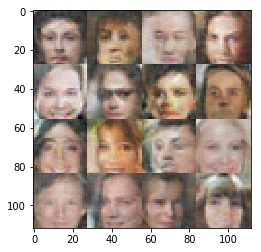

Epoch 2/2... Discriminator Loss: 2.6696... Generator Loss: 0.1106


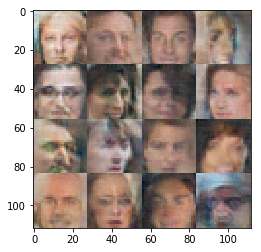

Epoch 2/2... Discriminator Loss: 1.2495... Generator Loss: 0.4336


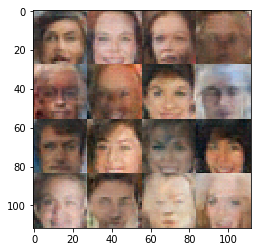

Epoch 2/2... Discriminator Loss: 1.0704... Generator Loss: 0.5674


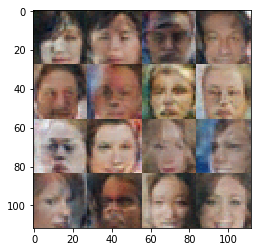

Epoch 2/2... Discriminator Loss: 0.4564... Generator Loss: 1.3098


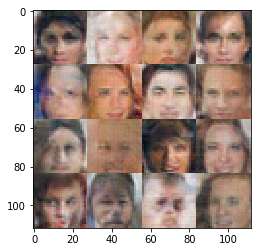

Epoch 2/2... Discriminator Loss: 0.7272... Generator Loss: 1.4797


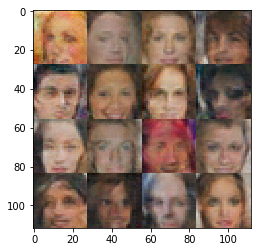

Epoch 2/2... Discriminator Loss: 0.8104... Generator Loss: 1.6582


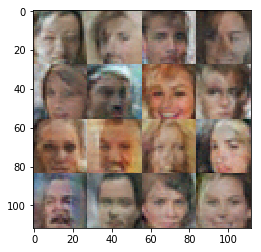

Epoch 2/2... Discriminator Loss: 0.9824... Generator Loss: 0.6749


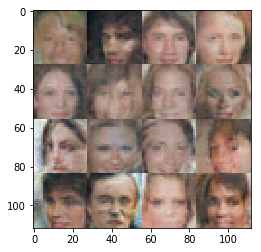

Epoch 2/2... Discriminator Loss: 0.7311... Generator Loss: 0.9922


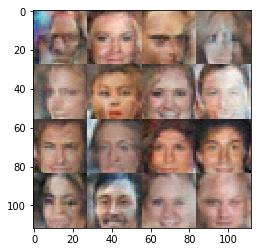

Epoch 2/2... Discriminator Loss: 0.2049... Generator Loss: 2.6900


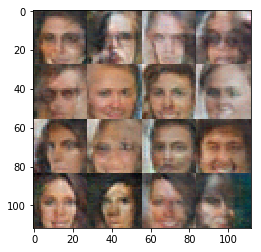

Epoch 2/2... Discriminator Loss: 3.1453... Generator Loss: 0.0653


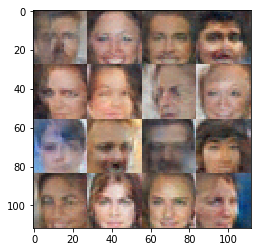

Epoch 2/2... Discriminator Loss: 0.9453... Generator Loss: 0.9615


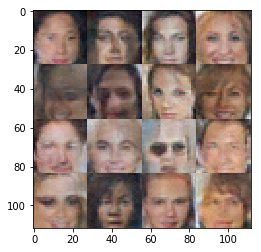

Epoch 2/2... Discriminator Loss: 0.7264... Generator Loss: 1.1406


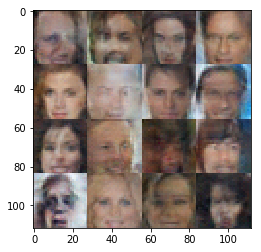

Epoch 2/2... Discriminator Loss: 2.0984... Generator Loss: 0.1853


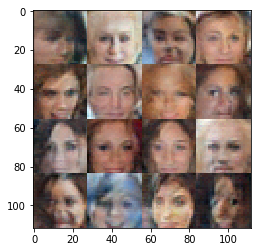

Epoch 2/2... Discriminator Loss: 0.6997... Generator Loss: 1.1450


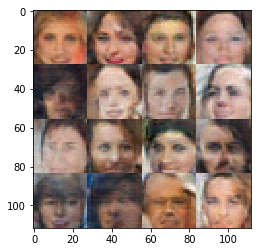

Epoch 2/2... Discriminator Loss: 0.8939... Generator Loss: 0.7541


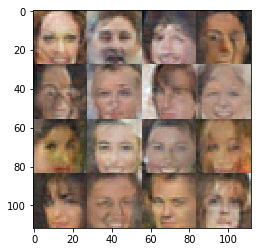

Epoch 2/2... Discriminator Loss: 0.7545... Generator Loss: 1.1559


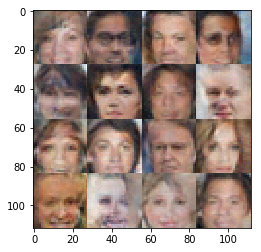

Epoch 2/2... Discriminator Loss: 0.6782... Generator Loss: 1.3315


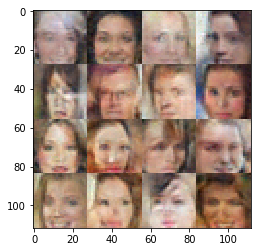

Epoch 2/2... Discriminator Loss: 0.4149... Generator Loss: 1.3556


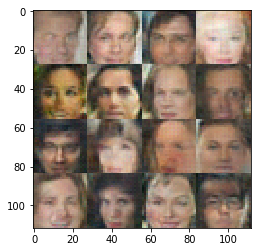

Epoch 2/2... Discriminator Loss: 2.6670... Generator Loss: 4.6748


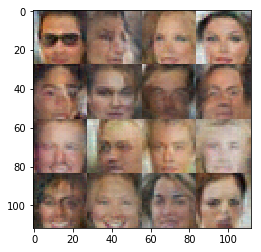

Epoch 2/2... Discriminator Loss: 1.4163... Generator Loss: 0.4146


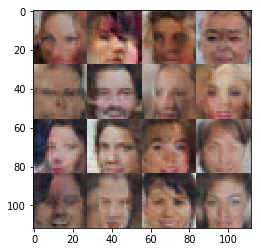

Epoch 2/2... Discriminator Loss: 0.4754... Generator Loss: 1.2501


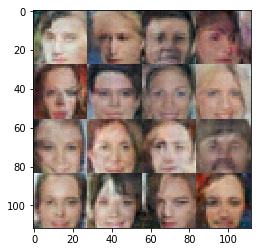

Epoch 2/2... Discriminator Loss: 0.4959... Generator Loss: 1.3076


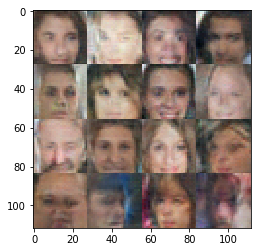

Epoch 2/2... Discriminator Loss: 1.8153... Generator Loss: 0.2266


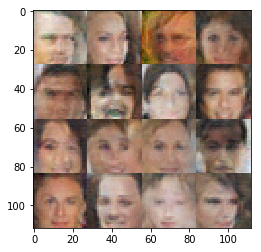

Epoch 2/2... Discriminator Loss: 0.9470... Generator Loss: 0.7592


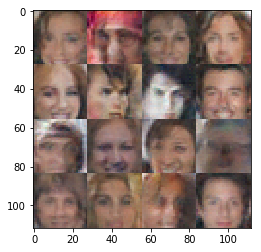

Epoch 2/2... Discriminator Loss: 0.8754... Generator Loss: 0.9449


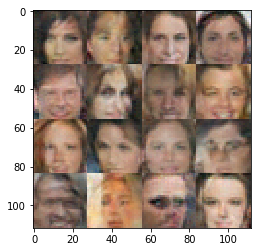

Epoch 2/2... Discriminator Loss: 2.4192... Generator Loss: 0.1459


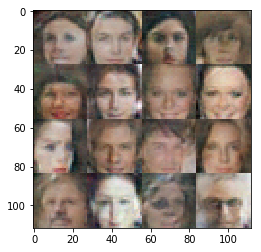

Epoch 2/2... Discriminator Loss: 1.4956... Generator Loss: 0.3322


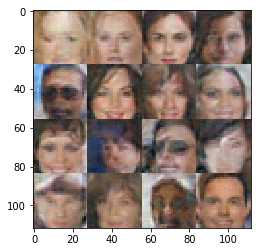

Epoch 2/2... Discriminator Loss: 0.9592... Generator Loss: 2.2708


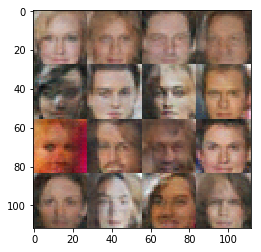

Epoch 2/2... Discriminator Loss: 0.8872... Generator Loss: 1.1393


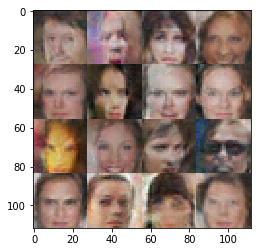

Epoch 2/2... Discriminator Loss: 0.7187... Generator Loss: 0.8796


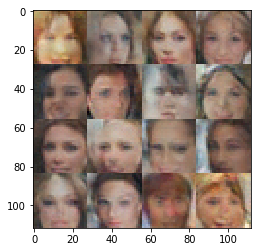

Epoch 2/2... Discriminator Loss: 0.8035... Generator Loss: 2.0939


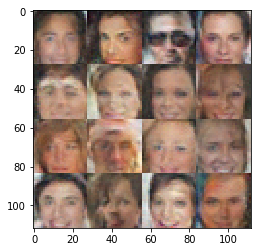

Epoch 2/2... Discriminator Loss: 0.9789... Generator Loss: 0.8628


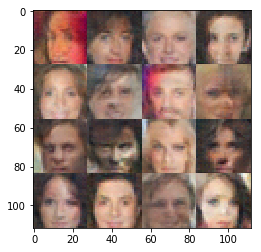

Epoch 2/2... Discriminator Loss: 0.7869... Generator Loss: 1.0742


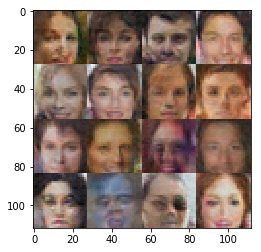

Epoch 2/2... Discriminator Loss: 0.7278... Generator Loss: 0.9143


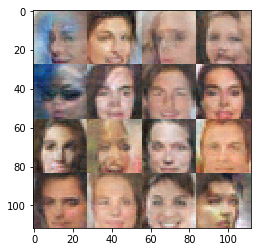

Epoch 2/2... Discriminator Loss: 0.1698... Generator Loss: 2.0749


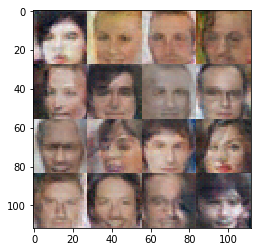

Epoch 2/2... Discriminator Loss: 0.8027... Generator Loss: 0.7591


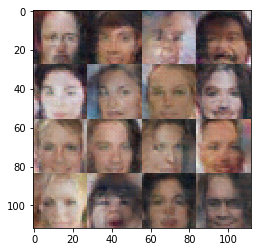

Epoch 2/2... Discriminator Loss: 1.3222... Generator Loss: 2.0423


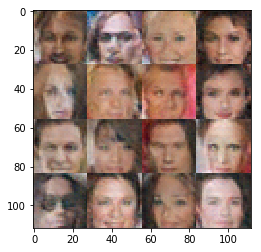

Epoch 2/2... Discriminator Loss: 0.9690... Generator Loss: 2.4504


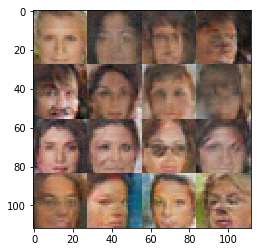

Epoch 2/2... Discriminator Loss: 0.7213... Generator Loss: 0.9661


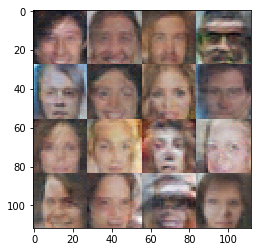

Epoch 2/2... Discriminator Loss: 0.8458... Generator Loss: 0.8015


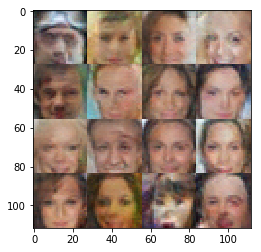

Epoch 2/2... Discriminator Loss: 1.4371... Generator Loss: 0.3662


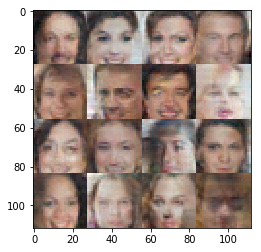

Epoch 2/2... Discriminator Loss: 0.5209... Generator Loss: 1.2842


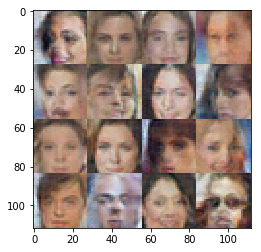

Epoch 2/2... Discriminator Loss: 1.7736... Generator Loss: 2.7544


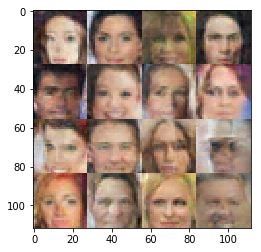

Epoch 2/2... Discriminator Loss: 0.6699... Generator Loss: 0.9077


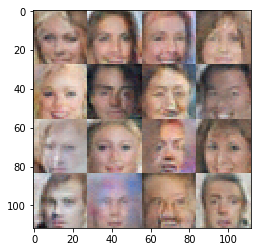

Epoch 2/2... Discriminator Loss: 0.4984... Generator Loss: 1.1580


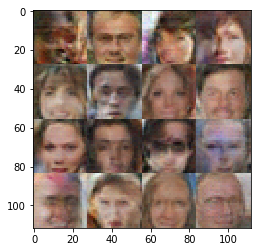

Epoch 2/2... Discriminator Loss: 1.2000... Generator Loss: 0.5388


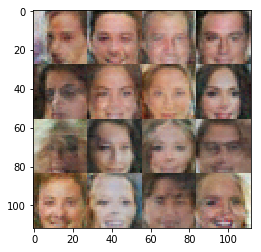

Epoch 2/2... Discriminator Loss: 0.7743... Generator Loss: 1.3579


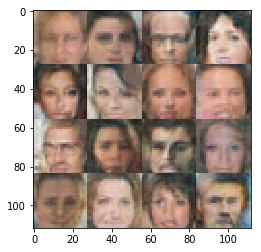

Epoch 2/2... Discriminator Loss: 0.6528... Generator Loss: 1.7023


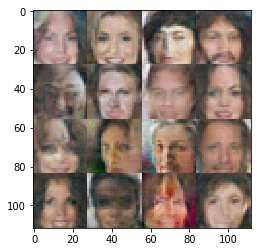

Epoch 2/2... Discriminator Loss: 0.8559... Generator Loss: 0.7911


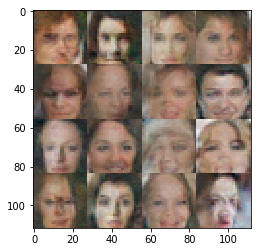

Epoch 2/2... Discriminator Loss: 0.7752... Generator Loss: 0.9169


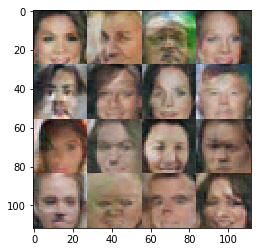

Epoch 2/2... Discriminator Loss: 0.8720... Generator Loss: 1.4733


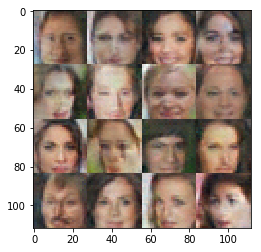

Epoch 2/2... Discriminator Loss: 2.1422... Generator Loss: 0.1730


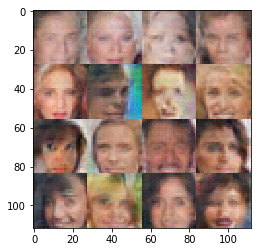

Epoch 2/2... Discriminator Loss: 0.2431... Generator Loss: 2.1281


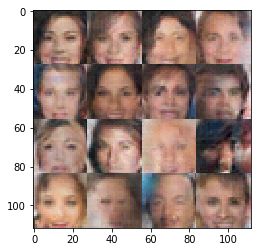

Epoch 2/2... Discriminator Loss: 1.6625... Generator Loss: 0.3297


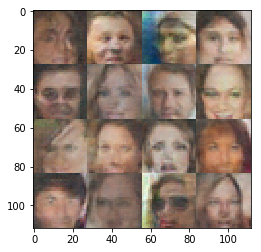

Epoch 2/2... Discriminator Loss: 0.6469... Generator Loss: 1.4123


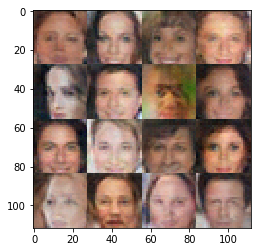

Epoch 2/2... Discriminator Loss: 0.7123... Generator Loss: 0.8807


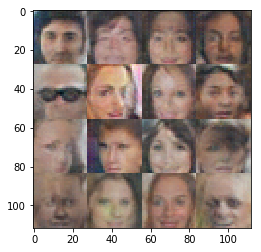

Epoch 2/2... Discriminator Loss: 2.2787... Generator Loss: 0.1339


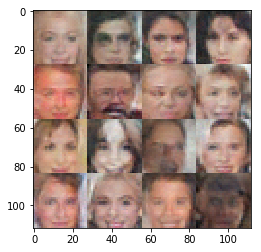

Epoch 2/2... Discriminator Loss: 1.7788... Generator Loss: 0.2481


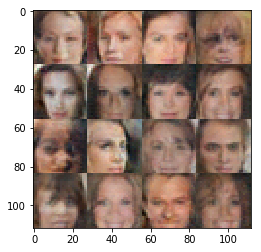

Epoch 2/2... Discriminator Loss: 1.6575... Generator Loss: 0.2753


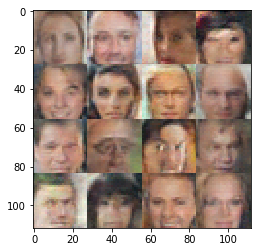

Epoch 2/2... Discriminator Loss: 1.2959... Generator Loss: 0.4547


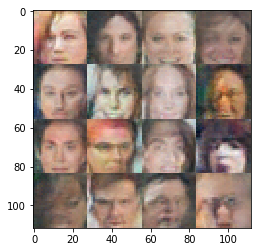

Epoch 2/2... Discriminator Loss: 0.3845... Generator Loss: 1.4514


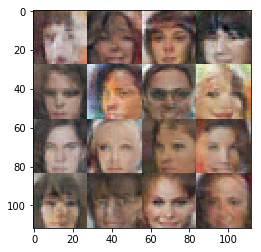

Epoch 2/2... Discriminator Loss: 0.6118... Generator Loss: 1.8383


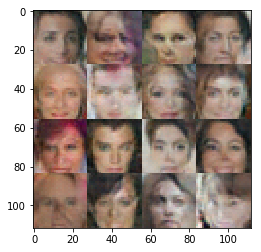

Epoch 2/2... Discriminator Loss: 0.8994... Generator Loss: 0.9859


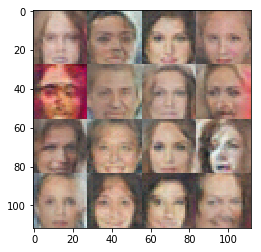

Epoch 2/2... Discriminator Loss: 1.0677... Generator Loss: 0.6173


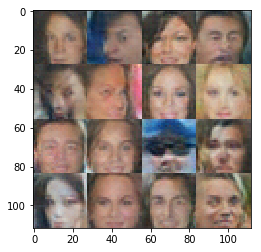

Epoch 2/2... Discriminator Loss: 0.4504... Generator Loss: 1.2863


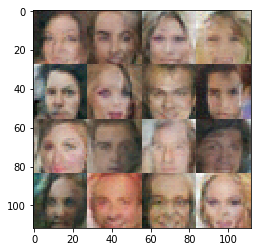

Epoch 2/2... Discriminator Loss: 2.6080... Generator Loss: 0.1092


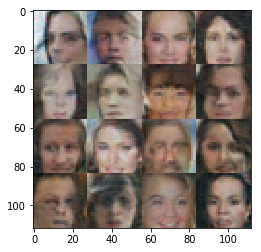

Epoch 2/2... Discriminator Loss: 1.0077... Generator Loss: 0.5732


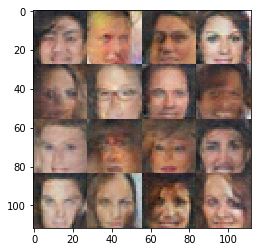

Epoch 2/2... Discriminator Loss: 0.3381... Generator Loss: 1.6613


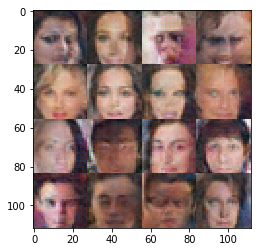

Epoch 2/2... Discriminator Loss: 0.3164... Generator Loss: 1.5524


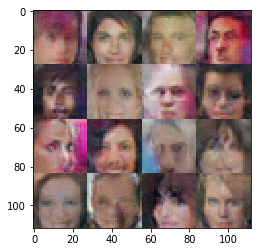

Epoch 2/2... Discriminator Loss: 1.4670... Generator Loss: 1.8885


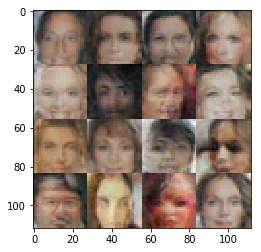

Epoch 2/2... Discriminator Loss: 0.8112... Generator Loss: 0.9562


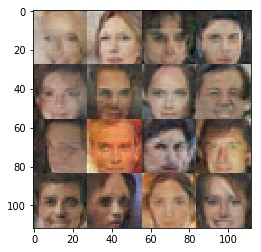

Epoch 2/2... Discriminator Loss: 1.7491... Generator Loss: 0.2649


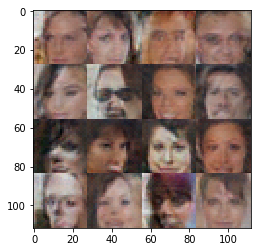

Epoch 2/2... Discriminator Loss: 0.8635... Generator Loss: 0.9226


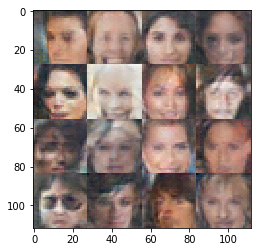

Epoch 2/2... Discriminator Loss: 0.7018... Generator Loss: 1.0634


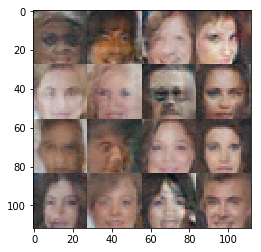

Epoch 2/2... Discriminator Loss: 1.2503... Generator Loss: 3.5388


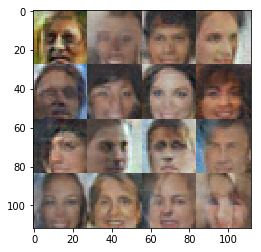

Epoch 2/2... Discriminator Loss: 1.2467... Generator Loss: 0.4363


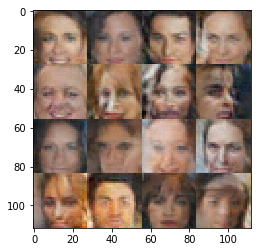

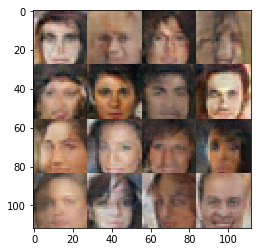

In [23]:
batch_size = 64
z_dim = 100
learning_rate = 0.001
beta1 = 0.3


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 2

celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, celeba_dataset.get_batches,
          celeba_dataset.shape, celeba_dataset.image_mode)

### Submitting This Project
When submitting this project, make sure to run all the cells before saving the notebook. Save the notebook file as "dlnd_face_generation.ipynb" and save it as a HTML file under "File" -> "Download as". Include the "helper.py" and "problem_unittests.py" files in your submission.